1. **Görüntü Normalizasyonu**:
   - Piksel değerleri 0-255 aralığından normalize edilip tekrar orijinal aralığına döndürülüyor.

2. **Ortalama Filtreleme**:
   - Gürültüyü azaltmak için filtre uygulanıyor.

3. **Parlaklık Artırma**:
   - Görüntü parlaklığı artırılarak detaylar daha belirgin hale getiriliyor.

4. **Etiketli Bölge Maskelenmesi**:
   - Etiketlerle belirlenmiş alanlar işleniyor.




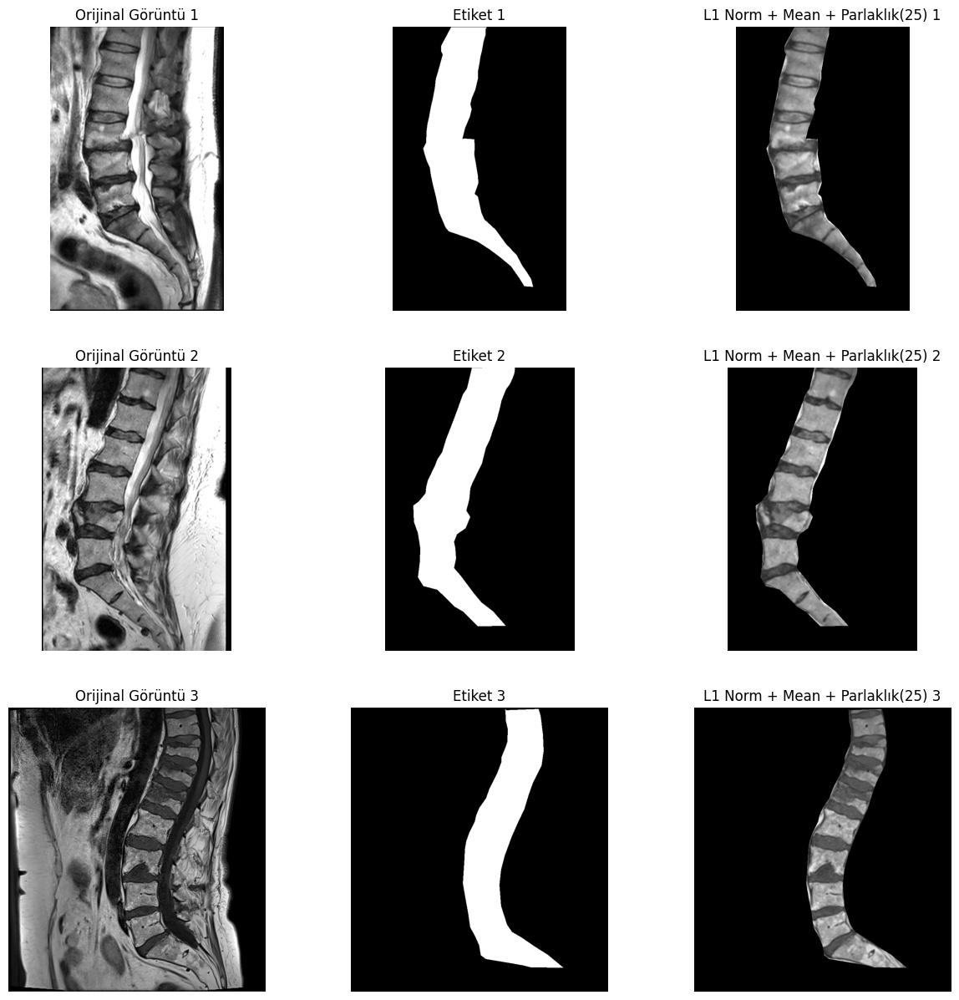

masked_image Boyutları: (856, 523)
masked_image2 Boyutları: (856, 572)
masked_image3 Boyutları: (855, 774)


In [29]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Görüntü ve etiket dosyalarının yolları
image_paths = [
    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png"
]

label_paths = [
    r"./DB/labels/label (1).png",
    r"./DB/labels/label (2).png",
    r"./DB/labels/label (3).png"
]

# Adım 1: L1 Norm Normalizasyonu
def normalize_image(image):
    normalized_image = image / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    return (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir

# Adım 2: Mean (Ortalama) Filtreleme
def mean_filter(image, kernel_size=5):
    return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

# Adım 3: Parlaklık Artırma
def increase_brightness(image, brightness_increase=25):
    return cv2.add(image, np.full_like(image, brightness_increase))

# Etiketli bölgeyi çıkarma işlemi
def process_image(image_path, label_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    label_image = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)  # Etiket (tek kanallı)

    # Adım 1: Normalizasyon
    normalized_image = normalize_image(image)

    # Adım 2: Ortalama Filtreleme
    mean_filtered = mean_filter(normalized_image, kernel_size=5)

    # Adım 3: Parlaklık Artırma
    brightened_image = increase_brightness(mean_filtered, brightness_increase=25)

    # Etiketli bölgeyi çıkarma (Aşındırma işlemi yok)
    masked_image = cv2.bitwise_and(brightened_image, brightened_image, mask=label_image)

    return image, label_image, masked_image

# Görselleri işleme
processed_images = [process_image(image_paths[i], label_paths[i]) for i in range(3)]

# İşlenmiş görüntüleri adlandırma
masked_image, masked_image2, masked_image3 = [masked for _, _, masked in processed_images]

# Sonuçları görselleştirme
plt.figure(figsize=(15, 15))

for i, (original, label, masked) in enumerate(processed_images):
    plt.subplot(3, 3, i*3+1)
    plt.title(f"Orijinal Görüntü {i+1}")
    plt.imshow(original, cmap="gray")
    plt.axis("off")

    plt.subplot(3, 3, i*3+2)
    plt.title(f"Etiket {i+1}")
    plt.imshow(label, cmap="gray")
    plt.axis("off")

    plt.subplot(3, 3, i*3+3)
    plt.title(f"L1 Norm + Mean + Parlaklık(25) {i+1}")
    plt.imshow(masked, cmap="gray")
    plt.axis("off")

plt.show()

# İşlenmiş görüntü boyutları
print(f"masked_image Boyutları: {masked_image.shape}")
print(f"masked_image2 Boyutları: {masked_image2.shape}")
print(f"masked_image3 Boyutları: {masked_image3.shape}")


1. **Görüntü ve Etiket Dosyalarının Alınması**:
   - İlk 3 görüntü ve etiket dosyası belirleniyor.

2. **LBP (Local Binary Pattern) Uygulaması**:
   - Siyah olmayan alanlara yönelik uygulanıyor.
   - **Parametreler**:
     - Yarıçap: 1
     - Nokta Sayısı: 8
     - Eşik Değeri: 10

3. **Görsellerin İşlenmesi**:
   - Görüntülere LBP uygulanıyor.
   - İşlenmiş maskeler ve LBP çıktıları kaydediliyor.

4. **Sonuçların Görselleştirilmesi**:
   - Her görüntü için 4 farklı görsel gösteriliyor:
     - Orijinal Görüntü
     - Etiket
     - L1 Norm, Ortalama Filtre ve Parlaklık Artırımı Sonucu
     - Siyah Olmayan Alanlarda LBP Sonucu

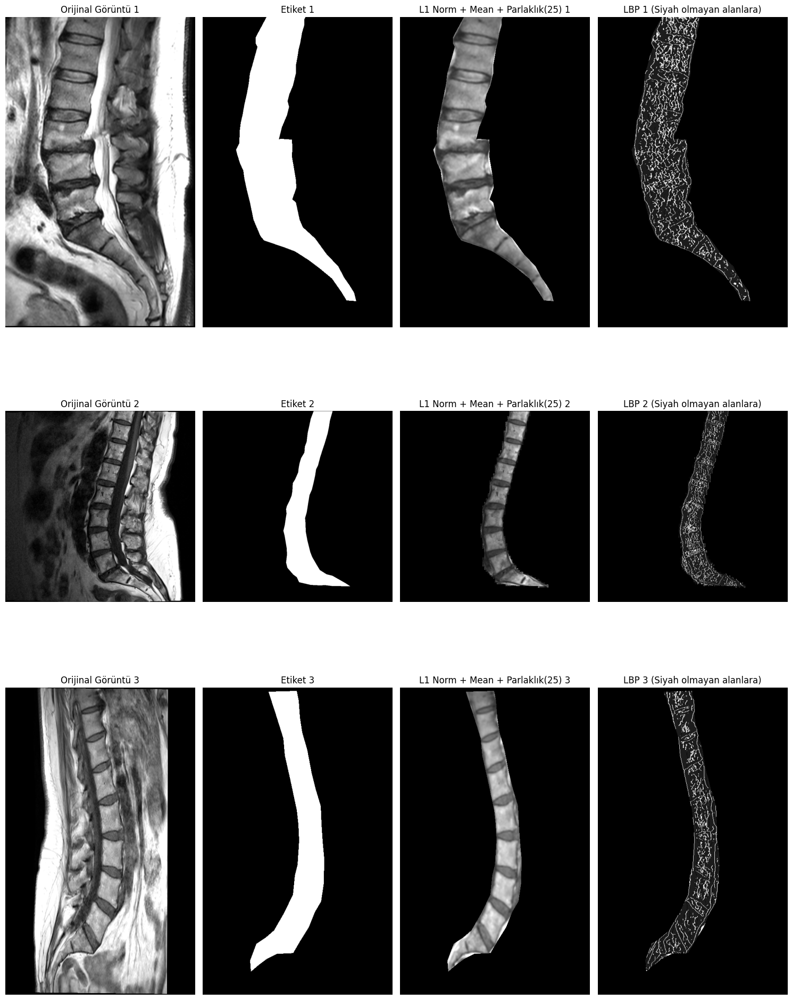

In [30]:
import cv2
import numpy as np
import os
from skimage.feature import local_binary_pattern
from matplotlib import pyplot as plt

# İlk 3 görüntü ve etiket dosyasını al
image_paths = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith(".png")])[:3]
label_paths = sorted([os.path.join(label_dir, f) for f in os.listdir(label_dir) if f.endswith(".png")])[:3]

# LBP işlemi (yalnızca siyah olmayan kısımlara uygulama)
def apply_lbp_to_nonblack(image, radius=1, n_points=8, threshold=10):
    if len(image.shape) != 2:
        raise ValueError("Giriş görüntüsü 2D olmalıdır!")
    
    non_black_mask = image > threshold
    lbp_image = np.zeros_like(image, dtype=np.float32)
    
    if np.any(non_black_mask):
        lbp_image[non_black_mask] = local_binary_pattern(
            image[non_black_mask].reshape(-1, 1),
            n_points,
            radius,
            method="uniform"
        ).ravel()
    
    return lbp_image

# Görselleri işleme ve LBP'yi uygulama
processed_images = [process_image(image_paths[i], label_paths[i]) for i in range(3)]
lbp_images = [apply_lbp_to_nonblack(masked, radius=1, n_points=8, threshold=10) for _, _, masked in processed_images]

# LBP sonuçlarını görselleştirme
plt.figure(figsize=(15, 20))

for i, (original, label, masked, lbp) in enumerate(zip(
    [img for img, _, _ in processed_images],
    [lbl for _, lbl, _ in processed_images],
    [msk for _, _, msk in processed_images],
    lbp_images
)):
    plt.subplot(3, 4, i*4+1)
    plt.title(f"Orijinal Görüntü {i+1}")
    plt.imshow(original, cmap="gray")
    plt.axis("off")
    
    plt.subplot(3, 4, i*4+2)
    plt.title(f"Etiket {i+1}")
    plt.imshow(label, cmap="gray")
    plt.axis("off")
    
    plt.subplot(3, 4, i*4+3)
    plt.title(f"L1 Norm + Mean + Parlaklık(25) {i+1}")
    plt.imshow(masked, cmap="gray")
    plt.axis("off")
    
    plt.subplot(3, 4, i*4+4)
    plt.title(f"LBP {i+1} (Siyah olmayan alanlara)")
    plt.imshow(lbp, cmap="gray")
    plt.axis("off")

plt.tight_layout()
plt.show()

# LBP sonuçlarını değişkenlerde tutabilirsiniz
lbp_image1, lbp_image2, lbp_image3 = lbp_images


### Drawing Fonksiyonu

Bu fonksiyon, bir görüntü üzerinde çeşitli görsel işaretlemeler yapar ve işlenmiş görüntüyü matplotlib ile görselleştirir.

1. **Gri Tonlamalı Görüntünün BGR Formatına Dönüşümü**:
   - Görüntü BGR formatına dönüştürülerek işaretlemeler yapılır.

2. **Noktaların İşaretlenmesi (EdgePoints)**:
   - Sağlanan noktalar (y, x) koordinatlarında kırmızı dairelerle işaretlenir.
   - Dairenin yarıçapı ayarlanabilir (varsayılan: 10).

3. **Çizgilerin İşaretlenmesi (EdgeLines)**:
   - Sağlanan başlangıç ve bitiş noktalarına göre sarı çizgiler çizilir.

4. **Dikdörtgen Patch'lerin İşaretlenmesi (EdgePatchs)**:
   - Sağlanan koordinatlara ve boyutlara göre kırmızı dikdörtgenler çizilir.
   - Her dikdörtgen numaralandırılır (mavi renkle).

5. **Görselleştirme**:
   - İşlenmiş görüntü, boyutlarına uygun bir şekilde matplotlib ile gösterilir.
   - Görsel için opsiyonel başlık eklenebilir.


In [32]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius=10):
    """
    Görüntü üzerinde kenar noktalarını, çizgileri ve patch'leri çizmek için bir fonksiyon.
    
    Parametreler:
        - img: Gri tonlamalı giriş görüntüsü.
        - EdgePoints: İşaretlenecek noktaların (y, x) formatında bir listesi.
        - EdgeLines: Çizilecek çizgilerin başlangıç ve bitiş noktalarının bir listesi.
        - EdgePatchs: İşaretlenecek patch'lerin (x, y, PatchSize) formatında bir listesi.
        - title: Görüntüye eklenecek başlık (opsiyonel).
        - circle_radius: Noktaları işaretlemek için kullanılan dairenin yarıçapı (varsayılan: 10).
    """
    # Gri tonlamalı görüntüyü BGR formatına dönüştür
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
    
    # Eğer EdgePoints parametresi verilmişse, noktaları işaretle
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # OpenCV koordinat düzenine uyacak şekilde ters çevir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire
    
    # Eğer EdgeLines parametresi verilmişse, çizgileri işaretle
    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = tuple(map(int, Line["StartPointYX"][::-1]))  # Başlangıç noktasını (x, y) formatına çevir
            stop_point = tuple(map(int, Line["StopPointYX"][::-1]))  # Bitiş noktasını (x, y) formatına çevir
            cv2.line(output_img, start_point, stop_point, color=(255, 255, 0), thickness=2)  # Sarı çizgi

    # Eğer EdgePatchs parametresi verilmişse, patch'leri işaretle
    if EdgePatchs is not None: 
        font = cv2.FONT_HERSHEY_SIMPLEX  # Yazı fontu
        font_scale = 1  # Yazı boyutu
        color = (255, 0, 0)  # Yazı rengi (mavi)
        thickness = 2  # Yazı kalınlığı
        for k, (x, y, PatchSize) in enumerate(EdgePatchs):  # (x, y, PatchSize) parametreleri bekleniyor
            top_left = (x - PatchSize, y - PatchSize)  # Sol üst köşe
            bottom_right = (x + PatchSize, y + PatchSize)  # Sağ alt köşe
            cv2.rectangle(output_img, top_left, bottom_right, (0, 0, 255), 2)  # Kırmızı dikdörtgen
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)  # Numaralandırma

    # Görüntü boyutlarına göre uygun bir figsize hesapla
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Görüntü oranına uygun şekilde figür boyutunu ayarla

    # matplotlib ile görseli çiz
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))  # BGR -> RGB dönüşümü
    if title is not None:  # Eğer başlık verilmişse
        plt.title(title, fontsize=30)  # Başlığı ekle
    plt.axis('off')  # Eksenleri gizle
    plt.show()  # Görseli göster



### GetNonBlackPixels Fonksiyonu
Gri tonlamalı bir görüntüde siyah olmayan pikselleri tespit eder ve opsiyonel olarak bu noktaları görselleştirir.

1. **Siyah Olmayan Piksel Koordinatlarını Tespit Etme**:
   - Siyah olmayan piksellerin `(y, x)` koordinatları tespit edilir.

2. **Seyrekleştirme**:
   - Piksel koordinatları, belirli bir seyrekleştirme faktörüne göre azaltılır.
   - **Parametre**: `sparsity_factor` (varsayılan: 1, daha yüksek değerlerle noktalar seyrekleşir).

3. **Görselleştirme**:
   - Görüntü üzerinde tespit edilen pikseller opsiyonel olarak dairelerle işaretlenir.
   - **Parametre**: `draw` (varsayılan: False).

4. **Sonuç**:
   - Siyah olmayan piksellerin koordinatları bir NumPy dizisi olarak döndürülür

### Görsellerin İşlenmesi ve Gösterimi

1. **Masked Images**:
   - LBP uygulanmış üç görüntü (`lbp_image1`, `lbp_image2`, `lbp_image3`) üzerinde işlem yapılır.

2. **Noktaların İşaretlenmesi**:
   - Siyah olmayan pikseller belirlenir ve `circle_radius` kullanılarak işaretlenir.

3. **Görselleştirme**:
   - Her bir görüntü için:
     - Siyah olmayan noktalar işaretlenmiş görüntüler oluşturulur.
     - Görseller yan yana matplotlib ile gösterilir.

<Figure size 1500x500 with 0 Axes>

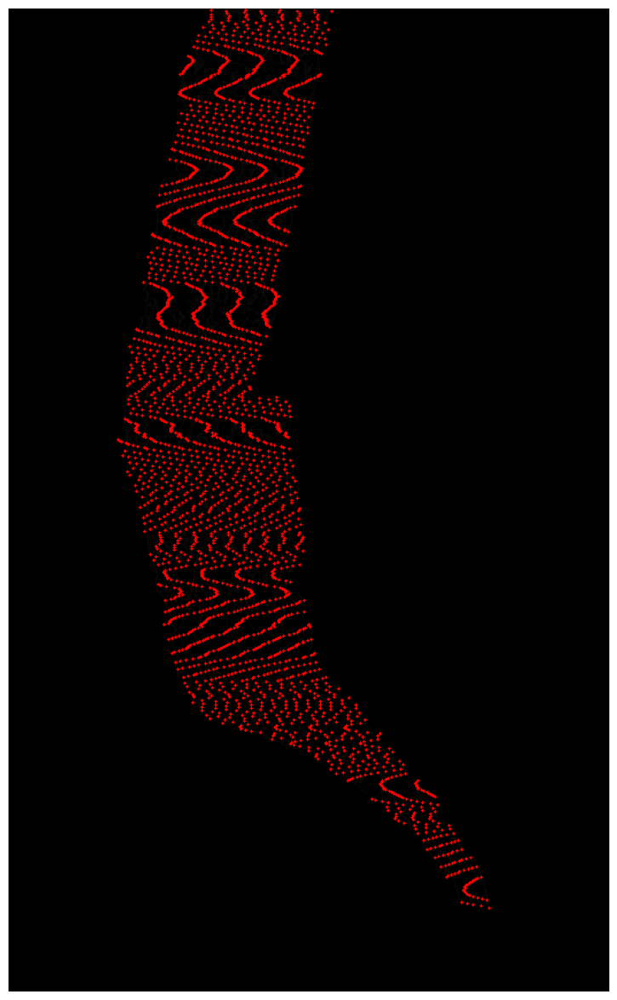

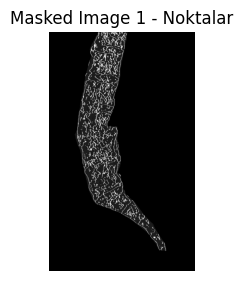

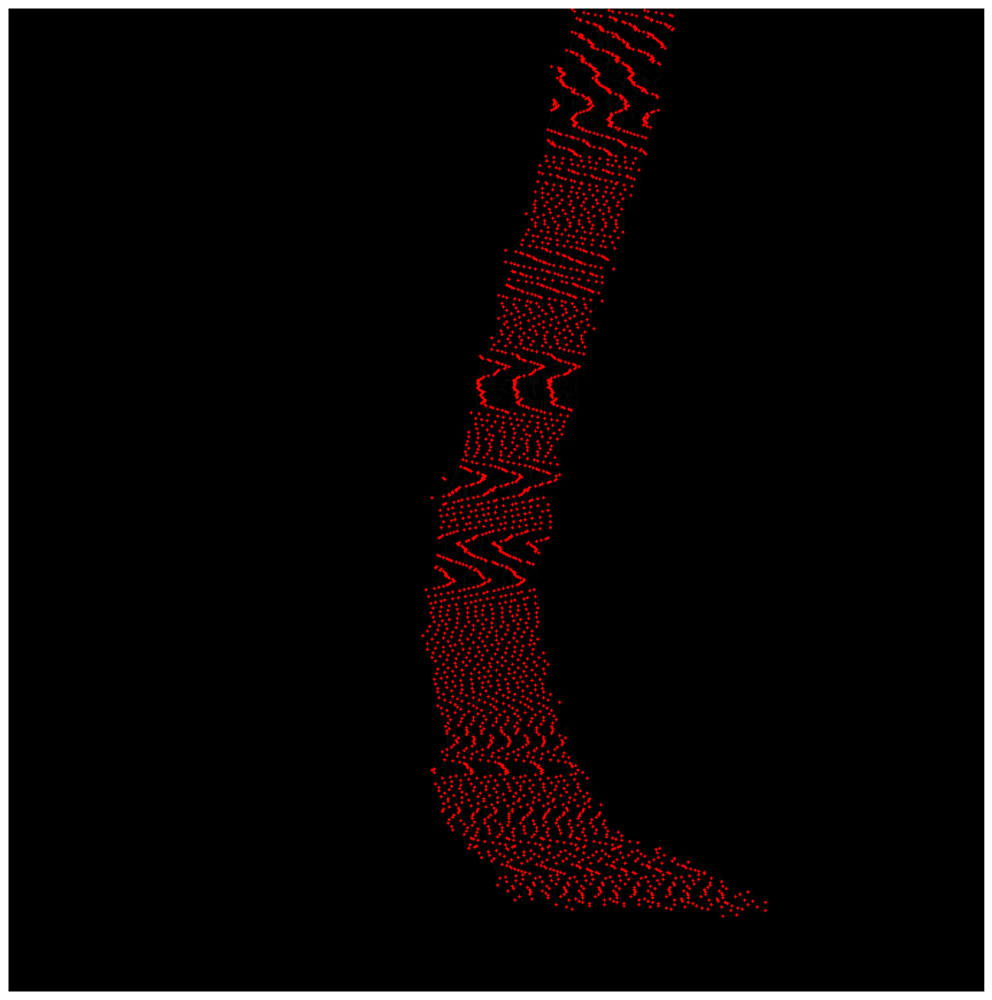

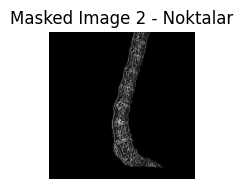

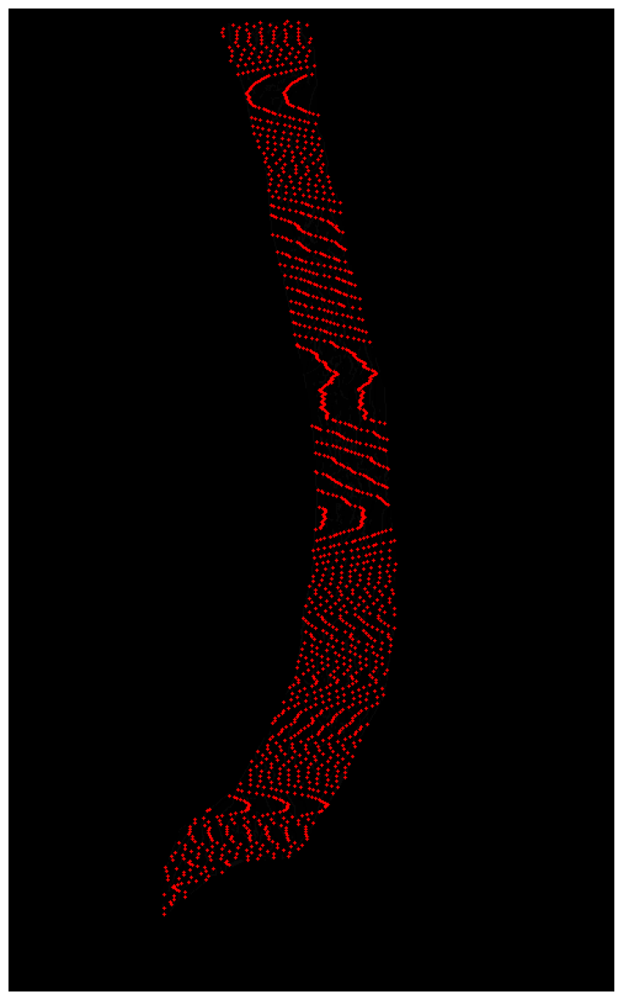

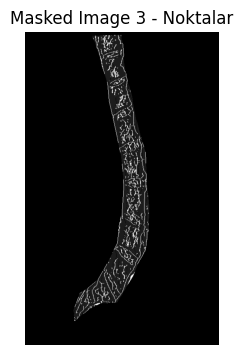

In [33]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    """
    Gri tonlamalı bir görüntüde siyah olmayan pikselleri tespit eder.
    Opsiyonel olarak bu noktaları görselleştirir.

    Parametreler:
        img: Gri tonlamalı giriş görüntüsü.
        sparsity_factor: Seyrekleştirme için kullanılan faktör (varsayılan: 1).
        draw: Siyah olmayan noktaların görüntü üzerinde çizilmesini sağlar (varsayılan: False).
        circle_radius: Çizilecek noktaların yarıçapı (varsayılan: 10).
    """
    # Siyah olmayan piksellerin koordinatlarını al
    y, x = np.where(img > 0)  # Siyah olmayan piksellerin (y, x) koordinatlarını bul
    pixels = np.vstack((y, x)).T  # Koordinatları birleştir (y, x)

    # Seyrekleştirme işlemi
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]  # Belirli bir adımda noktaları alarak seyrekleştirme yap

    # Görselleştirme seçeneği
    if draw:
        img_uint8 = (img * 255).astype(np.uint8) if img.max() <= 1 else img.astype(np.uint8)
        Drawing(img_uint8, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# Görselleri ve isimleri listele
masked_images = [lbp_image1, lbp_image2, lbp_image3]  # LBP işlemi yapılmış üç görüntü
image_titles = ["Masked Image 1", "Masked Image 2", "Masked Image 3"]  # Görsellerin başlıkları

# Noktaları çizilmiş görselleri hazırlamak için kopyalar oluştur
point_masked_images = [img.copy() for img in masked_images]  # Her LBP görüntüsünün bir kopyasını alın

# Görsellerin görselleştirilmesi için matplotlib hazırlığı
plt.figure(figsize=(15, 5))  # Yan yana 3 görsel göstermek için uygun figür boyutu

# Her bir görüntü için siyah olmayan pikselleri al ve noktaları işaretle
for i, lbp_image in enumerate(masked_images):
    img_Points = GetNonBlackPixels(point_masked_images[i], sparsity_factor=30, circle_radius=1, draw=True)

    # Her bir görseli matplotlib ile görselleştir
    plt.subplot(1, 3, i + 1)  # 1 satır ve 3 sütun düzenleme
    plt.imshow(point_masked_images[i], cmap='gray')  # Gri tonlamalı görsel
    plt.title(f"{image_titles[i]} - Noktalar")  # Görsel başlığı
    plt.axis('off')  # Eksenleri gizle

# Görselleri sıkışmadan düzenle ve göster
plt.tight_layout()
plt.show()



#### 1. **`Drawing` Fonksiyonu**
- Görüntü üzerine işaretlemeler yapar:
  - **Noktalar (EdgePoints)**: Kırmızı dairelerle işaretlenir.
  - **Çizgiler (EdgeLines)**: Sarı çizgiler çizilir.
  - **Yamalar (EdgePatchs)**: Kırmızı dikdörtgenlerle çevrelenir ve numaralandırılır.
- İşaretlenmiş görüntü matplotlib ile görselleştirilir.

#### 2. **`GetNonBlackPixels` Fonksiyonu**
- Siyah olmayan piksel koordinatlarını tespit eder.
- **Seyrekleştirme (sparsity_factor)** ile noktalar azaltılabilir.
- Opsiyonel olarak bu noktaları görüntü üzerine çizer.

#### 3. **`GetPatchsFromNonBlackPixels` Fonksiyonu**
- Siyah olmayan piksel koordinatlarından belirtilen boyutta yamalar çıkarır.
- Yamaları çevreleyen kırmızı dikdörtgenlerle işaretler.

1. **Masked Images (LBP Görselleri)**:
   - Üç farklı LBP uygulanmış görüntü (`lbp_image1`, `lbp_image2`, `lbp_image3`) işlenir.

2. **Siyah Olmayan Piksellerin Belirlenmesi**:
   - Her görüntüde siyah olmayan piksel koordinatları bulunur.
   - Seyrekleştirme (`sparsity_factor=30`) uygulanır.
   - Noktalar görüntü üzerine işaretlenir.

3. **Yamaların Çıkarılması**:
   - Siyah olmayan piksellerden yamalar alınır.
   - Yamalar, belirlenen boyutta (`PatchSize=10`) çevrelenir.

4. **Yamalar ve Görsellerin Gösterimi**:
   - Her görüntüde ilk yama matplotlib ile görselleştirilir.
   - Görseller eksensiz olarak gösterilir.



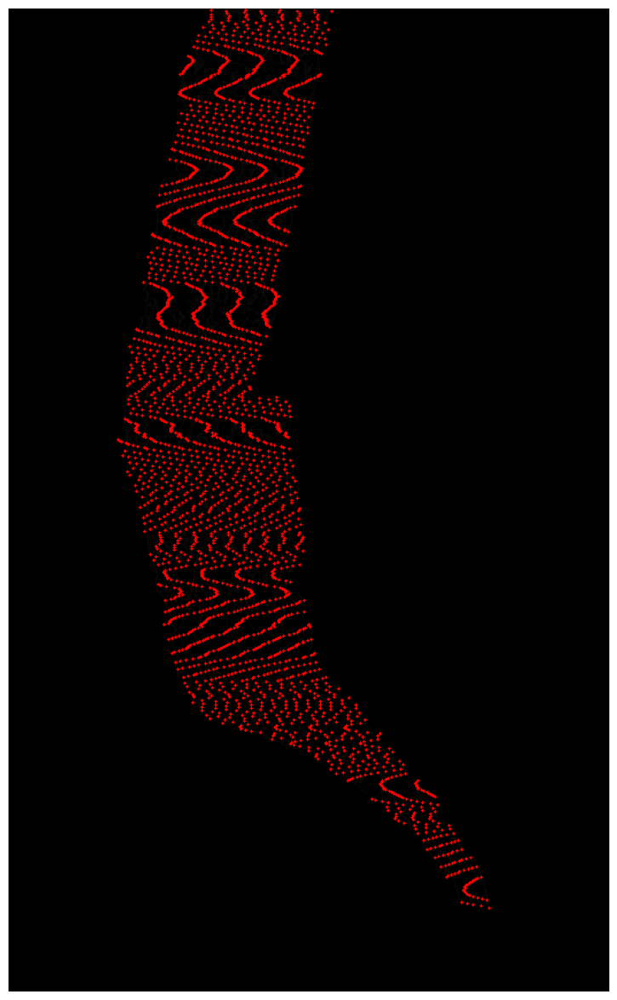

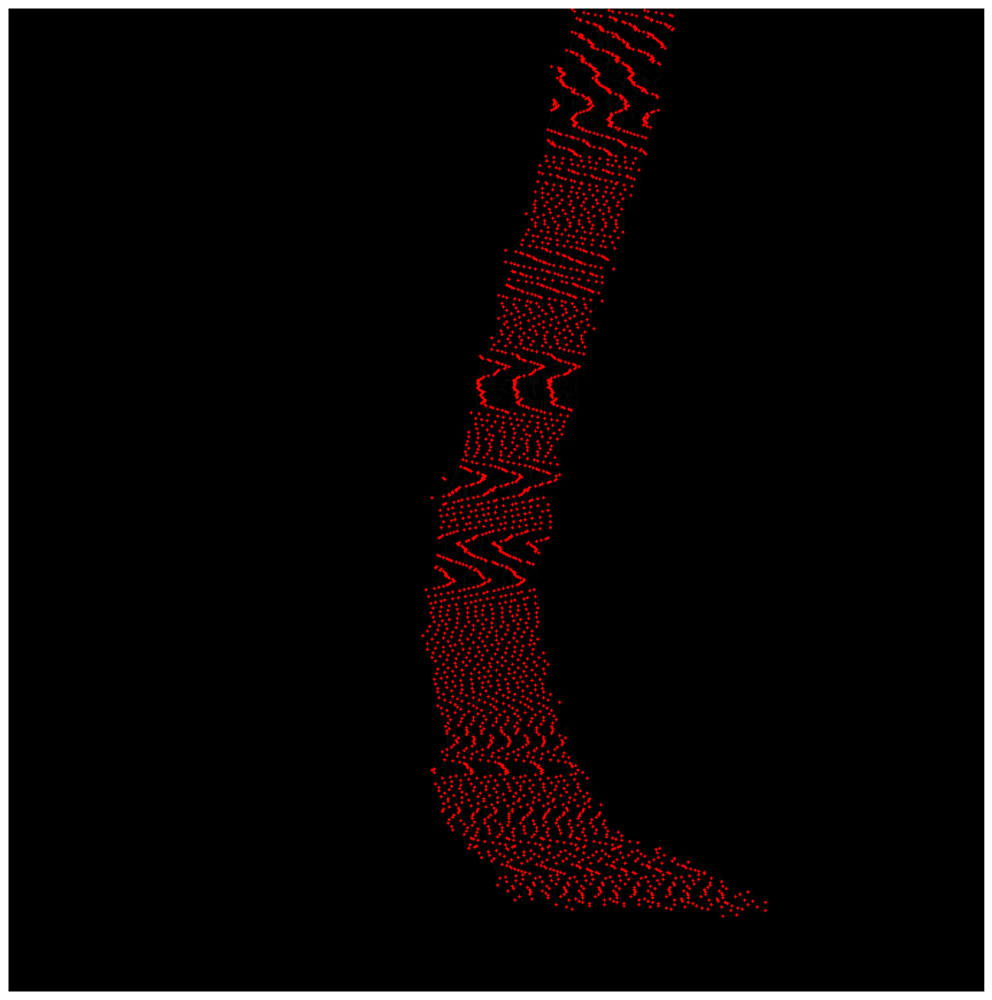

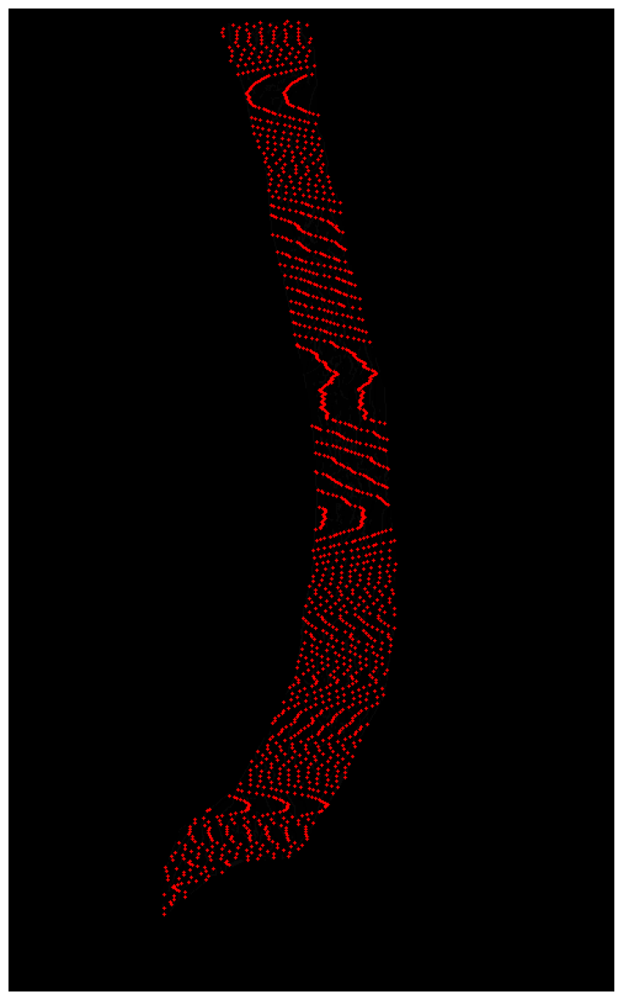

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


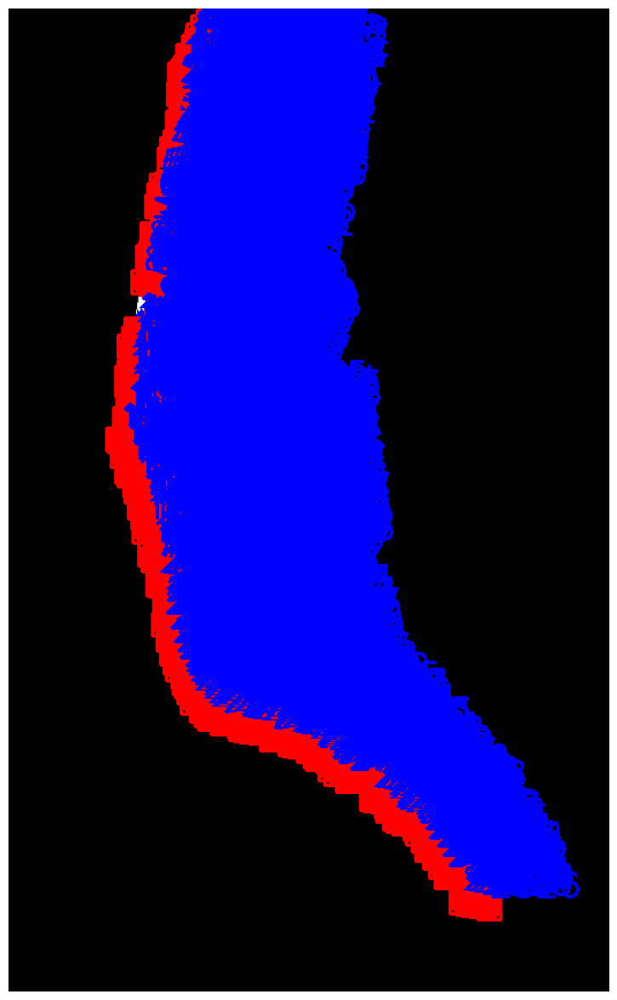

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


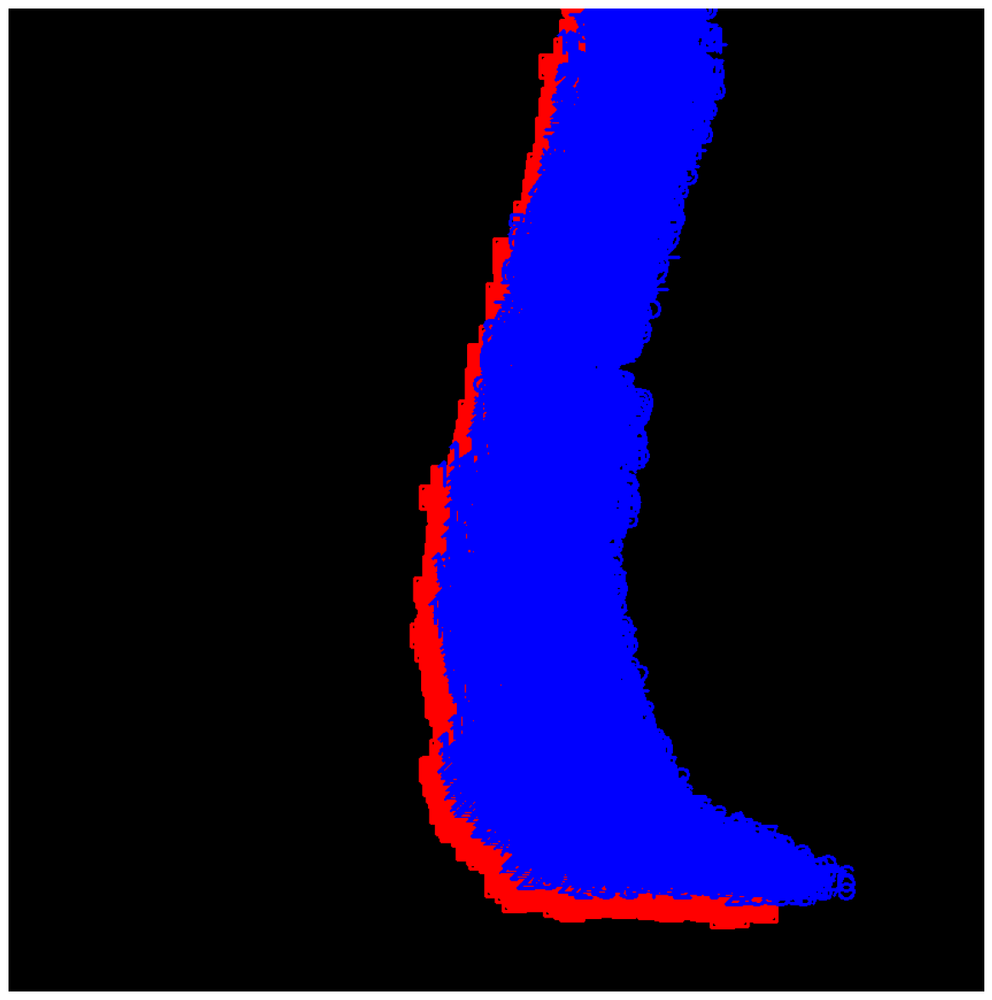

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


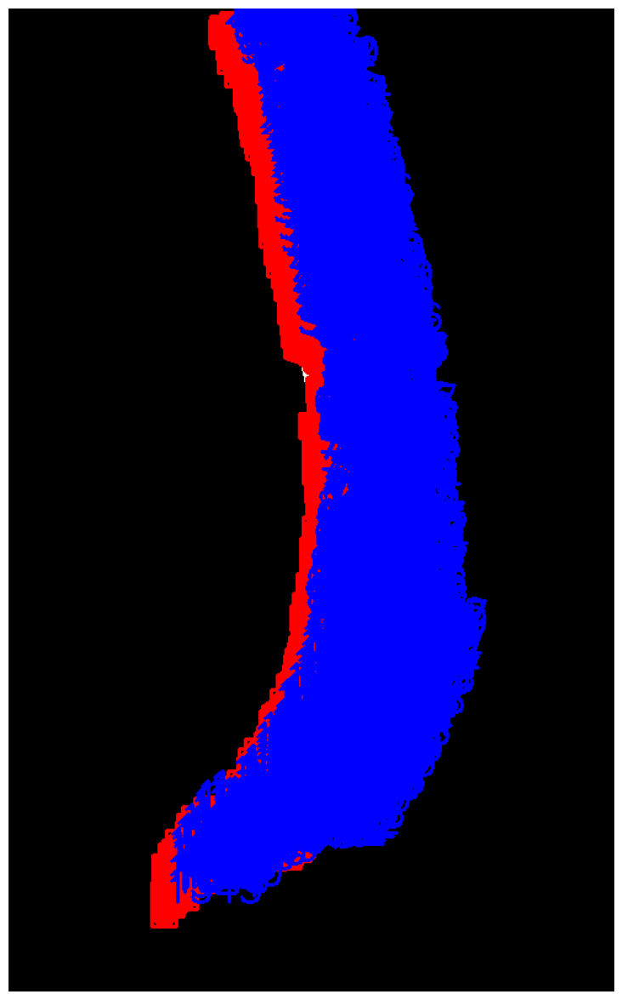

Image 1 Patch Sayısı: 2827
Image 2 Patch Sayısı: 2589
Image 3 Patch Sayısı: 1546


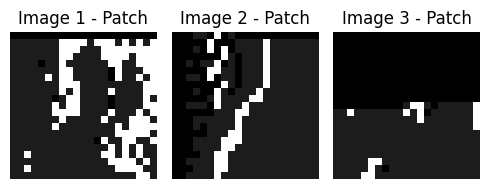

In [34]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius=10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    
    if EdgePoints is not None:
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)
    
    if EdgeLines is not None:
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color=(255, 255, 0), thickness=2)
    
    if EdgePatchs is not None:
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)
        thickness = 2
        for k, (x, y, PatchSize) in enumerate(EdgePatchs):
            top_left = (x - PatchSize, y - PatchSize)
            bottom_right = (x + PatchSize, y + PatchSize)
            cv2.rectangle(output_img, top_left, bottom_right, (0, 0, 255), 2)
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)
    
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)
    
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()

def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    y, x = np.where(img > 0)
    pixels = np.vstack((y, x)).T
    
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]
    
    if draw:
        img_uint8 = (img * 255).astype(np.uint8) if img.max() <= 1 else img.astype(np.uint8)
        Drawing(img_uint8, EdgePoints=pixels, circle_radius=circle_radius)
    
    return pixels

def GetPatchsFromNonBlackPixels(img, NonBlackPixels, PatchSize=11, draw=True):
    Patchs = []
    PatchsInfo = []
    rows, cols = img.shape

    for y, x in NonBlackPixels:
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1
        
        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            continue
        
        Patch = img[y_start:y_end, x_start:x_end]
        Patchs.append(Patch)
        PatchsInfo.append((x, y, PatchSize))
    
    if draw:
        Drawing(img, EdgePoints=NonBlackPixels, EdgePatchs=PatchsInfo)
    
    return Patchs, PatchsInfo

# Görselleri ve isimlerini listele
masked_images = [lbp_image1, lbp_image2, lbp_image3]
image_titles = ["Masked Image 1", "Masked Image 2", "Masked Image 3"]

# Noktalar işaretlenmiş görselleri tutacak yeni kopyalar oluştur
point_masked_images1 = lbp_image1.copy()
point_masked_images2 = lbp_image2.copy()
point_masked_images3 = lbp_image3.copy()

# Siyah olmayan pikselleri al ve yamaları çıkar
img_Points1 = GetNonBlackPixels(point_masked_images1, sparsity_factor=30, circle_radius=1, draw=True)
img_Points2 = GetNonBlackPixels(point_masked_images2, sparsity_factor=30, circle_radius=1, draw=True)
img_Points3 = GetNonBlackPixels(point_masked_images3, sparsity_factor=30, circle_radius=1, draw=True)

img_Patchs1, img_PatchsInfo1 = GetPatchsFromNonBlackPixels(point_masked_images1, img_Points1, PatchSize=10, draw=True)
img_Patchs2, img_PatchsInfo2 = GetPatchsFromNonBlackPixels(point_masked_images2, img_Points2, PatchSize=10, draw=True)
img_Patchs3, img_PatchsInfo3 = GetPatchsFromNonBlackPixels(point_masked_images3, img_Points3, PatchSize=10, draw=True)

print(f"Image 1 Patch Sayısı: {len(img_Patchs1)}")
print(f"Image 2 Patch Sayısı: {len(img_Patchs2)}")
print(f"Image 3 Patch Sayısı: {len(img_Patchs3)}")

plt.figure(figsize=(5, 2))
for i, (img_Patchs, img_PatchsInfo) in enumerate(zip([img_Patchs1, img_Patchs2, img_Patchs3], [img_PatchsInfo1, img_PatchsInfo2, img_PatchsInfo3])):
    patch = img_Patchs[0]
    if patch.dtype != np.uint8:
        patch = (patch - patch.min()) / (patch.max() - patch.min())
    
    plt.subplot(1, 3, i + 1)
    plt.imshow(patch, cmap='gray')
    plt.title(f"Image {i + 1} - Patch")
    plt.axis('off')

plt.tight_layout()
plt.show()


### `DisplayPatches` Fonksiyonu
Bu fonksiyon, görüntülerden çıkarılan yamaları (patch'leri) grid yapısında görselleştirir.

### İşlevler ve Parametreler

1. **Görselleştirme Ayarları**:
   - **`max_cols`**: Griddeki maksimum sütun sayısı. Varsayılan: 10.
   - **`max_patches`**: Görselleştirilecek maksimum patch sayısı. Varsayılan: 100.

2. **Grid Yapısının Oluşturulması**:
   - Yamaların toplam sayısına göre sütun ve satır sayısı hesaplanır.
   - Yamalar grid düzeninde eksensiz olarak görselleştirilir.

3. **Yamaların Gösterimi**:
   - Her yama gri tonlamalı (`cmap='gray'`) olarak gösterilir.
   - Her yamaya bir numara eklenir (`ax.text` ile).

4. **Fazla Eksenlerin Gizlenmesi**:
   - Yamalar grid alanını doldurmadığında boş eksenler gizlenir.

5. **Görselin Düzenlenmesi**:
   - Yamalar arasında boşluk kalmaması için `plt.tight_layout` uygulanır.
   - Görsel `plt.show()` ile gösterilir.


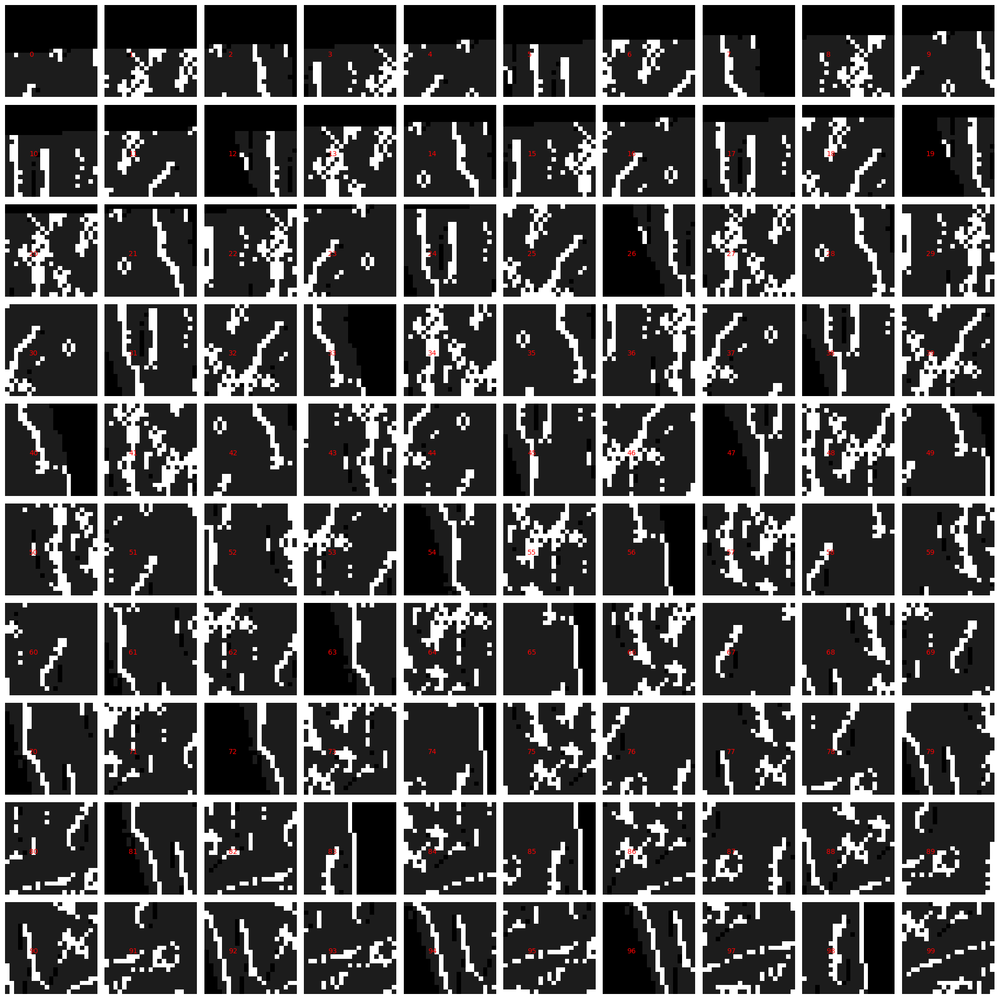

In [35]:
import math
import matplotlib.pyplot as plt
import numpy as np

def DisplayPatches(EdgePatchs, max_cols=10, max_patches=100):
    """
    Patch'leri grid şeklinde görselleştirir.

    Args:
        EdgePatchs (list): Patch görüntülerinin listesi.
        max_cols (int): Maksimum sütun sayısı.
        max_patches (int): Maksimum gösterilecek patch sayısı.

    Returns:
        None
    """
    # Toplam patch sayısı
    num_patches = min(len(EdgePatchs), max_patches)  # En fazla max_patches kadar göster
    
    # Sütun sayısı (max_cols ile sınırlı)
    cols = min(max_cols, num_patches)
    
    # Satır sayısını hesapla
    rows = math.ceil(num_patches / cols)
    
    # Şekil oluşturma
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    
    # Eğer yalnızca bir satır varsa, axes tek boyutlu olur, aksi takdirde çok boyutlu olur.
    axes = np.array(axes).reshape(-1)  
    
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(EdgePatchs[i], cmap='gray')  # Yama görselleştir
            ax.text(5, 10, str(i), color='red', fontsize=10, ha='left', va='top')  # Patch numaralandırma
            ax.axis('off')  # Eksenleri gizle
        else:
            ax.axis('off')  # Fazla eksenleri gizle
    
    plt.tight_layout()  # Görsellerin düzenini sıkıştırarak daha düzenli hale getir
    plt.show()  # Görselleştirme göster

# Patch'leri görselleştirmek için örnek kullanım
DisplayPatches(img_Patchs, max_cols=10, max_patches=100)




#### 1. **`compute_hog_features` Fonksiyonu**
- Bir görüntü üzerinde **HOG (Histogram of Oriented Gradients)** özelliklerini hesaplar.
- **Parametreler**:
  - `cell_size`: HOG için hücre boyutu. Varsayılan: `(8, 8)`.
  - `block_size`: HOG için blok boyutu. Varsayılan: `(2, 2)`.
  - `nbins`: Yönelime göre histogram bin sayısı. Varsayılan: `9`.
- **Çıktı**:
  - Görüntünün HOG özelliklerinden oluşan bir düz dizi.

#### 2. **`save_hog_features_with_coords` Fonksiyonu**
- Görsellerden alınan yamaların HOG özelliklerini ve yamaların koordinatlarını bir dosyaya kaydeder.
- **Parametreler**:
  - `patches`: Görsellerden alınan yamalar.
  - `patch_info`: Yamaların koordinat bilgileri.
  - `output_path`: Kaydedilecek dosya yolu.
- **Çıktı**:
  - Özellikler ve koordinatlar `.npz` formatında dosyaya kaydedilir.

### İşlem Adımları

1. **Patch'lerin Alınması**:
   - Görsellerden yamalar (`img_Patchs1`, `img_Patchs2`, `img_Patchs3`) ve yamaların koordinat bilgileri (`img_PatchsInfo1`, `img_PatchsInfo2`, `img_PatchsInfo3`) çıkarılır.

2. **Patch'lerin Birleştirilmesi**:
   - Tüm yamalar ve koordinat bilgileri tek bir listeye birleştirilir.

3. **HOG Özelliklerinin Hesaplanması ve Kaydedilmesi**:
   - Yamalar üzerinde HOG özellikleri hesaplanır.
   - Özellikler ve koordinatlar belirtilen dosya yoluna `.npz` formatında kaydedilir.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


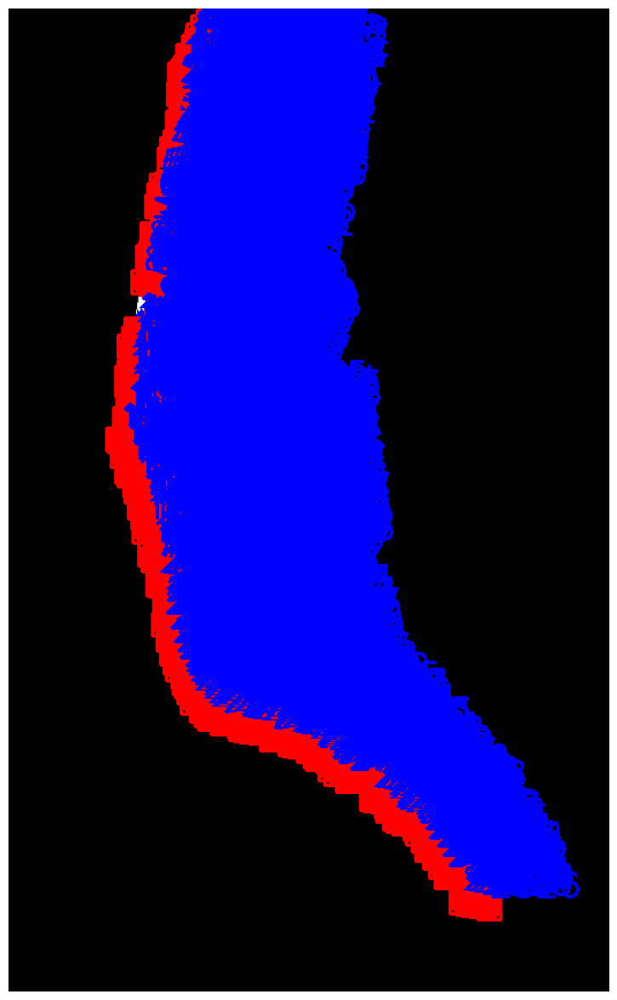

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


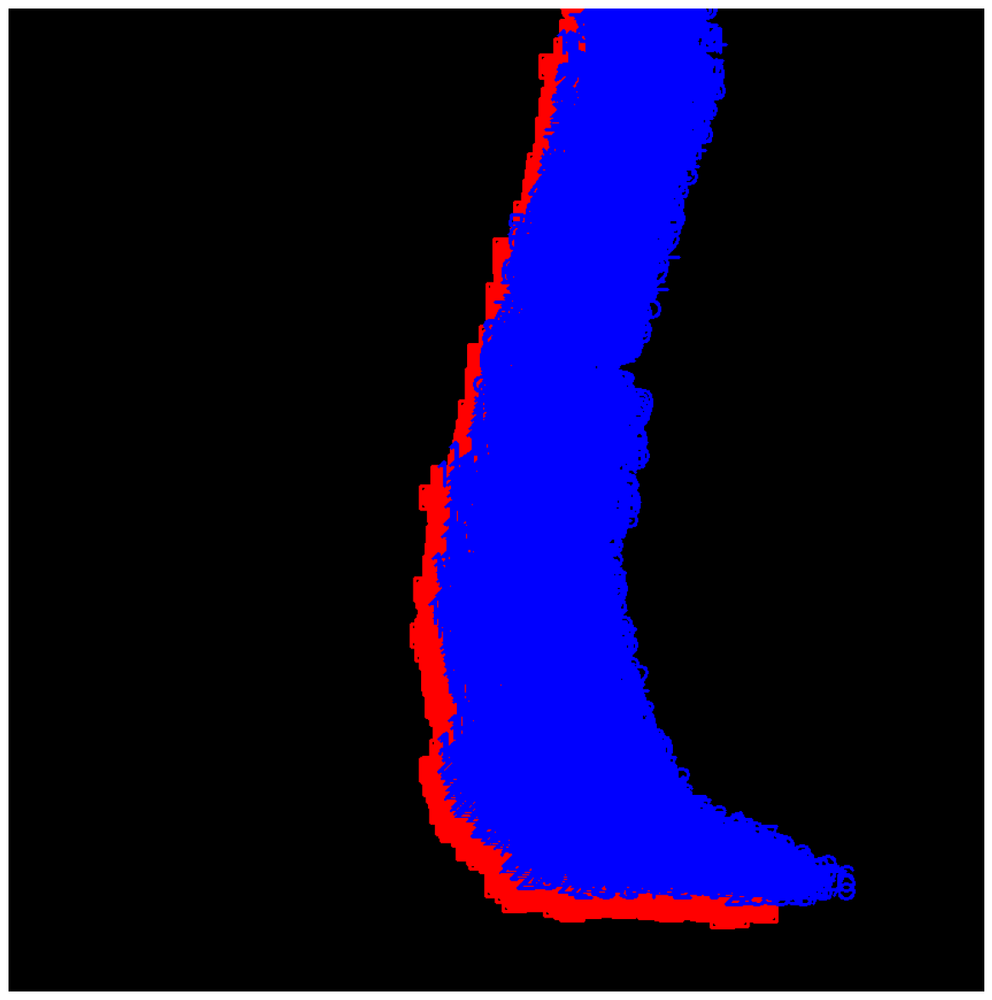

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


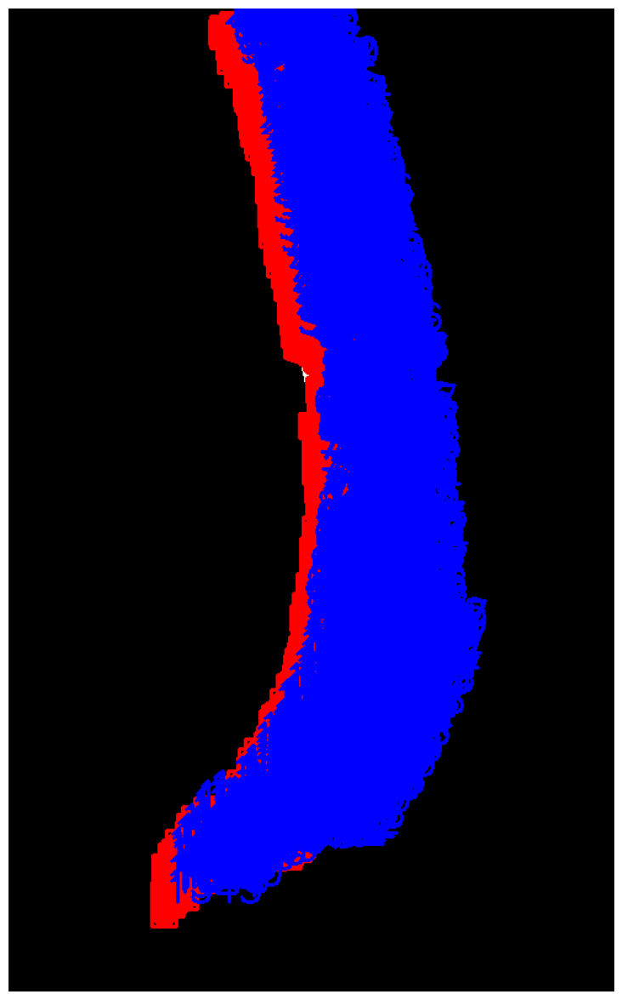

HOG özellikleri ve koordinatlar kaydedildi: ./DB/output\hog_features_with_coords.npz
Toplam 6962 patch HOG ile kodlandı.


In [36]:
import cv2
import numpy as np
import os

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    HOG özelliklerini hesaplar.

    Args:
        image (ndarray): Gri tonlamalı görüntü.
        cell_size (tuple): Hücre boyutu (default: (8, 8)).
        block_size (tuple): Blok boyutu (default: (2, 2)).
        nbins (int): HOG için bin sayısı (default: 9).

    Returns:
        ndarray: HOG özellikleri.
    """
    # Görüntüyü gri tonlamaya dönüştür ve normalize et
    if image.ndim == 3:  # RGB görüntü kontrolü
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    if image.dtype != np.uint8:  # Görüntü tipi 8-bit değilse normalize et
        image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # HOG özellik hesaplayıcı oluştur
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)  # HOG özelliklerini hesapla
    return features.flatten()


# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    HOG özelliklerini ve koordinatlarını dosyaya kaydeder.

    Args:
        patches (list): Patch görüntüleri.
        patch_info (list): Patch koordinatları.
        output_path (str): Çıktı dosya yolu.
        cell_size (tuple): Hücre boyutu.
        block_size (tuple): Blok boyutu.
        nbins (int): HOG için bin sayısı.

    Returns:
        None
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        # Her bir patch için HOG özelliklerini hesapla
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)  # Özellikleri listeye ekle
        all_coords.append(info)  # Koordinat bilgisini ekle

    # Özellikleri ve koordinatları numpy dizilerine dönüştür
    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    # Çıktı dizini oluştur (varsa atla)
    os.makedirs(os.path.dirname(output_path), exist_ok=True)

    # Özellikleri ve koordinatları bir .npz dosyasına kaydet
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")


# Görsellerden patch'leri alma
img_Patchs1, img_PatchsInfo1 = GetPatchsFromNonBlackPixels(point_masked_images1, img_Points1, PatchSize=10, draw=True)
img_Patchs2, img_PatchsInfo2 = GetPatchsFromNonBlackPixels(point_masked_images2, img_Points2, PatchSize=10, draw=True)
img_Patchs3, img_PatchsInfo3 = GetPatchsFromNonBlackPixels(point_masked_images3, img_Points3, PatchSize=10, draw=True)

# Tüm patch'leri ve bilgileri birleştirme
all_patches = img_Patchs1 + img_Patchs2 + img_Patchs3
all_patch_info = img_PatchsInfo1 + img_PatchsInfo2 + img_PatchsInfo3

# HOG özelliklerini kaydetme
output_file_with_coords = output_dir = "./DB/output\hog_features_with_coords.npz"
save_hog_features_with_coords(all_patches, all_patch_info, output_file_with_coords)

# Kodlanan toplam patch sayısını yazdırma
print(f"Toplam {len(all_patches)} patch HOG ile kodlandı.")


#### 1. **`GetImageLabel` Fonksiyonu**
- Verilen görüntü ve etiket dosyalarını yükler.
- Opsiyonel olarak görüntü ve etiketi yan yana görselleştirir.
- **Parametreler**:
  - `imgStr`: Görüntü dosya yolu.
  - `labelStr`: Etiket dosya yolu.
  - `draw`: Görüntü ve etiketlerin çizilmesi için bir bayrak (varsayılan: `False`).

#### 2. **`process_image` Fonksiyonu**
- Bir görüntü üzerinde sırasıyla şu işlemleri uygular:
  1. **L1 Norm Normalizasyonu**:
     - Piksel değerlerini [0, 255] aralığında normalize eder.
  2. **Ortalama Filtreleme**:
     - Görüntüdeki gürültüyü azaltır.
     - Çekirdek boyutu: `5x5`.
  3. **Parlaklık Artırma**:
     - Görüntü parlaklığını sabit bir değerle artırır (`20`).

### İşlem Adımları

1. **Görüntü ve Etiketlerin Yüklenmesi**:
   - `image_paths` ve `label_paths` listelerinden görüntü ve etiket dosyaları sırayla alınır.
   - Her görüntü ve etiketi, `GetImageLabel` ile yüklenir.

2. **Görüntülerin İşlenmesi**:
   - Görüntüler üzerinde sırasıyla:
     - Normalizasyon,
     - Ortalama filtreleme,
     - Parlaklık artırma işlemleri uygulanır.

3. **Sonuçların Görselleştirilmesi**:
   - Her işlenmiş görüntü ve etiketi yan yana çizilir.

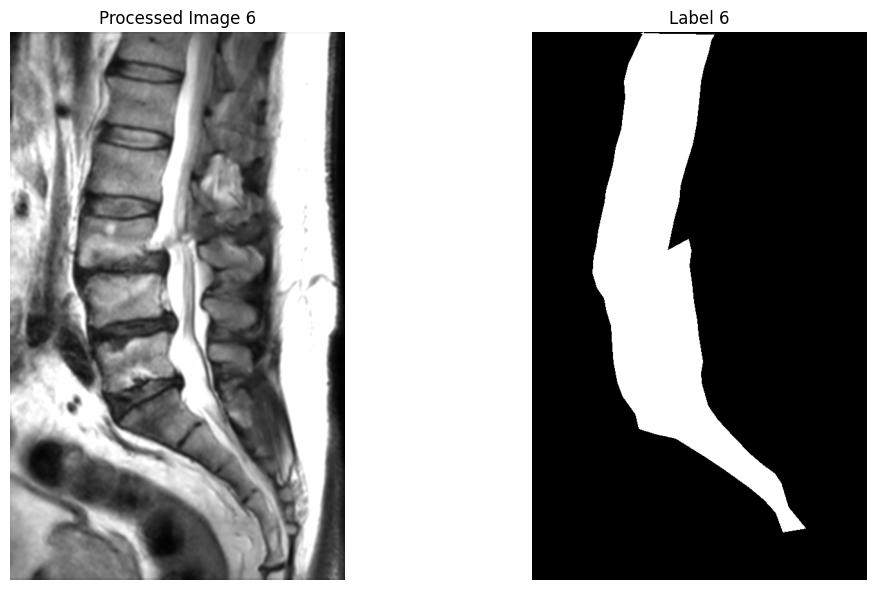

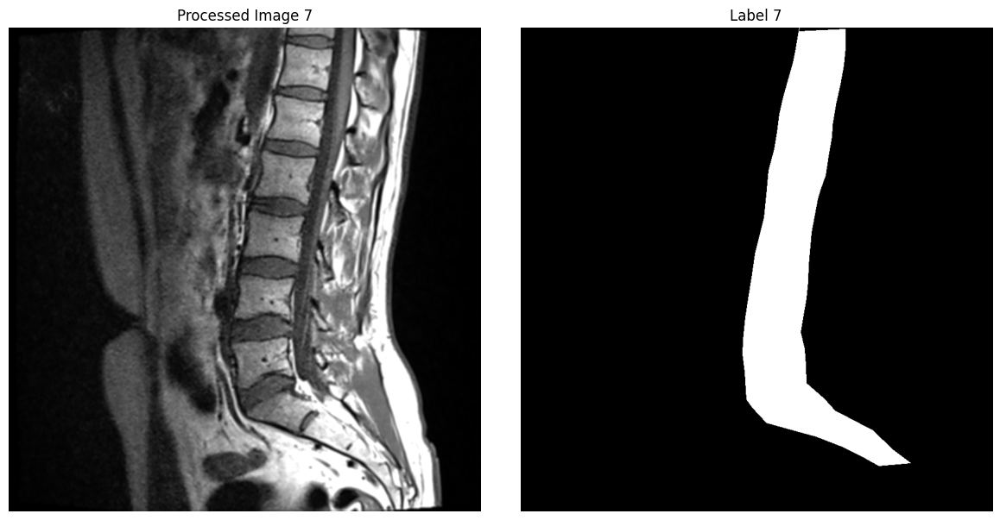

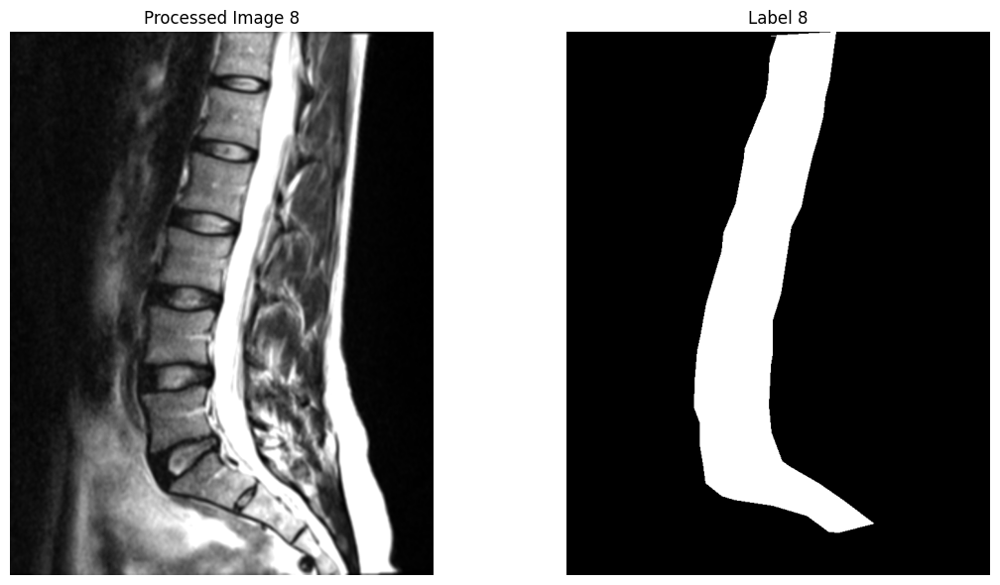

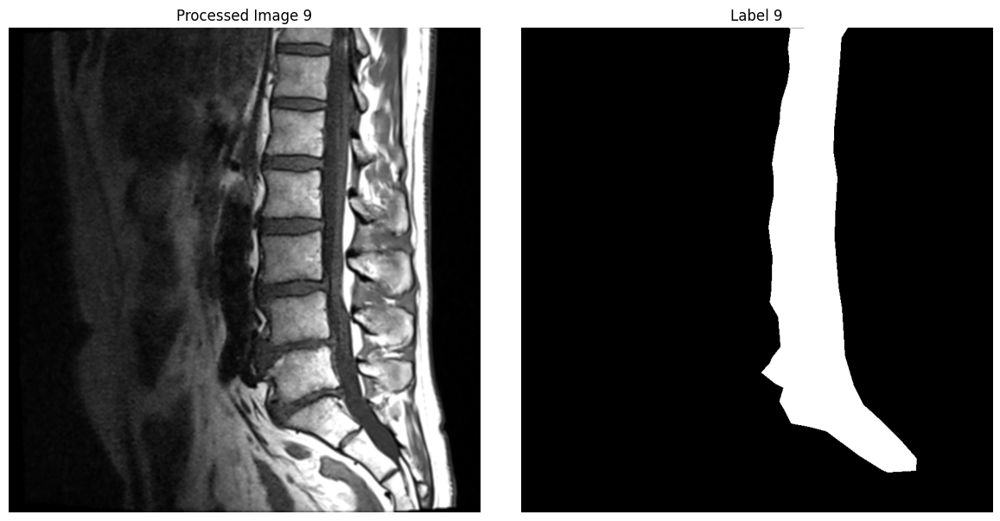

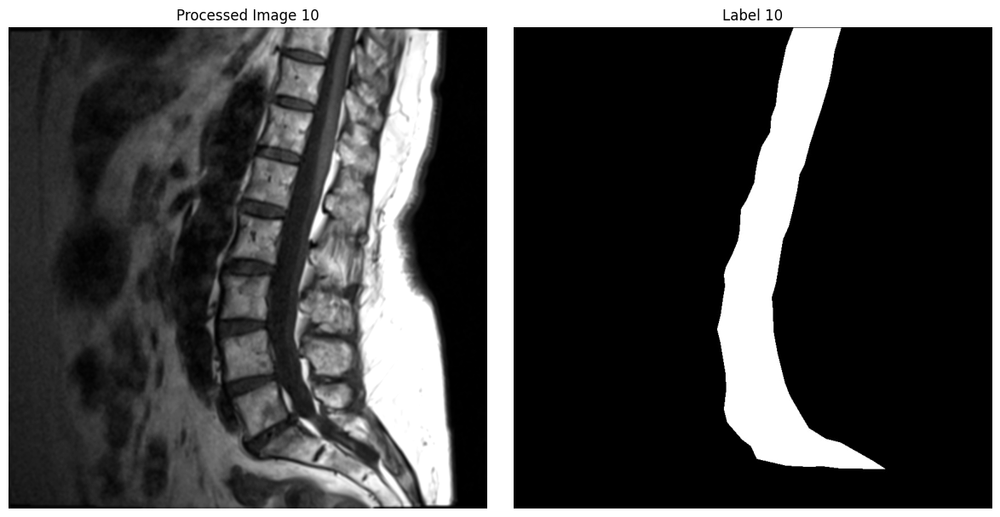

In [55]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntü ve etiketleri yükleyen fonksiyon
def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    
    # Görüntülerin yüklendiğini kontrol et
    if img is None:
        raise FileNotFoundError(f"Görüntü yüklenemedi: {imgStr}")
    if label is None:
        raise FileNotFoundError(f"Etiket yüklenemedi: {labelStr}")
    
    if draw:
        # Görüntü ve etiketleri yan yana çiz
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()
        
    return img, label

# Görüntü dosyalarının yolları
image_paths = [
    "./DB/images/img (6).png",
    "./DB/images/img (7).png",
    "./DB/images/img (8).png",
    "./DB/images/img (9).png",
    "./DB/images/img (10).png"
]

label_paths = [
    "./DB/labels/label (6).png",
    "./DB/labels/label (7).png",
    "./DB/labels/label (8).png",
    "./DB/labels/label (9).png",
    "./DB/labels/label (10).png"
]
# Adımlar
def process_image(image_path, label_path):
    # Görüntüyü ve etiketi yükle
    img, label = GetImageLabel(image_path, label_path, draw=False)

    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0
    normalized_image = (normalized_image * 255).astype(np.uint8)

    # Ortalama (Mean) Filtreleme
    def mean_filter(image, kernel_size=5):
        return cv2.blur(image, (kernel_size, kernel_size))

    mean_filtered = mean_filter(normalized_image, kernel_size=5)

    # Parlaklık Artırma
    brightness_increase = 20
    brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

    return brightened_image, label

# İşlenmiş görüntüleri ve etiketleri saklamak için listeler
brightened_images = []
labels = []

# Görüntüleri işleme ve son hali yazdırma
for i, (image_path, label_path) in enumerate(zip(image_paths, label_paths)):
    brightened_image, label = process_image(image_path, label_path)
    brightened_images.append(brightened_image)
    labels.append(label)

    # Görüntüleri ve etiketleri yan yana çiz
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(brightened_image, cmap='gray')
    plt.title(f"Processed Image {i+6}")
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.imshow(label, cmap='gray')
    plt.title(f"Label {i+6}")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()


#### 1. **`Drawing` Fonksiyonu**
- Görüntü üzerinde belirli noktaları işaretler.
- **Parametreler**:
  - `img`: Giriş görüntüsü.
  - `EdgePoints`: İşaretlenecek noktaların koordinatları.
  - `circle_radius`: Noktaları çizerken kullanılan dairenin yarıçapı (varsayılan: `10`).
- **Çıktı**:
  - İşaretlenmiş görüntü matplotlib ile görselleştirilir.

#### 2. **`GetNonBlackPixels` Fonksiyonu**
- Siyah olmayan piksellerin koordinatlarını tespit eder ve opsiyonel olarak bu noktaları işaretler.
- Görüntüyü üst ve alt yarı olarak ikiye böler, her bir yarı üzerinde eşikleme uygular.
- **Parametreler**:
  - `img`: Giriş görüntüsü.
  - `sparsity_factor`: Piksellerin seyrekleştirilmesi için kullanılan faktör (varsayılan: `1`).
  - `draw`: Tespit edilen noktaların görüntü üzerinde işaretlenip işaretlenmeyeceğini belirler (varsayılan: `False`).
  - `circle_radius`: İşaretleme için nokta boyutu (varsayılan: `10`).
- **Çıktı**:
  - Siyah olmayan piksellerin `(y, x)` formatındaki koordinatları.

### İşlem Adımları

1. **Görüntü Bölme**:
   - Görüntü üst ve alt olmak üzere iki yarıya ayrılır.
   - Her bölge üzerinde eşikleme yapılır:
     - Üst bölge: Siyah olmayan pikseller `>70` eşiğine göre tespit edilir.
     - Alt bölge: Aynı işlem uygulanır, ancak `y` koordinatları ayarlanır.

2. **Seyrekleştirme**:
   - Belirli bir aralığa (`sparsity_factor`) göre piksellerin yoğunluğu azaltılır.

3. **Çizim (Opsiyonel)**:
   - İşaretlenmiş noktalar `Drawing` fonksiyonu ile görüntü üzerinde gösterilir.

4. **Her Görüntü İçin İşleme**:
   - İşlenmiş tüm görüntüler üzerinde siyah olmayan pikseller tespit edilir ve çizdirilir.

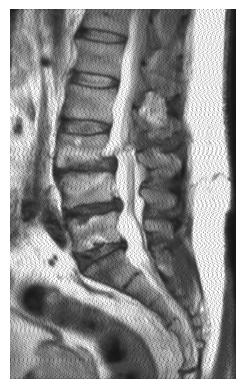

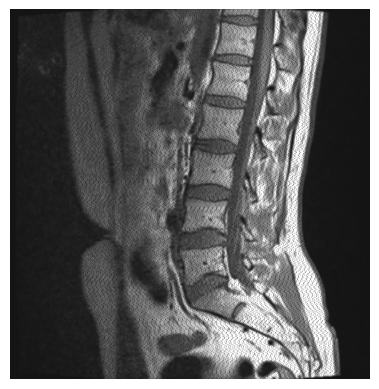

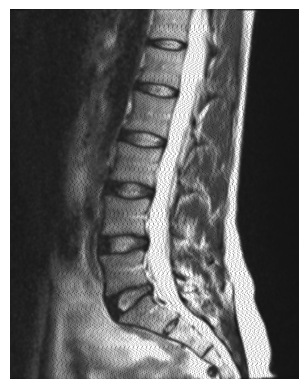

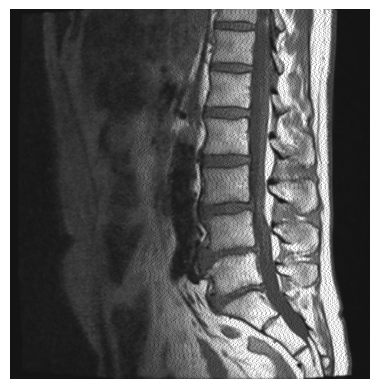

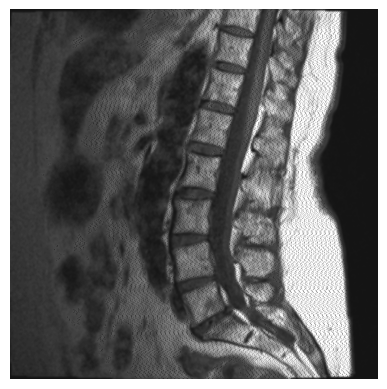

In [56]:

# Önceden tanımlı Drawing fonksiyonu
def Drawing(img, EdgePoints, circle_radius=10):
    
    img_copy = img.copy()
    for point in EdgePoints:
        cv2.circle(img_copy, tuple(point[::-1]), circle_radius, (0, 0, 255), -1)  # Kırmızı nokta çizer
    plt.imshow(img_copy, cmap='gray')
    plt.axis('off')  # Eksenleri kapat
    plt.show()

# Siyah olmayan pikselleri alan fonksiyon
def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
   
    # Görüntünün boyutlarını al
    height, width = img.shape

    # Görüntüyü yukarı ve aşağı olarak iki bölgeye ayır
    top_half = img[:height // 2, :]
    bottom_half = img[height // 2:, :]

    # Yukarı bölge için eşikleme
    y_top, x_top = np.where(top_half > 70)
    pixels_top = np.vstack((y_top, x_top)).T

    # Aşağı bölge için eşikleme
    y_bottom, x_bottom = np.where(bottom_half > 70)
    y_bottom += height // 2  # Aşağı bölgenin y koordinatını düzelt
    pixels_bottom = np.vstack((y_bottom, x_bottom)).T

    # Yukarı ve aşağı bölgelerin piksellerini birleştir
    pixels = np.vstack((pixels_top, pixels_bottom))

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]

    # Çizim yapmak istenirse
    if draw:
        Drawing(img, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# Her bir işlenmiş görüntü için siyah olmayan pikselleri al ve çiz
for i, img in enumerate(brightened_images, start=6):
    # Siyah olmayan pikselleri al
    test_img_Points = GetNonBlackPixels(img, sparsity_factor=10, circle_radius=0, draw=True)


Bu kod, görüntüler üzerinde yama (patch) çıkarımı ve rastgele alt örnekleme işlemleri yaparak yamaları `.npz` formatında kaydeder.
### İşlem Adımları

1. **Çıkış Dizini**:
   - Yama dosyalarının kaydedileceği dizin oluşturulur: `./DB/output/`.

2. **Maske Oluşturma**:
   - Görüntünün orta kısmını belirlemek için bir maske oluşturulur.
   - Maske oranı `mask_fraction` parametresiyle kontrol edilir (varsayılan: `%50`).

3. **Siyah Olmayan Piksellerin Tespiti**:
   - Maske uygulanmış görüntüde siyah olmayan pikseller `GetNonBlackPixels` fonksiyonu ile alınır.

4. **Yama Çıkarımı**:
   - Tespit edilen siyah olmayan piksellerden `PatchSize=20` parametresiyle yamalar çıkarılır (`GetPatchsFromNonBlackPixels` fonksiyonu ile).

5. **Rastgele Alt Örnekleme**:
   - Çıkarılan yamalar, `sampling_ratio` parametresi ile belirlenen oran kadar rastgele azaltılır.

6. **Yamaların Kaydedilmesi**:
   - Yamalar ve yama bilgileri `.npz` formatında sıkıştırılarak kaydedilir.
   - Dosya adı, görüntü adı ile ilişkilendirilir.

7. **Yama Bilgilerinin Yazdırılması**:
   - Her görüntü için çıkarılan toplam yama sayısı konsola yazdırılır.

2. **Toplam Yama Sayısı**:
   - Her görüntü için konsola yazdırılır.
   ```plaintext
   test_image6 için toplam patch sayısı: X
   test_image7 için toplam patch sayısı: Y


In [57]:
import os
import numpy as np
import random
import cv2

# Patch'leri ve bilgileri saklayacak sözlük
patches_dict = {}

# Çıkış dizini
output_directory = "./DB/output/"
os.makedirs(output_directory, exist_ok=True)

# Görüntü ve isim listesi
sharpened_images = brightened_images  # Görüntülerinizi burada tanımlayın
image_names = ['test_image6', 'test_image7', 'test_image8', 'test_image9', 'test_image10']

# Maske parametreleri
mask_fraction = 0.5  # Görüntünün orta kısmı (örneğin %50)
sampling_ratio = 0.5  # %50 oranında rastgele azaltma

for img, img_name in zip(sharpened_images, image_names):
    try:
        # Görüntü boyutlarını al
        height, width = img.shape[:2]

        # Maske oluştur (orta bölge)
        mask = np.zeros((height, width), dtype=np.uint8)
        start_x, end_x = int(width * (1 - mask_fraction) / 2), int(width * (1 + mask_fraction) / 2)
        start_y, end_y = int(height * (1 - mask_fraction) / 2), int(height * (1 + mask_fraction) / 2)
        cv2.rectangle(mask, (start_x, start_y), (end_x, end_y), 255, -1)

        # Maskelenmiş siyah olmayan pikselleri al
        masked_image = cv2.bitwise_and(img, img, mask=mask)
        non_black_pixels = GetNonBlackPixels(masked_image, sparsity_factor=20, circle_radius=2, draw=False)

        # Patch'leri al
        patches, patch_info = GetPatchsFromNonBlackPixels(img, non_black_pixels, PatchSize=20, draw=False)

        # Rastgele alt örnekleme
        if len(patches) > 0:
            num_samples = int(len(patches) * sampling_ratio)
            selected_indices = random.sample(range(len(patches)), num_samples)
            patches = [patches[i] for i in selected_indices]
            patch_info = [patch_info[i] for i in selected_indices]

        # Patch'leri kaydet
        output_file = os.path.join(output_directory, f"{img_name}_patches.npz")
        np.savez_compressed(output_file, patches=patches, patch_info=patch_info)
        patches_dict[img_name] = {'patches': patches, 'patch_info': patch_info}
        print(f"{img_name} için patch'ler kaydedildi: {output_file}")

    except Exception as e:
        print(f"{img_name} işlenirken hata oluştu: {e}")

# Patch bilgilerini yazdır
for img_name, patch_data in patches_dict.items():
    print(f"{img_name} için toplam patch sayısı: {len(patch_data['patches'])}")


test_image6 için patch'ler kaydedildi: ./DB/output/test_image6_patches.npz
test_image7 için patch'ler kaydedildi: ./DB/output/test_image7_patches.npz
test_image8 için patch'ler kaydedildi: ./DB/output/test_image8_patches.npz
test_image9 için patch'ler kaydedildi: ./DB/output/test_image9_patches.npz
test_image10 için patch'ler kaydedildi: ./DB/output/test_image10_patches.npz
test_image6 için toplam patch sayısı: 2376
test_image7 için toplam patch sayısı: 3383
test_image8 için toplam patch sayısı: 2619
test_image9 için toplam patch sayısı: 2232
test_image10 için toplam patch sayısı: 2291


#### 1. **`save_hog_features_with_coords` Fonksiyonu**
- Yamalar üzerinden **HOG (Histogram of Oriented Gradients)** özelliklerini çıkarır ve yamaların koordinat bilgileriyle birlikte sıkıştırılmış bir dosyaya kaydeder.

### İşlem Adımları

1. **Çıkış Dizini Oluşturma**:
   - Yama özellik dosyalarının kaydedileceği çıkış dizini oluşturulur: `./DB/output/`.

2. **Siyah Olmayan Piksellerin Tespiti**:
   - Her görüntüde siyah olmayan pikseller `GetNonBlackPixels` fonksiyonu ile alınır.

3. **Yamaların Çıkarılması**:
   - Siyah olmayan piksellerden yamalar ve yamaların koordinat bilgileri `GetPatchsFromNonBlackPixels` fonksiyonu ile elde edilir.
   - Yama boyutu: `PatchSize=10`.

4. **HOG Özelliklerinin Hesaplanması**:
   - Her bir yamadan `hog` fonksiyonu ile HOG özellikleri çıkarılır.
   - HOG parametreleri:
     - `orientations=9`
     - `pixels_per_cell=(8, 8)`
     - `cells_per_block=(2, 2)`

5. **HOG Özelliklerinin Kaydedilmesi**:
   - Yamaların HOG özellikleri ve koordinat bilgileri `.npz` formatında sıkıştırılarak kaydedilir.
   - Dosya isimleri görüntü adlarına göre oluşturulur (örneğin: `test_image6_hog_features_with_coords.npz`).

6. **Hata Kontrolü**:
   - Her görüntü için siyah olmayan pikseller veya yamalar bulunamazsa bir uyarı mesajı konsola yazdırılır.

In [59]:
import cv2
import numpy as np
import os
from skimage.feature import hog

# HOG özelliklerini çıkaran ve kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_file):
    """
    HOG özelliklerini çıkarır ve koordinatlarla birlikte sıkıştırılmış bir dosyaya kaydeder.
    """
    hog_features = []
    coords = []

    for patch, info in zip(patches, patch_info):
        # HOG özelliğini çıkar
        fd, _ = hog(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)
        hog_features.append(fd)
        coords.append(info)

    # Özellikleri ve koordinatları sıkıştırılmış dosyaya kaydet
    np.savez_compressed(output_file, hog_features=hog_features, coords=coords)
    print(f"Kayıt başarılı: {output_file}")

# Görüntüler ve isimleri
sharpened_images = sharpened_images  # Keskinleştirilmiş görüntülerin listesi
image_names = ['test_image6', 'test_image7', 'test_image8', 'test_image9', 'test_image10']  # Görüntü isimleri
output_directory = "./DB/output/"  # Çıkış dizini

# Çıktı klasörünü oluştur
os.makedirs(output_directory, exist_ok=True)

# Her bir görüntü için patch'leri al ve HOG özelliklerini kaydet
for img, img_name in zip(sharpened_images, image_names):
    try:
        # Siyah olmayan pikselleri al
        non_black_pixels = GetNonBlackPixels(img, sparsity_factor=10, circle_radius=1, draw=False)

        if len(non_black_pixels) == 0:
            print(f"Siyah olmayan piksel bulunamadı: {img_name}")
            continue

        # Patch'leri al
        patches, patch_info = GetPatchsFromNonBlackPixels(img, non_black_pixels, PatchSize=10, draw=False)

        if len(patches) == 0:
            print(f"Hiçbir patch oluşturulamadı: {img_name}")
            continue

        # HOG özelliklerini kaydet
        output_file = os.path.join(output_directory, f"{img_name}_hog_features_with_coords.npz")
        save_hog_features_with_coords(patches, patch_info, output_file)

    except Exception as e:
        print(f"{img_name} işlenirken hata oluştu: {e}")


Kayıt başarılı: ./DB/output/test_image6_hog_features_with_coords.npz
Kayıt başarılı: ./DB/output/test_image7_hog_features_with_coords.npz
Kayıt başarılı: ./DB/output/test_image8_hog_features_with_coords.npz
Kayıt başarılı: ./DB/output/test_image9_hog_features_with_coords.npz
Kayıt başarılı: ./DB/output/test_image10_hog_features_with_coords.npz


Dosyanın içeriğini kontrol ediyoruz.

In [60]:
# Dosyanın içeriğini kontrol etme
hog_data = np.load(r"C:\Users\t_g-2\OneDrive\Masaüstü\Son\DB\output\hog_features\processed_image_6_hog_features_with_coords.npz")
print(hog_data.files)  # Dosyanın içinde hangi anahtarların bulunduğunu gösterir


['hog_features', 'coords']


#### 1. **`compute_cross_correlation_optimized` Fonksiyonu**
- İki HOG vektör kümesi arasındaki çapraz korelasyon matrisini hesaplar.
- **Kullanım Amacı**: Test görüntüleri ile depolanmış referans HOG vektörleri arasında benzerlik tespiti yapmak.

### İşlem Adımları

1. **HOG Özelliklerinin Yüklenmesi**:
   - HDD'de depolanan referans HOG vektörleri `stored_hog_vectors` olarak yüklenir.
   - Test görüntülerine ait HOG dosyaları (`hog_files`) her bir görüntü için sırayla okunur.

2. **Görüntü ve Etiketlerin Yüklenmesi**:
   - Test görüntüsü (`test_image_path`) ve etiket görüntüsü (`label_image_path`) okunur.
   - Etiket görüntüsünden omurga bölgesi için bir maske (`spine_mask`) oluşturulur.

3. **Çapraz Korelasyon Hesaplama**:
   - Test HOG vektörleri ile referans HOG vektörleri arasında çapraz korelasyon hesaplanır.
   - Korelasyon değeri `0.30` eşik değerinin üzerinde olanlar seçilir.

4. **Omurga Bölgesindeki Eşleşmelerin İşlenmesi**:
   - Eşik değerini geçen yüksek korelasyonlu noktalar işlenir.
   - Yalnızca omurga bölgesinde bulunan eşleşmeler dikkate alınır ve bir çıktı görüntüsüne işlenir.

5. **Sonuçların Görselleştirilmesi**:
   - Her test görüntüsü için:
     - Orijinal görüntü,
     - Etiket görüntüsü (omurga maskesi),
     - Eşleşen noktaların işlendiği çıktı görüntüsü, yan yana matplotlib ile gösterilir.

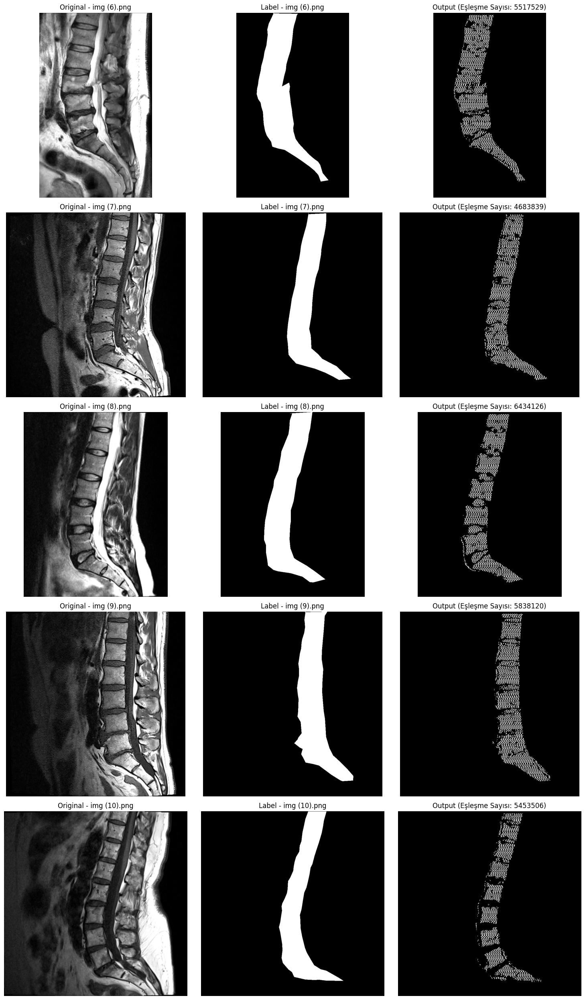

In [61]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist
import os

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    """
    İki vektör kümesi arasındaki korelasyon matrisini hesaplar.
    """
    return 1 - cdist(vectors1, vectors2, metric='correlation')

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_file = "./DB/output/hog_features_with_coords.npz"
if not os.path.exists(stored_hog_file):
    raise FileNotFoundError(f"HOG özellik dosyası bulunamadı: {stored_hog_file}")

stored_hog_vectors = np.load(stored_hog_file)['features']

# İşlenecek test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    "./DB/images/img (6).png",
    "./DB/images/img (7).png",
    "./DB/images/img (8).png",
    "./DB/images/img (9).png",
    "./DB/images/img (10).png"
]

label_image_paths = [
    "./DB/labels/label (6).png",
    "./DB/labels/label (7).png",
    "./DB/labels/label (8).png",
    "./DB/labels/label (9).png",
    "./DB/labels/label (10).png"
]

hog_files = [
    "./DB/output/test_image6_hog_features_with_coords.npz",
    "./DB/output/test_image7_hog_features_with_coords.npz",
    "./DB/output/test_image8_hog_features_with_coords.npz",
    "./DB/output/test_image9_hog_features_with_coords.npz",
    "./DB/output/test_image10_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))

for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    try:
        # Test HOG vektörlerini ve koordinatlarını yükleme
        if not os.path.exists(hog_file):
            raise FileNotFoundError(f"HOG dosyası bulunamadı: {hog_file}")
        
        hog_data = np.load(hog_file)
        test_hog_vectors = hog_data['hog_features']
        test_coords = hog_data['coords']

        # Test görüntüsünü yükleme
        test_image = cv2.imread(test_image_path)
        if test_image is None:
            raise FileNotFoundError(f"Test görüntüsü bulunamadı: {test_image_path}")
        
        output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma

        # Etiket görüntüsünü yükleme
        label_image = cv2.imread(label_image_path, cv2.IMREAD_GRAYSCALE)
        if label_image is None:
            raise FileNotFoundError(f"Etiket görüntüsü bulunamadı: {label_image_path}")

        # Sadece omurga bölgesindeki pikseller için maske oluşturma
        spine_mask = (label_image > 0).astype(np.uint8)  # Etiket omurga bölgesini belirtiyor

        # Çapraz korelasyonu hızlı hesaplama
        correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
        threshold = 0.30
        high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

        # Yüksek korelasyon eşleşmelerini işleme (sadece omurga bölgesi içinde)
        matching_coords_count = 0
        for test_idx, _ in high_correlation_indices:
            coord = test_coords[test_idx]
            x, y = int(coord[0]), int(coord[1])
            if spine_mask[y, x] > 0:  # Omurga bölgesindeyse işleme
                cv2.circle(output_img, (x, y), 1, (255, 255, 255), -1)
                matching_coords_count += 1

        # Görüntü adını dosya yolundan çıkarma
        image_name = os.path.basename(test_image_path)

        # Orijinal görüntü, etiket ve çıktı görselleştirme
        plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
        plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Original - {image_name}")
        plt.axis('off')

        plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
        plt.imshow(label_image, cmap='gray')
        plt.title(f"Label - {image_name}")
        plt.axis('off')

        plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
        plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Output (Eşleşme Sayısı: {matching_coords_count})")
        plt.axis('off')

    except Exception as e:
        print(f"{test_image_path} işlenirken hata oluştu: {e}")

plt.tight_layout()
plt.show()


#### 1. **`calculate_iou` Fonksiyonu**
- **Intersection over Union (IoU)** değerini hesaplar.
- **Adımlar**:
  1. Görüntüleri ikili (binary) forma dönüştürür.
  2. Kesişim ve birleşim alanlarını hesaplar.
  3. IoU: `intersection / union` olarak döner.

#### 2. **`compute_cross_correlation_optimized` Fonksiyonu**
- HOG vektörleri arasında çapraz korelasyon hesaplar.
- **Kullanım Amacı**:
  - Test ve referans HOG vektörleri arasında benzerlik tespiti.

### İşlem Adımları

1. **HOG Özelliklerinin Yüklenmesi**:
   - Referans HOG vektörleri `stored_hog_vectors` olarak yüklenir.
   - Her test görüntüsüne ait HOG vektörleri (`hog_features`) ve koordinat bilgileri (`coords`) ayrı dosyalardan okunur.

2. **Çapraz Korelasyon Hesaplama**:
   - Test HOG vektörleri ile referans HOG vektörleri arasında korelasyon hesaplanır.
   - Korelasyon değeri eşik değeri (`threshold = 0.30`) üzerinde olan eşleşmeler seçilir.

3. **Çıkış Görüntüsünün Oluşturulması**:
   - Eşleşen koordinatlar, test görüntüsünde dairelerle işaretlenir (`output_img`).

4. **IoU Hesaplama**:
   - Çıkış görüntüsü ile etiket görüntüsü arasında IoU değeri hesaplanır.
   - Her görüntü için hesaplanan IoU değeri bir listeye (`ious`) eklenir.

5. **Ortalama IoU Hesaplama ve Görselleştirme**:
   - Tüm test görüntüleri için ortalama IoU değeri hesaplanır ve konsola yazdırılır.
   - IoU değerleri, bir çubuk grafik ile görselleştirilir. Ortalama IoU kırmızı bir çizgi ile belirtilir.

### Notlar
- IoU, modelin test görüntülerindeki omurga bölgesi tespiti ile etiketlerin ne kadar örtüştüğünü ölçer.
- Çıktılar, model performansını değerlendirmek için görsel ve sayısal olarak sunulmuştur.


Test Image 6: IoU = 0.2030
Test Image 7: IoU = 0.1734
Test Image 8: IoU = 0.2497
Test Image 9: IoU = 0.2353
Test Image 10: IoU = 0.1732

(Görüntü + Lbp + Hog + Cross Kolerasyon) Ortalama IoU: 0.2069


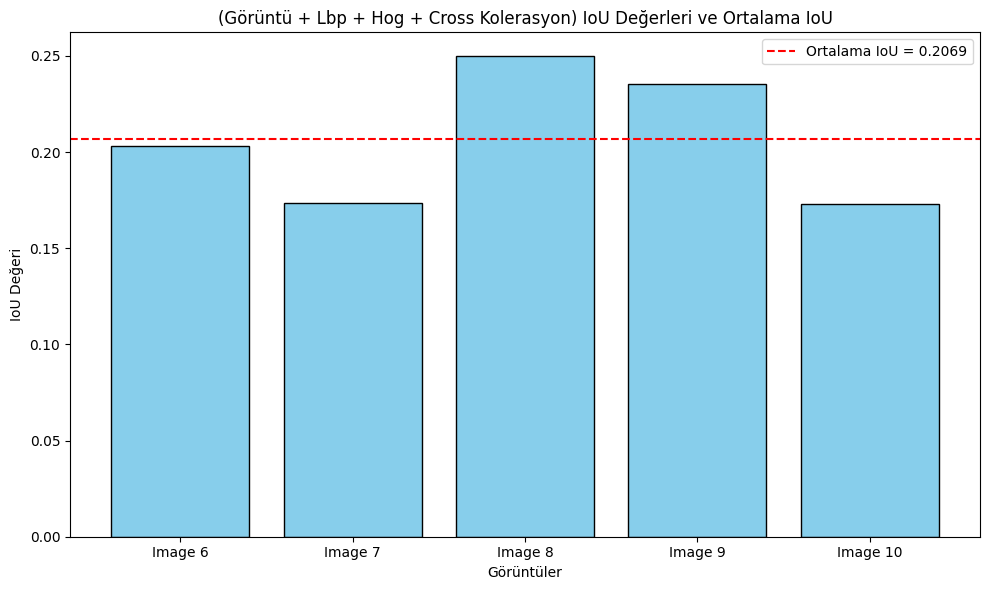

In [64]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    """
    İki görüntü arasındaki Intersection over Union (IoU) değerini hesaplar.
    """
    # İkili görüntüye dönüştürme (thresholding)
    _, pred_binary = cv2.threshold(cv2.cvtColor(predicted_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(cv2.cvtColor(label_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)
    
    # Kesişim ve birleşim
    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()
    
    # IoU hesaplama
    iou = intersection / union if union != 0 else 0
    return iou

# Test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    "./DB/images/img (6).png",
    "./DB/images/img (7).png",
    "./DB/images/img (8).png",
    "./DB/images/img (9).png",
    "./DB/images/img (10).png"
]

label_image_paths = [
    "./DB/labels/label (6).png",
    "./DB/labels/label (7).png",
    "./DB/labels/label (8).png",
    "./DB/labels/label (9).png",
    "./DB/labels/label (10).png"
]

hog_files = [
    "./DB/output/test_image6_hog_features_with_coords.npz",
    "./DB/output/test_image7_hog_features_with_coords.npz",
    "./DB/output/test_image8_hog_features_with_coords.npz",
    "./DB/output/test_image9_hog_features_with_coords.npz",
    "./DB/output/test_image10_hog_features_with_coords.npz"
]

# Referans HOG vektörleri
stored_hog_file = "./DB/output/hog_features_with_coords.npz"
stored_hog_vectors = np.load(stored_hog_file)['features']

# Eşik değeri
threshold = 0.30

# IoU hesaplama ve çıktı
ious = []
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    try:
        # Çıkış görüntüsü
        output_img = np.zeros_like(cv2.imread(test_image_path))

        # HOG verilerini yükleme
        hog_data = np.load(hog_file)
        test_hog_vectors = hog_data['hog_features']
        test_coords = hog_data['coords']

        # Korelasyon matrisini hesapla
        correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
        high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

        # Çıkış görüntüsünü oluştur
        for test_idx, _ in high_correlation_indices:
            coord = test_coords[test_idx]
            x, y = int(coord[0]), int(coord[1])
            cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)

        # Etiket görüntüsünü yükleme
        label_image = cv2.imread(label_image_path)
        if label_image is None:
            raise FileNotFoundError(f"Etiket görüntüsü bulunamadı: {label_image_path}")

        # IoU hesaplama
        iou = calculate_iou(output_img, label_image)
        ious.append(iou)
        print(f"Test Image {idx + 6}: IoU = {iou:.4f}")

    except Exception as e:
        print(f"{test_image_path} işlenirken hata oluştu: {e}")

# Ortalama IoU
if ious:
    mean_iou = np.mean(ious)
    print(f"\n(Görüntü + Lbp + Hog + Cross Kolerasyon) Ortalama IoU: {mean_iou:.4f}")
else:
    print("\nIoU hesaplamaları için geçerli sonuç bulunamadı.")

# IoU Grafik Çıktısı
if ious:
    image_names = [f"Image {i+6}" for i in range(len(ious))]
    plt.figure(figsize=(10, 6))
    plt.bar(image_names, ious, color='skyblue', edgecolor='black')
    plt.axhline(mean_iou, color='red', linestyle='--', label=f'Ortalama IoU = {mean_iou:.4f}')
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('(Görüntü + Lbp + Hog + Cross Kolerasyon) IoU Değerleri ve Ortalama IoU')
    plt.legend()
    plt.tight_layout()
    plt.show()


#### 1. **`normalize_image`**
- Görüntüdeki piksel değerlerini `[0, 1]` aralığına normalize eder ve tekrar `[0, 255]` aralığına döndürür.

#### 2. **`mean_filter`**
- Ortalama filtre uygulayarak görüntüyü pürüzsüzleştirir. 
- Çekirdek boyutu: `5x5`.

#### 3. **`increase_brightness`**
- Görüntünün parlaklığını artırır. 
- Varsayılan artış miktarı: `25`.

#### 4. **`process_image`**
- Bir görüntü ve etiket üzerinde aşağıdaki işlemleri sırasıyla uygular:
  1. **Erozyon**:
     - Etiket görüntüsüne, `10x10` boyutunda bir çekirdek ile erozyon uygular.
  2. **Normalizasyon**:
     - Görüntüyü normalize eder.
  3. **Ortalama Filtreleme**:
     - Görüntüyü pürüzsüzleştirir.
  4. **Parlaklık Artırma**:
     - Görüntünün parlaklığını artırır.
  5. **Maskeleme**:
     - Erozyon uygulanmış etiketi kullanarak etiketli bölgeyi çıkarır.

### İşlem Adımları

1. **Görsellerin ve Etiketlerin İşlenmesi**:
   - Her bir görüntü için:
     - Orijinal görüntü işlenir.
     - Etiket görüntüsü erozyona uğratılır.
     - Etiketli bölge, parlaklık artırılmış ve filtrelenmiş görüntüden çıkarılır.

2. **Sonuçların Görselleştirilmesi**:
   - Her görüntü için üç farklı çıktı matplotlib ile yan yana gösterilir:
     1. **Orijinal Görüntü**
     2. **Erozyon Uygulanmış Etiket**
     3. **İşlenmiş Görüntü**

3. **Sonuçların Konsola Yazdırılması**:
   - İşlenmiş görüntülerin boyutları konsola yazdırılır.

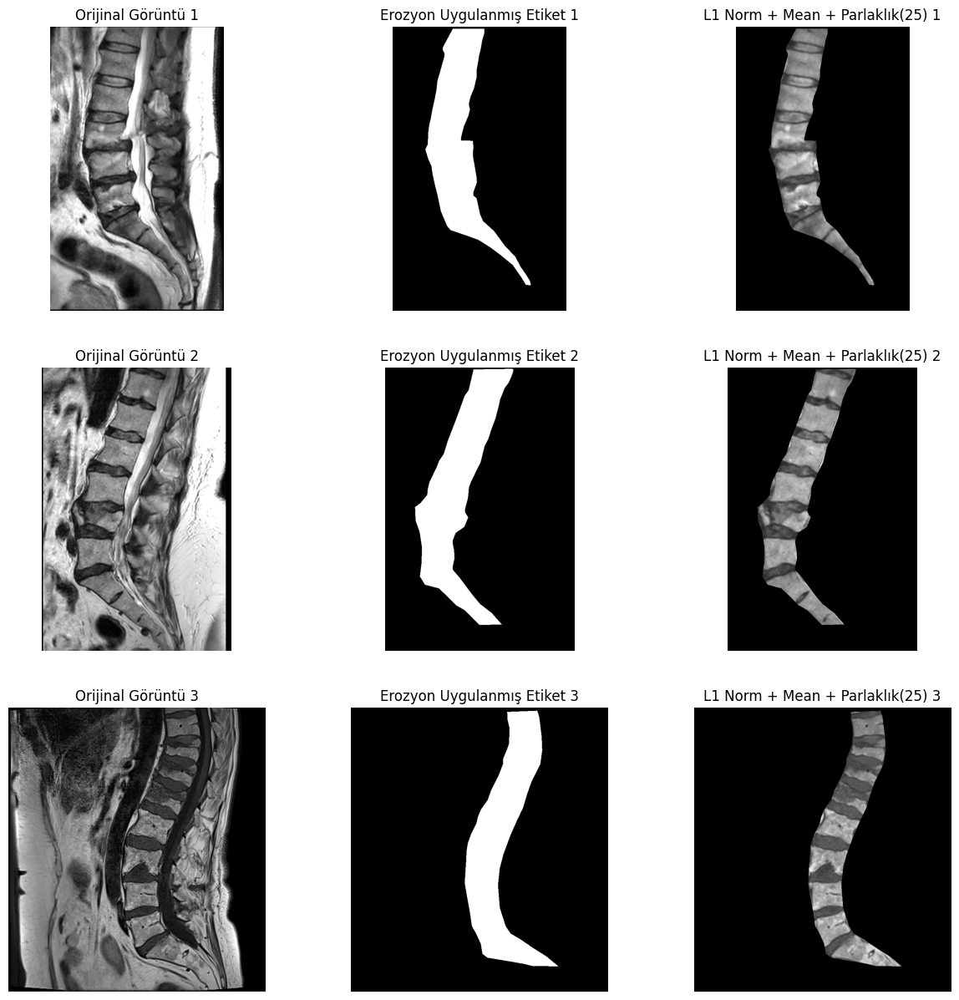

masked_image Boyutları: (856, 523)
masked_image2 Boyutları: (856, 572)
masked_image3 Boyutları: (855, 774)


In [65]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Görüntü ve etiket dosyalarının yolları
image_paths = [
    "./DB/images/img (1).png",
    "./DB/images/img (2).png",
    "./DB/images/img (3).png"
]

label_paths = [
    "./DB/labels/label (1).png",
    "./DB/labels/label (2).png",
    "./DB/labels/label (3).png"
]

# Adım 1: I1 Norm Normalizasyonu
def normalize_image(image):
    normalized_image = image / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    return (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir

# Adım 2: Mean (Ortalama) Filtreleme
def mean_filter(image, kernel_size=5):
    return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

# Adım 3: Parlaklık Artırma
def increase_brightness(image, brightness_increase=25):
    return cv2.add(image, np.full_like(image, brightness_increase))

# Etiketli bölgeyi çıkarma işlemi
def process_image(image_path, label_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    label_image = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)  # Etiket (tek kanallı)

    # Erozyon işlemi
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10))  # 10x10 boyutunda bir çekirdek
    eroded_label = cv2.erode(label_image, kernel, iterations=1)  # Etiketi erozyona uğrat

    # Adım 1: Normalizasyon
    normalized_image = normalize_image(image)

    # Adım 2: Ortalama Filtreleme
    mean_filtered = mean_filter(normalized_image, kernel_size=5)

    # Adım 3: Parlaklık Artırma
    brightened_image = increase_brightness(mean_filtered, brightness_increase=25)

    # Etiketli bölgeyi çıkarma
    masked_image = cv2.bitwise_and(brightened_image, brightened_image, mask=eroded_label)

    return image, eroded_label, masked_image

# Görselleri işleme
processed_images = [process_image(image_paths[i], label_paths[i]) for i in range(3)]

# masked_image'leri adlandırma
masked_image, masked_image2, masked_image3 = [masked for _, _, masked in processed_images]

# Sonuçları görselleştirme
plt.figure(figsize=(15, 15))

for i, (original, eroded_label, masked) in enumerate(processed_images):
    plt.subplot(3, 3, i*3+1)
    plt.title(f"Orijinal Görüntü {i+1}")
    plt.imshow(original, cmap="gray")
    plt.axis("off")

    plt.subplot(3, 3, i*3+2)
    plt.title(f"Erozyon Uygulanmış Etiket {i+1}")
    plt.imshow(eroded_label, cmap="gray")
    plt.axis("off")

    plt.subplot(3, 3, i*3+3)
    plt.title(f"L1 Norm + Mean + Parlaklık(25) {i+1}")
    plt.imshow(masked, cmap="gray")
    plt.axis("off")

plt.show()

# masked_image'leri kullanabilirsiniz:
print(f"masked_image Boyutları: {masked_image.shape}")
print(f"masked_image2 Boyutları: {masked_image2.shape}")
print(f"masked_image3 Boyutları: {masked_image3.shape}")


# `Drawing` Fonksiyonu Özeti

Bu fonksiyon, gri tonlamalı bir görüntü üzerinde noktaları, çizgileri ve yamaları işaretleyerek görselleştirme yapar. Fonksiyon, verilen noktaları kırmızı dairelerle, çizgileri sarı renk ile ve yamaları kırmızı dikdörtgenlerle işaretler. Her bir yama numaralandırılır. İşaretlemeler sonrasında görüntü, uygun boyutlarda bir matplotlib penceresinde görselleştirilir.

- **Noktalar**: Kırmızı dairelerle işaretlenir.
- **Çizgiler**: Sarı renk ile çizilir.
- **Yamalar**: Kırmızı dikdörtgenlerle işaretlenir ve her birine numara atanır.
  
Sonuç olarak, işaretlenen görüntü görselleştirilir ve ekrana aktarılır.


In [66]:
def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius=10):
    """
    Verilen görüntü üzerinde noktaları, çizgileri ve patch'leri işaretleyerek çizim yapar.
    """
    # Gri tonlamalı görüntüyü BGR formatına dönüştür
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

    # Noktaları işaretle
    if EdgePoints is not None:
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)

    # Çizgileri işaretle
    if EdgeLines is not None:
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color=(255, 255, 0), thickness=2)

    # Patch'leri işaretle
    if EdgePatchs is not None:
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)
        thickness = 2
        for k, (x, y, PatchSize) in enumerate(EdgePatchs):
            top_left = (x - PatchSize, y - PatchSize)
            bottom_right = (x + PatchSize, y + PatchSize)
            cv2.rectangle(output_img, top_left, bottom_right, (0, 0, 255), 2)
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)

    # Görüntü boyutlarına göre uygun bir figsize hesapla
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)

    # matplotlib ile görseli çiz
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()


# `GetNonBlackPixels` Fonksiyonu Özeti

Bu fonksiyon, verilen bir görüntüde siyah olmayan piksellerin koordinatlarını tespit eder. Siyah olmayan piksellerin koordinatları, opsiyonel olarak seyrekleştirilebilir (sparsity_factor ile). Ayrıca, bu noktalar isteğe bağlı olarak belirtilen bir yarıçapla işaretlenebilir ve görselleştirilebilir.

---

# Kod Özeti

1. **Siyah Olmayan Piksellerin Tespiti**: Görüntüdeki siyah olmayan piksellerin (yani, piksel değeri 0'dan büyük olan) koordinatları tespit edilir.
2. **Seyrekleştirme (Opsiyonel)**: `sparsity_factor` parametresi kullanılarak, pikseller arasından belli aralıklarla örnek alınarak bir seyrekleştirme yapılır.
3. **Görsel Üzerinde İşaretleme**: Eğer `draw=True` parametresi verilirse, tespit edilen siyah olmayan pikseller görüntü üzerinde kırmızı dairelerle işaretlenir.
4. **Sonuçların Görselleştirilmesi**: 
    - Maskelenmiş görüntülerde tespit edilen noktalar görselleştirilir.
    - Her bir görüntü için, tespit edilen nokta sayısı ekrana yazdırılır.

Fonksiyon, siyah olmayan pikselleri tespit ederek, istenilen görselleştirmeyi sağlar ve noktaların sayısını rapor eder.


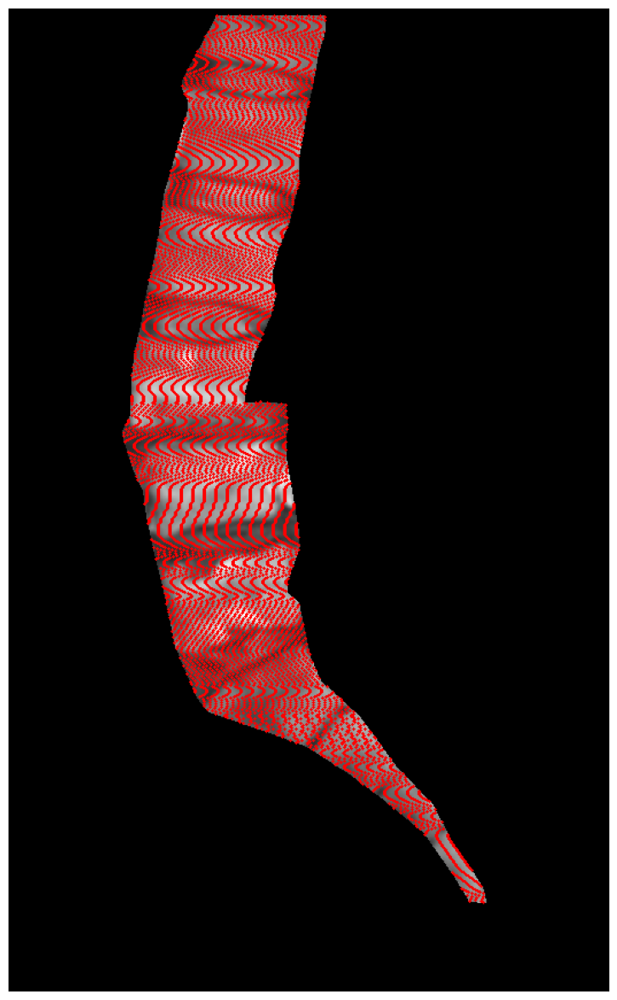

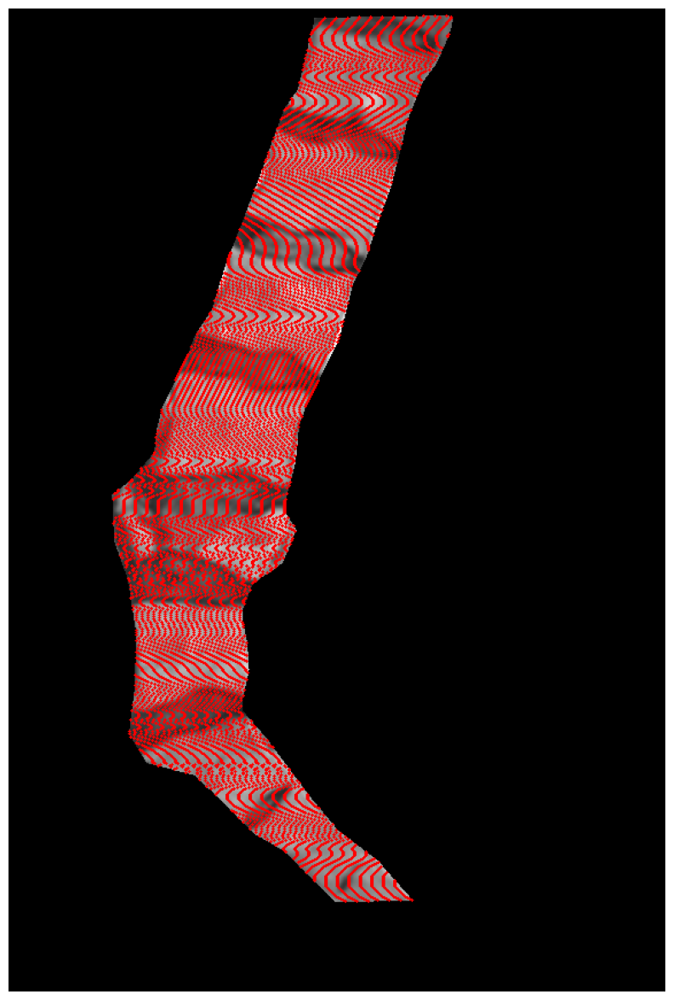

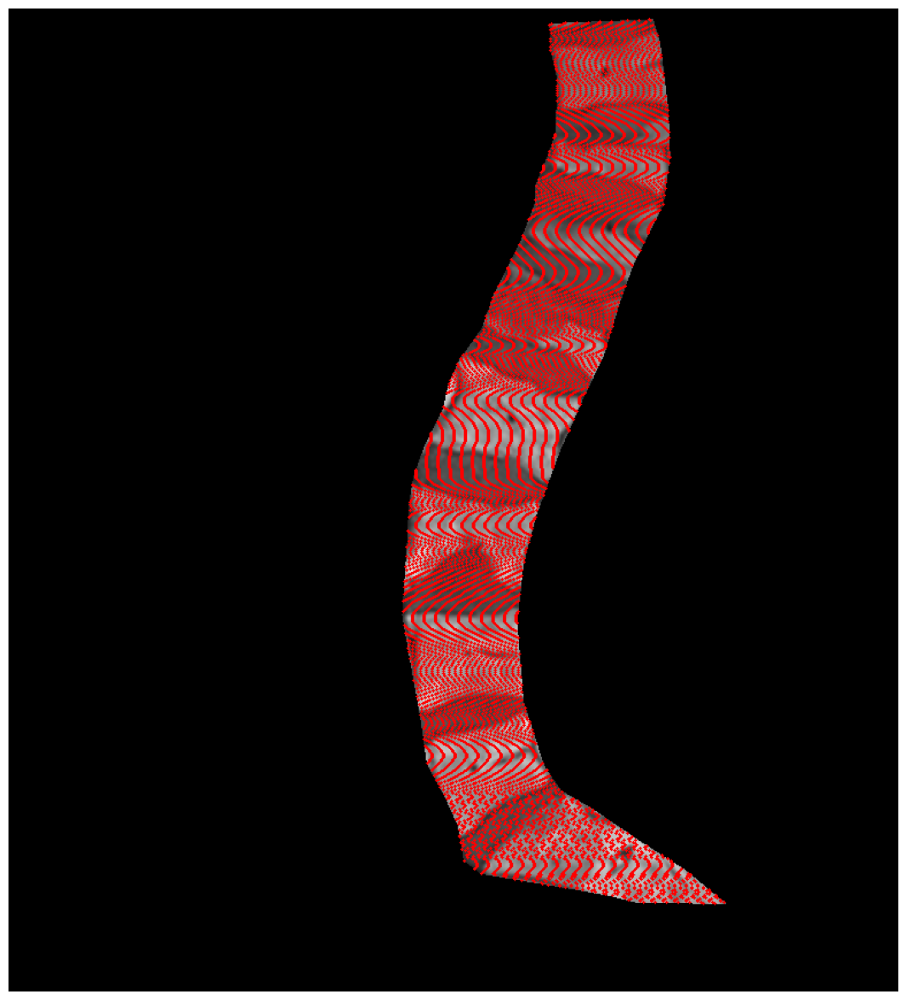

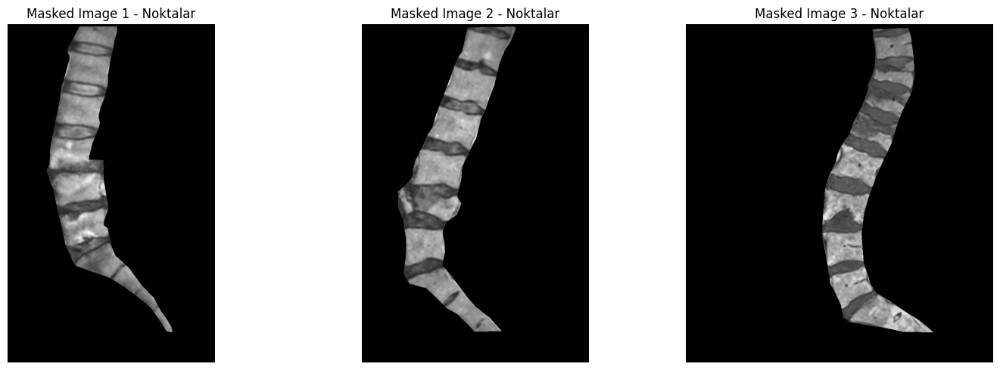

Image 1: Tespit edilen nokta sayısı: 7740
Image 2: Tespit edilen nokta sayısı: 8669
Image 3: Tespit edilen nokta sayısı: 8515


In [67]:
def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    """
    Siyah olmayan pikselleri tespit eder ve isteğe bağlı olarak bu noktaları görüntü üzerinde işaretler.
    """
    # Siyah olmayan piksellerin koordinatlarını tespit et
    y, x = np.where(img > 0)
    pixels = np.vstack((y, x)).T  # (y, x) koordinatlarını birleştir

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]

    # Çizim yapılacaksa noktaları görüntü üzerinde işaretle
    if draw:
        Drawing(img, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# Maskelenmiş görüntüler ve başlıklarını listeleyin
masked_images = [masked_image, masked_image2, masked_image3]
image_titles = ["Masked Image 1", "Masked Image 2", "Masked Image 3"]

# Görsellerin kopyalarını oluşturun
point_masked_images = [img.copy() for img in masked_images]

# Noktaların işaretlenmiş görselleri saklamak için
points = []

# Her bir görüntü için siyah olmayan noktaları işaretleyin
for i, masked_image in enumerate(masked_images):
    points.append(GetNonBlackPixels(point_masked_images[i], sparsity_factor=10, circle_radius=1, draw=True))

# Görselleştirme
plt.figure(figsize=(15, 5))
for i, (masked_image, title) in enumerate(zip(masked_images, image_titles)):
    plt.subplot(1, 3, i + 1)
    plt.imshow(masked_image, cmap='gray')
    plt.title(f"{title} - Noktalar")
    plt.axis('off')

plt.tight_layout()
plt.show()

# İşaretlenen noktaları yazdır
for i, point_set in enumerate(points):
    print(f"Image {i+1}: Tespit edilen nokta sayısı: {len(point_set)}")


# Kod Özeti

Bu kod, maskelenmiş görüntülerde siyah olmayan pikselleri tespit eder, bu noktalar etrafında belirli boyutlarda yamalar çıkarır ve bu yamaları görselleştirir.

---

### Adımlar:
1. **Siyah Olmayan Pikselleri Tespit Etme**: 
    - `GetNonBlackPixels` fonksiyonu, görüntüdeki siyah olmayan piksellerin koordinatlarını tespit eder ve isteğe bağlı olarak bu noktaları işaretler.
    - Ayrıca, `sparsity_factor` ile noktalar seyrekleştirilebilir.

2. **Patch Çıkartma**:
    - `GetPatchsFromNonBlackPixels` fonksiyonu, siyah olmayan pikseller etrafında belirtilen boyutta yamalar (patch'ler) çıkarır.
    - Yama çıkarılacak alanın sınırları kontrol edilerek, geçerli olmayan bölgelere yama eklenmez.
    - Her çıkarılan yama, noktalarla birlikte kaydedilir.

3. **Görselleştirme**:
    - **Noktalar**: Maskelenmiş görüntülerde tespit edilen siyah olmayan noktalar görselleştirilir.
    - **Patch'ler**: Çıkarılan yamalar görselleştirilir. İlk çıkarılan yama her görüntü için gösterilir.

4. **Çıktılar**:
    - Her bir görüntü için tespit edilen nokta sayısı ve çıkarılan patch sayısı yazdırılır.

---

### İşlemler:
- **Noktalar Tespiti**: Maskelenmiş görüntüde siyah olmayan piksellerin koordinatları tespit edilip, bu noktalar işaretlenir.
- **Yama Çıkartma**: Tespit edilen siyah olmayan pikseller etrafında patch'ler çıkarılır.
- **Sonuç Görselleştirmesi**: Tespit edilen noktalar ve çıkarılan yamalar, matplotlib ile görselleştirilir.

### Görselleştirme:
1. **Tespit Edilen Noktalar**: Görüntülerdeki siyah olmayan noktalar işaretlenir.
2. **Çıkarılan İlk Patch**: Her görüntüden çıkarılan ilk patch görselleştirilir.

### Notlar:
- `sparsity_factor` parametresiyle, siyah olmayan piksellerin sayısı azaltılabilir.
- Çıkarılan patch'ler, boyutları ve görselleştirilmesi açısından dikkatlice ele alınır.


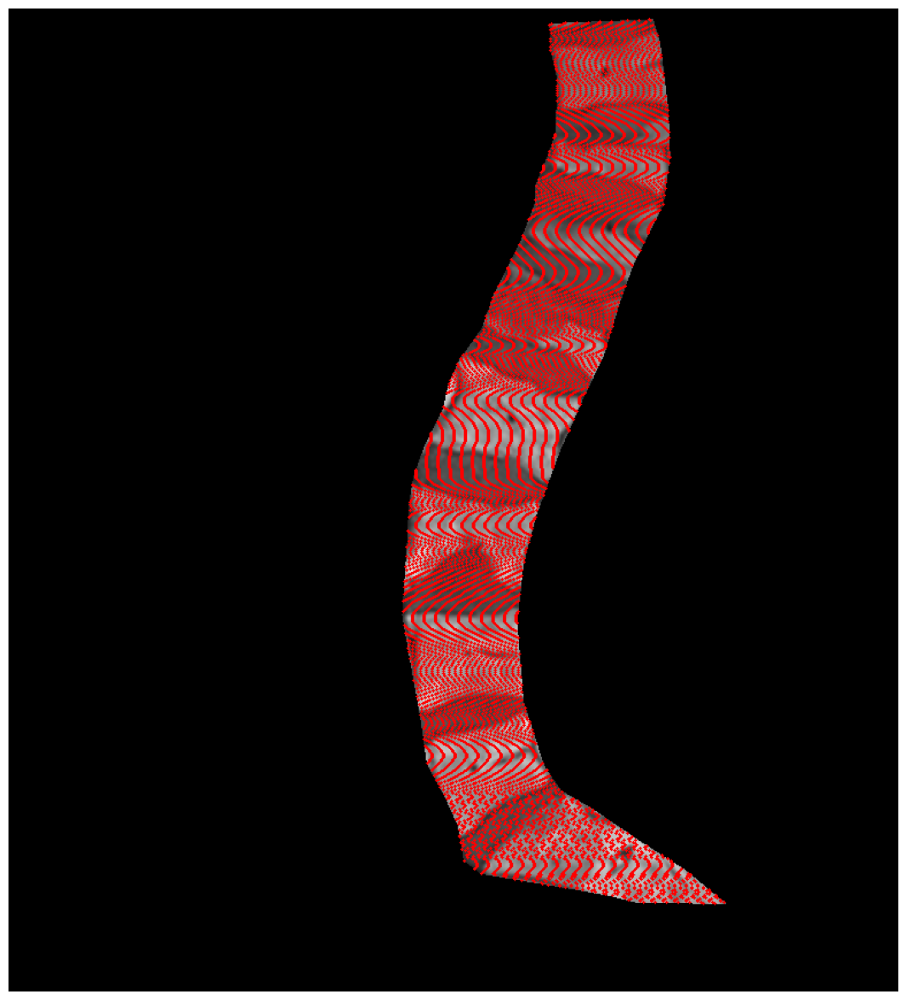

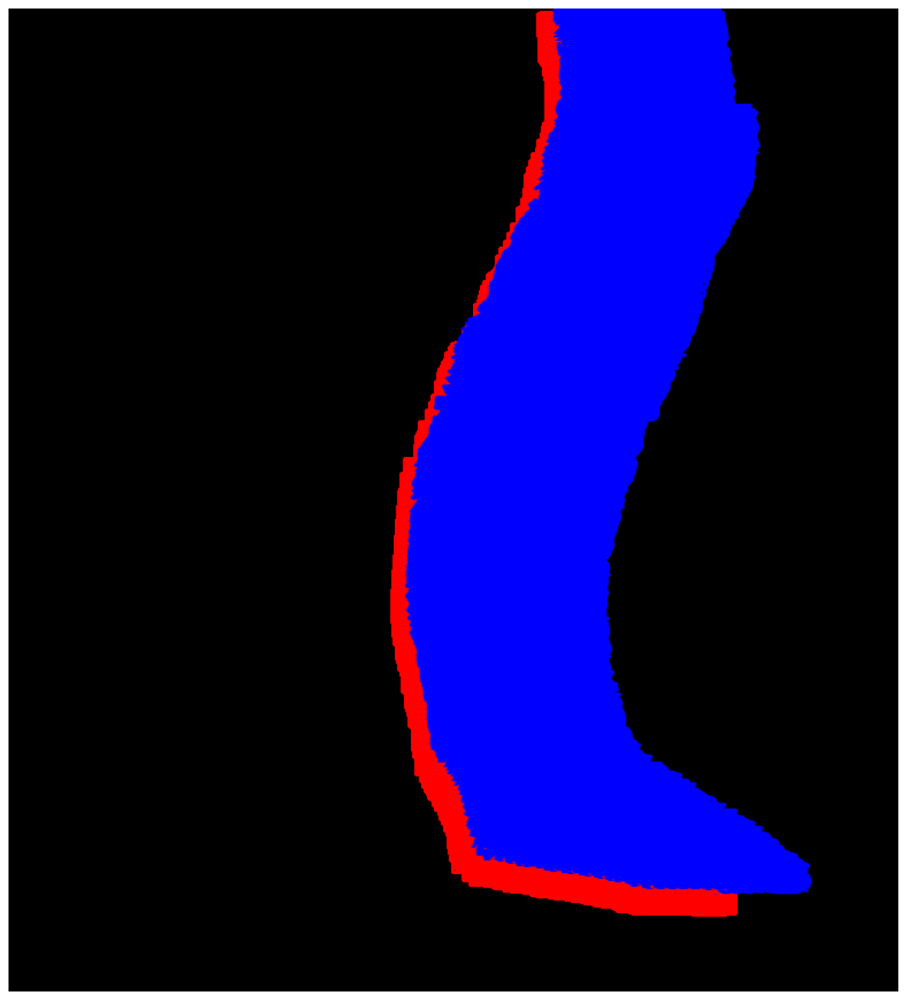

Image 1: Tespit edilen nokta sayısı: 8515
Image 1: Çıkarılan patch sayısı: 8514


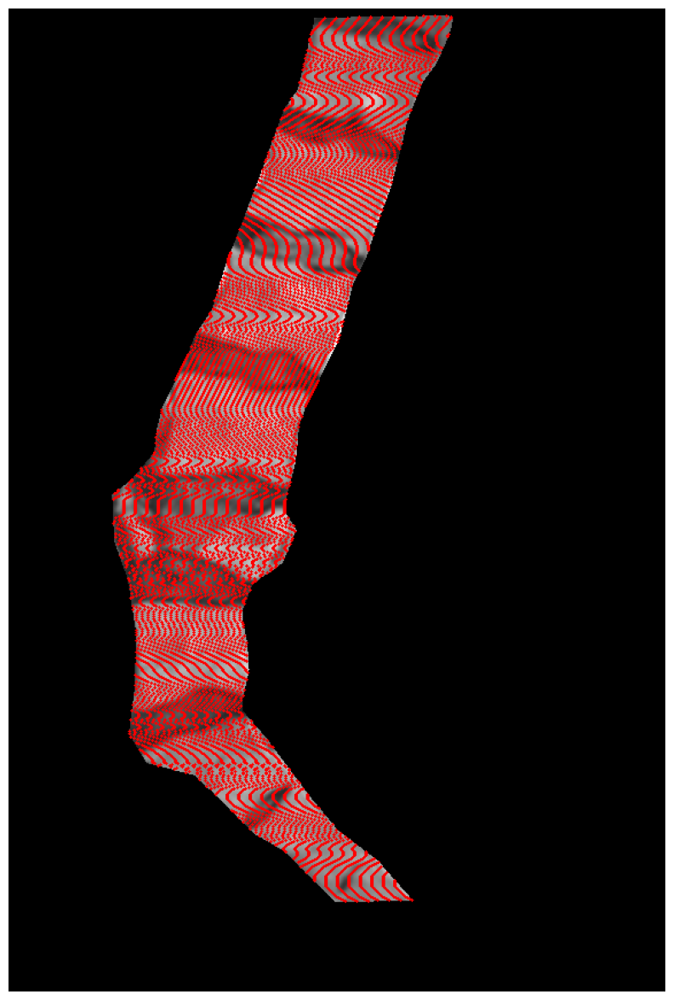

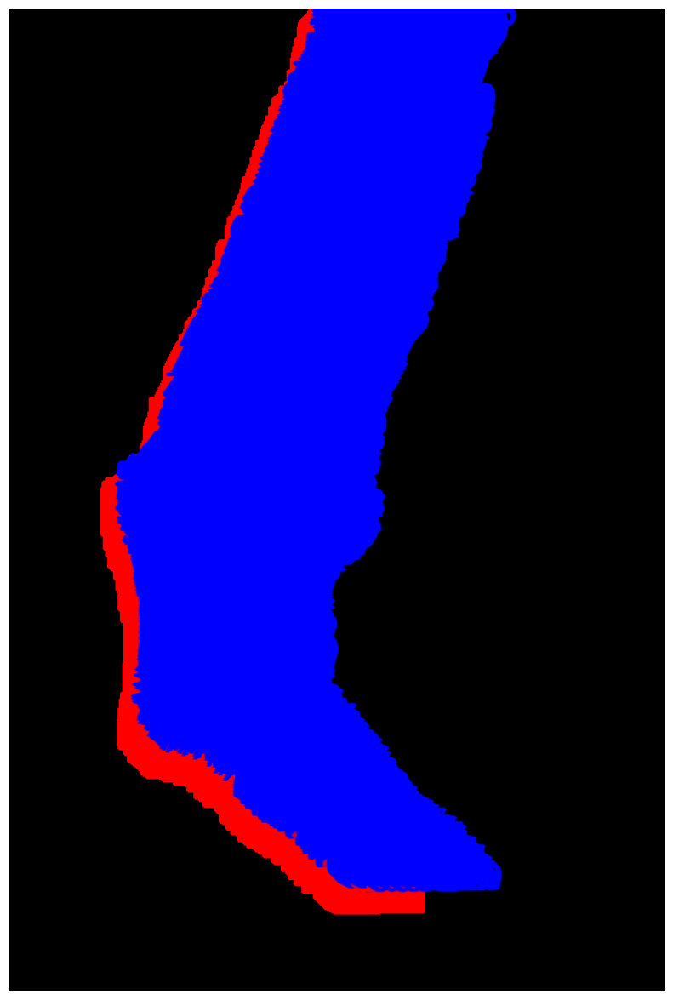

Image 2: Tespit edilen nokta sayısı: 8669
Image 2: Çıkarılan patch sayısı: 8633


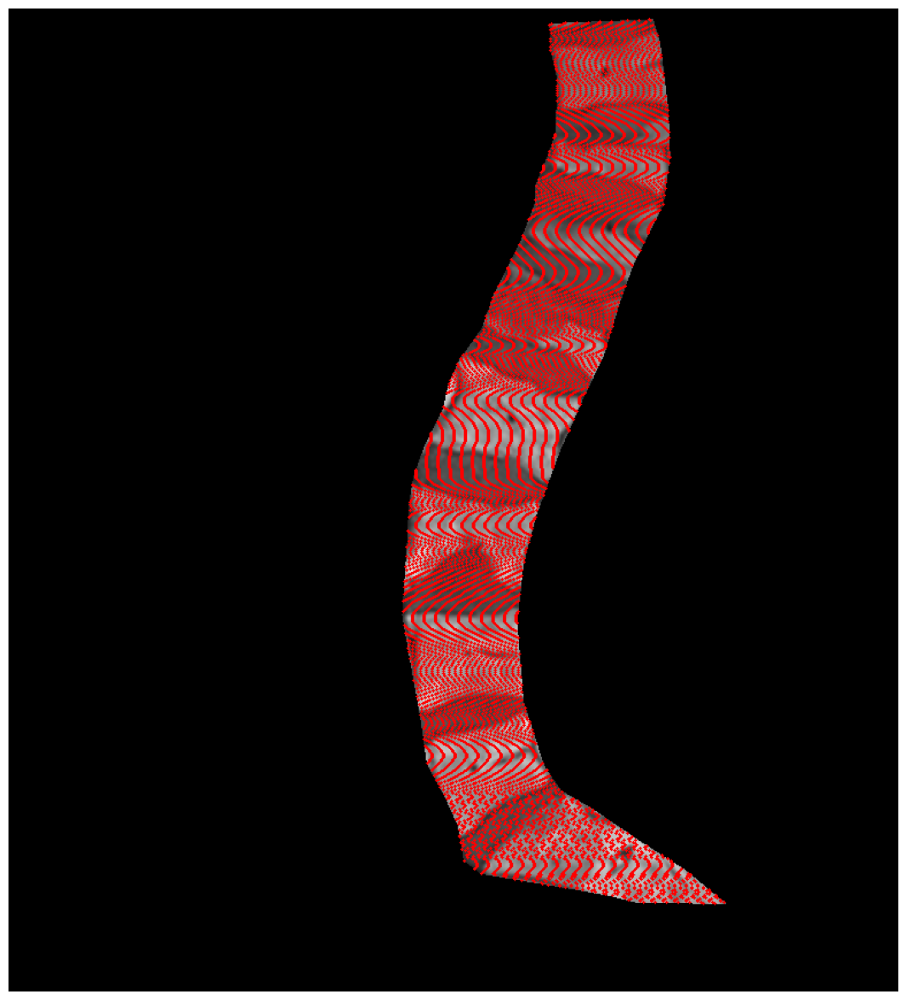

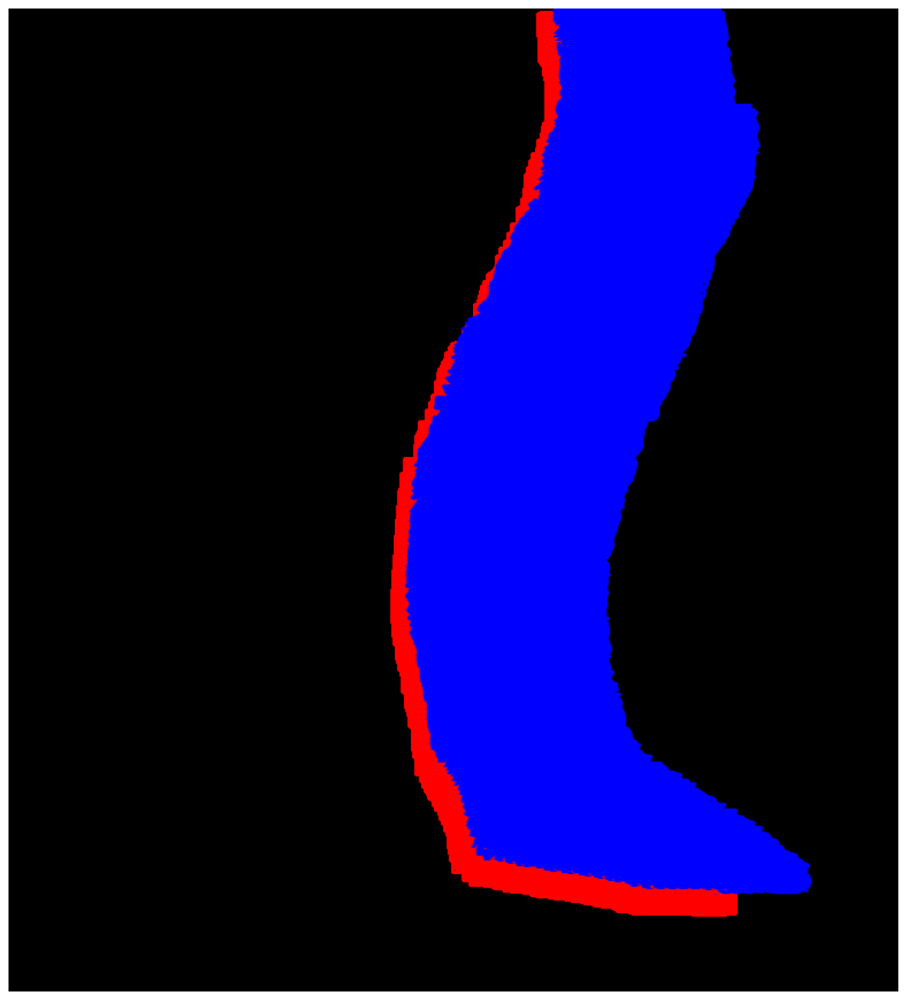

Image 3: Tespit edilen nokta sayısı: 8515
Image 3: Çıkarılan patch sayısı: 8514


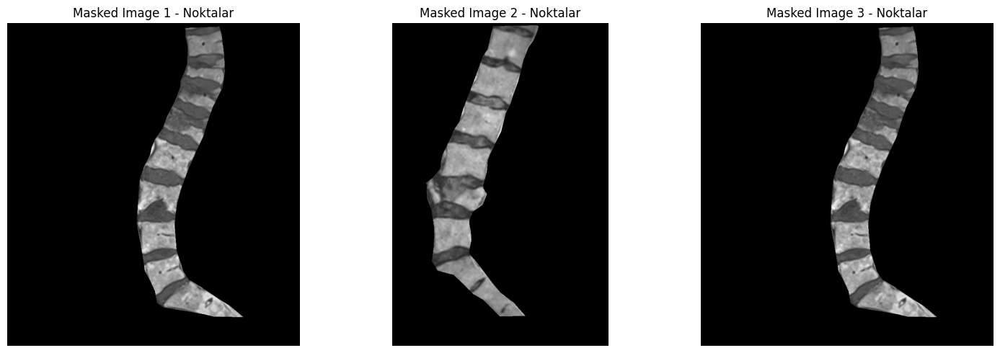

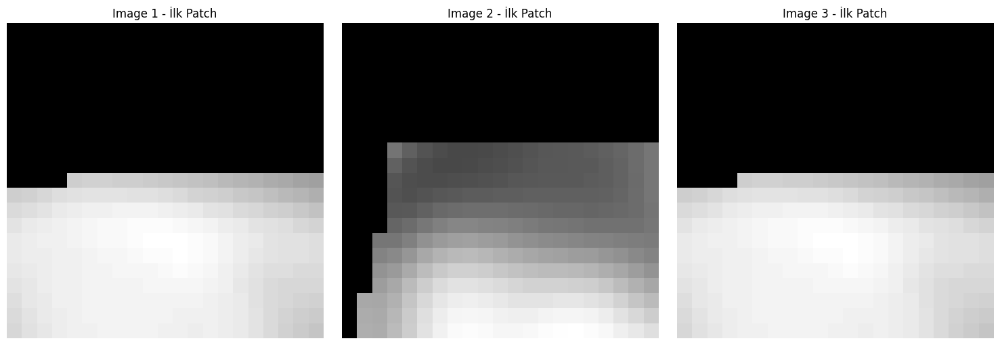

In [71]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Siyah olmayan pikselleri tespit eden fonksiyon
def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    """
    Siyah olmayan pikselleri tespit eder ve isteğe bağlı olarak görüntüde işaretler.
    """
    # Siyah olmayan piksellerin koordinatlarını tespit et
    y, x = np.where(img > 0)
    pixels = np.vstack((y, x)).T  # (y, x) koordinatlarını birleştir

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]

    # Çizim yapılacaksa noktaları görüntü üzerinde işaretle
    if draw:
        Drawing(img, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# Siyah olmayan pikseller etrafında patch çıkaran fonksiyon
def GetPatchsFromNonBlackPixels(img, NonBlackPixels, PatchSize=11, draw=True):
    """
    Siyah olmayan pikseller etrafında belirtilen boyutta yama (patch) çıkarır.
    """
    Patchs = []
    PatchsInfo = []
    rows, cols = img.shape

    for y, x in NonBlackPixels:
        # Yama sınırlarını kontrol et ve yama al
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Yama sınırların dışındaysa atla
            continue

        Patch = img[y_start:y_end, x_start:x_end]
        Patchs.append(Patch)
        PatchsInfo.append((x, y, PatchSize))

    # Yamaları görselleştir
    if draw:
        Drawing(img, EdgePoints=NonBlackPixels, EdgePatchs=PatchsInfo)

    return Patchs, PatchsInfo

# Görseller ve başlıklar
masked_images = [masked_image, masked_image2, masked_image3]
image_titles = ["Masked Image 1", "Masked Image 2", "Masked Image 3"]

# Her bir görüntü için işaretlenmiş noktalar ve patch'leri saklama
points = []
patches = []
patches_info = []

# Görselleri işle
for i, masked_image in enumerate(masked_images):
    # Siyah olmayan noktaları tespit et
    img_points = GetNonBlackPixels(masked_image, sparsity_factor=10, circle_radius=1, draw=True)
    points.append(img_points)

    # Patch'leri çıkar
    img_patches, img_patch_info = GetPatchsFromNonBlackPixels(masked_image, img_points, PatchSize=10, draw=True)
    patches.append(img_patches)
    patches_info.append(img_patch_info)

    print(f"Image {i + 1}: Tespit edilen nokta sayısı: {len(img_points)}")
    print(f"Image {i + 1}: Çıkarılan patch sayısı: {len(img_patches)}")

# Noktaları görselleştirme
plt.figure(figsize=(15, 5))
for i, (masked_image, title) in enumerate(zip(masked_images, image_titles)):
    plt.subplot(1, 3, i + 1)
    plt.imshow(masked_image, cmap='gray')
    plt.title(f"{title} - Noktalar")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Patch'leri görselleştirme
plt.figure(figsize=(15, 5))
for i, img_patches in enumerate(patches):
    if img_patches:  # Eğer en az bir patch varsa
        patch = img_patches[0]  # İlk yamayı seç

        # Görselleştirme için yamayı normalize et
        if patch.dtype != np.uint8:
            patch = (patch - patch.min()) / (patch.max() - patch.min())  # [0, 1] aralığına normalizasyon

        plt.subplot(1, 3, i + 1)
        plt.imshow(patch, cmap='gray')
        plt.title(f"Image {i + 1} - İlk Patch")
        plt.axis('off')

plt.tight_layout()
plt.show()


# Kod Özeti

Bu kod, verilen yamaları (patch'leri) bir grid düzeninde görselleştirir. Kullanıcı, belirli bir maksimum patch sayısı ve sütun sayısı belirleyerek bu yamaların görselini oluşturabilir.

---

### Adımlar:

1. **Patch'leri Görselleştirme**:
   - `DisplayPatches` fonksiyonu, verilen yamaları bir grid düzeninde görüntüler.
   - Görüntüler belirli bir maksimum patch sayısına ve sütun sayısına göre düzenlenir.

2. **Grid Düzeni**:
   - Kullanıcı, `max_cols` parametresiyle grid'deki maksimum sütun sayısını ve `max_patches` parametresiyle görselleştirilecek en fazla patch sayısını belirler.
   - Grid düzeni hesaplanarak, her bir patch belirli hücrelere yerleştirilir.

3. **Görselleştirme**:
   - Her bir patch, grid üzerindeki hücrelere yerleştirilir ve her patch'in üzerine bir numara eklenir.
   - Fazla olan hücreler kapatılır ve eksen etiketleri gizlenir.

4. **Örnek Kullanım**:
   - Kod, örnek olarak üç farklı görüntüden çıkarılan yamaların (patch'lerin) görselleştirilmesini sağlar.
   - Her bir görüntüdeki patch sayısı yazdırılır ve ardından `DisplayPatches` fonksiyonu çağrılarak görselleştirilir.

### İşlemler:
- **Patch Görselleştirme**: Her bir yama (patch) grid düzeninde görselleştirilir ve üzerine numara eklenir.
- **Grid Düzeni**: Belirtilen maksimum sütun ve patch sayısına göre, yamalar grid üzerinde yerleştirilir.

### Çıktılar:
- Görselleştirilen patch'ler ve her bir görüntü için toplam patch sayısı yazdırılır.


Image 1: Toplam Patch Sayısı = 2827


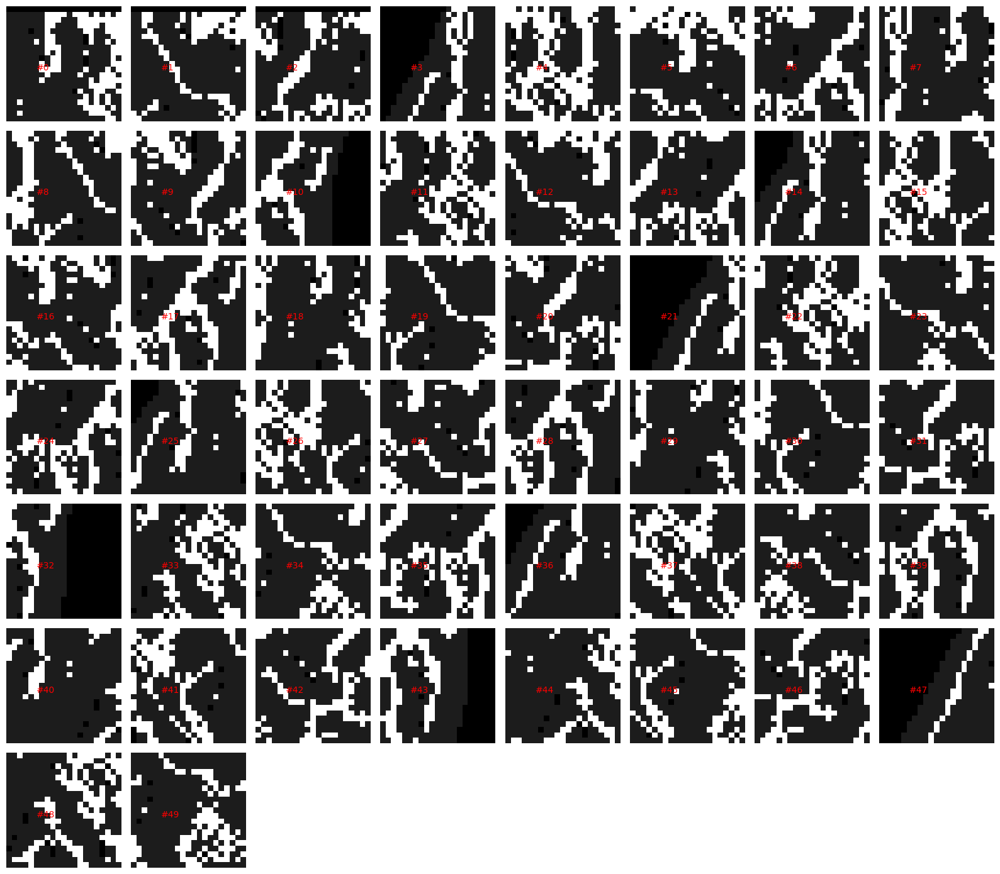

Image 2: Toplam Patch Sayısı = 2589


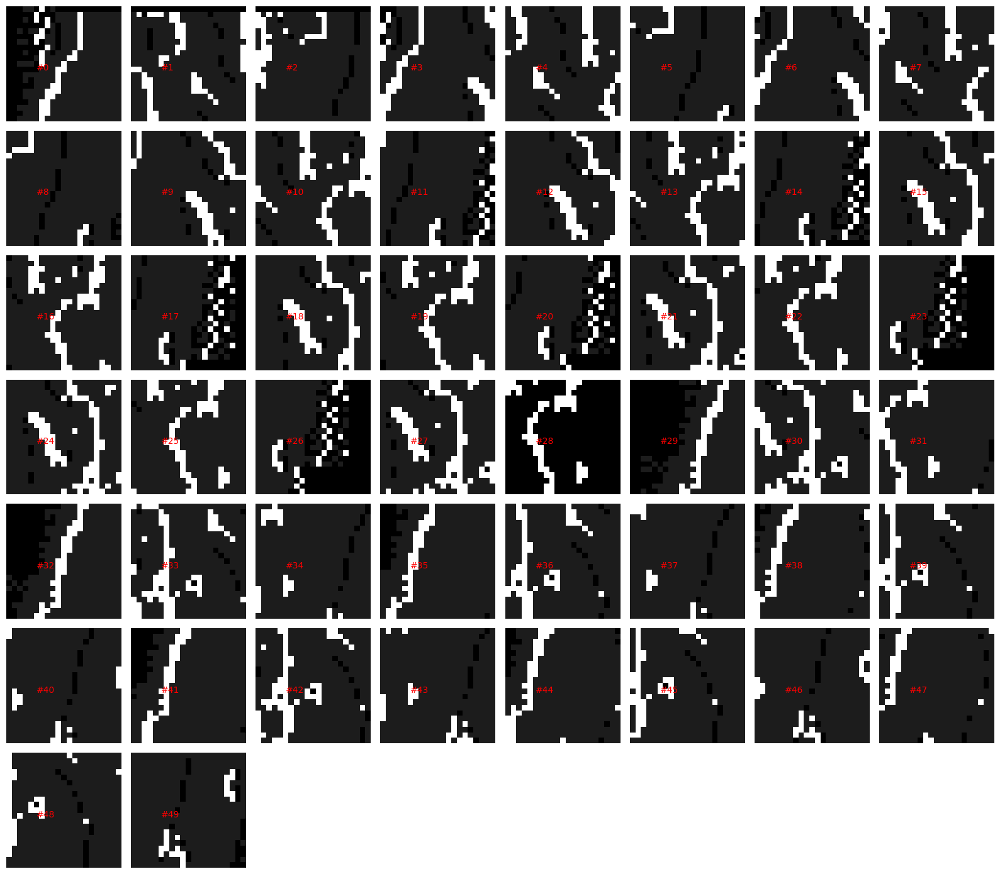

Image 3: Toplam Patch Sayısı = 1546


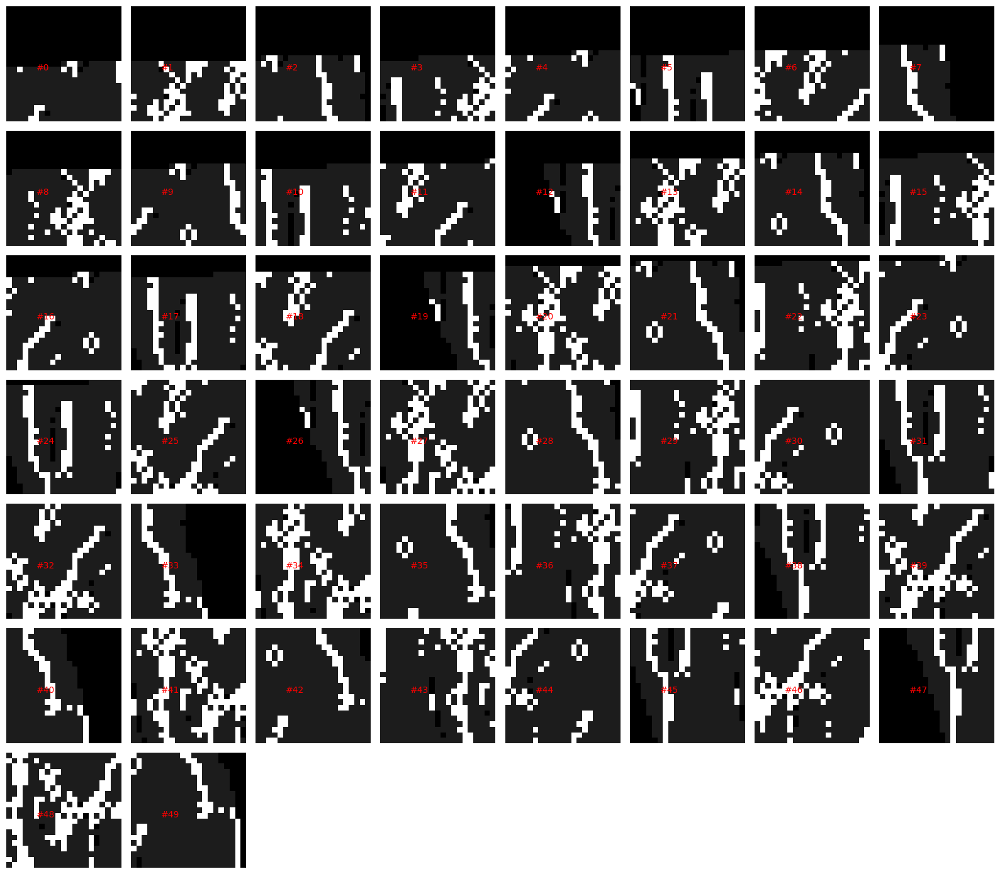

In [72]:
import math
import numpy as np
import matplotlib.pyplot as plt

def DisplayPatches(EdgePatchs, max_cols=10, max_patches=100):
    """
    Belirtilen patch'leri (yamaları) bir grid düzeninde görselleştirir.
    
    Args:
        EdgePatchs (list): Görselleştirilecek patch'lerin listesi.
        max_cols (int): Grid'deki maksimum sütun sayısı.
        max_patches (int): Görselleştirilecek maksimum patch sayısı.
    """
    # Gösterilecek toplam patch sayısını belirle
    num_patches = min(len(EdgePatchs), max_patches)
    
    # Grid düzeni için sütun ve satır sayısını hesapla
    cols = min(max_cols, num_patches)
    rows = math.ceil(num_patches / cols)
    
    # Görsel grid'i oluştur
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)  # Tüm eksenleri tek boyutlu bir diziye dönüştür

    # Patch'leri grid üzerinde yerleştir
    for i, ax in enumerate(axes):
        if i < num_patches:
            # Mevcut patch'i grid'deki bir hücreye yerleştir
            ax.imshow(EdgePatchs[i], cmap='gray')
            ax.text(5, 10, f"#{i}", color='red', fontsize=10, ha='left', va='top')
            ax.axis('off')  # Eksen etiketlerini gizle
        else:
            # Fazla hücreleri kapat
            ax.axis('off')

    # Layout'u optimize et ve görselleştir
    plt.tight_layout()
    plt.show()

# Örnek kullanım
# img_Patchs1, img_Patchs2, img_Patchs3 bir önceki yamaların listeleridir.
# Bu yamaları görselleştirmek için aşağıdaki şekilde kullanabilirsiniz:

# Her bir görüntünün patch'lerini görselleştir
for i, img_Patchs in enumerate([img_Patchs1, img_Patchs2, img_Patchs3]):
    print(f"Image {i + 1}: Toplam Patch Sayısı = {len(img_Patchs)}")
    DisplayPatches(img_Patchs, max_cols=8, max_patches=50)  # Sütunları ve maksimum patch sayısını ayarla


# Kod Özeti

Bu kod, verilen görüntülerden çıkarılan patch'lere (yamalara) HOG (Histogram of Oriented Gradients) özelliklerini hesaplar ve bu özellikleri koordinat bilgileriyle birlikte kaydeder. Ayrıca, her bir patch için HOG özelliklerini çıkardıktan sonra bunları bir dosyaya kaydeder.

---

### Adımlar:

1. **HOG Özellikleri Hesaplama**:
   - `compute_hog_features` fonksiyonu, verilen bir görüntüden HOG özelliklerini hesaplar.
   - Görüntü gri tonlamalıya dönüştürülür ve uygun HOG parametreleri ile HOGDescriptor kullanılarak özellikler çıkarılır.
   - Çıkan özellikler tek boyutlu bir vektöre dönüştürülür.

2. **Patch'lerden HOG Özelliklerini Hesaplama**:
   - `save_hog_features_with_coords` fonksiyonu, verilen patch'lerden HOG özelliklerini çıkarır ve her bir patch'in koordinatları ile birlikte bu özellikleri kaydeder.
   - Her bir patch için HOG özellikleri hesaplanır ve koordinat bilgileriyle birlikte bir dosyaya kaydedilir.

3. **Patch Çıkarma**:
   - Her bir görüntü için `GetPatchsFromNonBlackPixels` fonksiyonu kullanılarak siyah olmayan piksellerin etrafında yamalar (patch'ler) çıkarılır.
   - Tüm görüntüler için çıkarılan patch'ler ve bunların koordinat bilgileri birleştirilir.

4. **HOG Özelliklerinin Kaydedilmesi**:
   - Hesaplanan tüm HOG özellikleri ve koordinatlar belirtilen dosya yoluna `.npz` formatında kaydedilir.
   - Kaydedilen dosya, özelliklerin ve koordinatların numpy dizileri olarak saklanmasını sağlar.

5. **Çıktılar**:
   - İşlem tamamlandıktan sonra, toplam işlenen patch sayısı ve kaydedilen dosya yolu konsola yazdırılır.

---

### Kullanım:

- Görsellerden çıkarılan patch'ler üzerinde HOG özellikleri hesaplanarak `hog_features_with_coords.npz` dosyasına kaydedilir.
- Kullanıcı, çıkartılan yamaları ve bunların özelliklerini farklı görsellerle çalışarak analiz edebilir.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


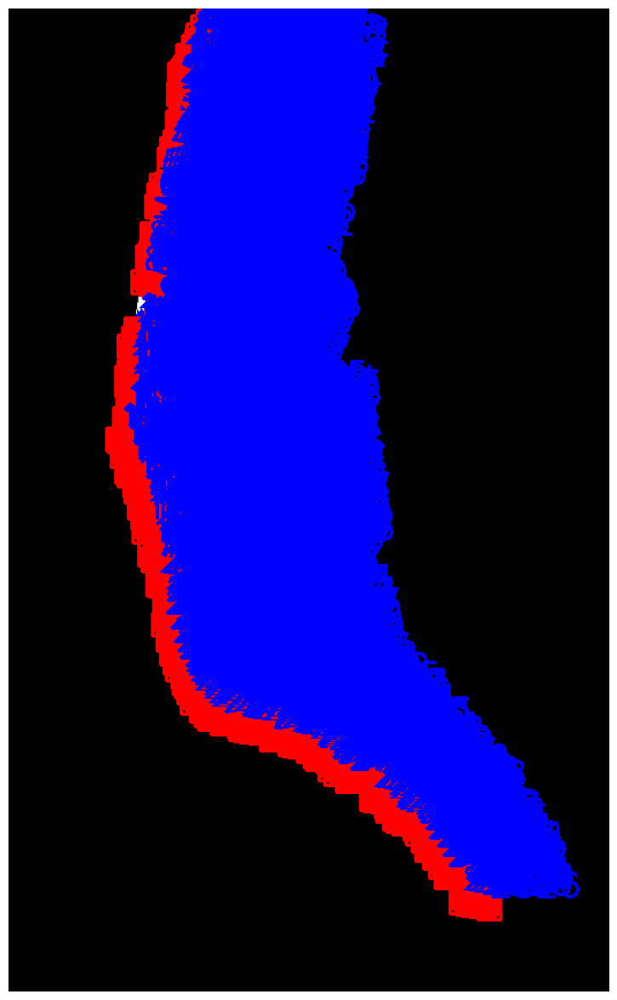

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


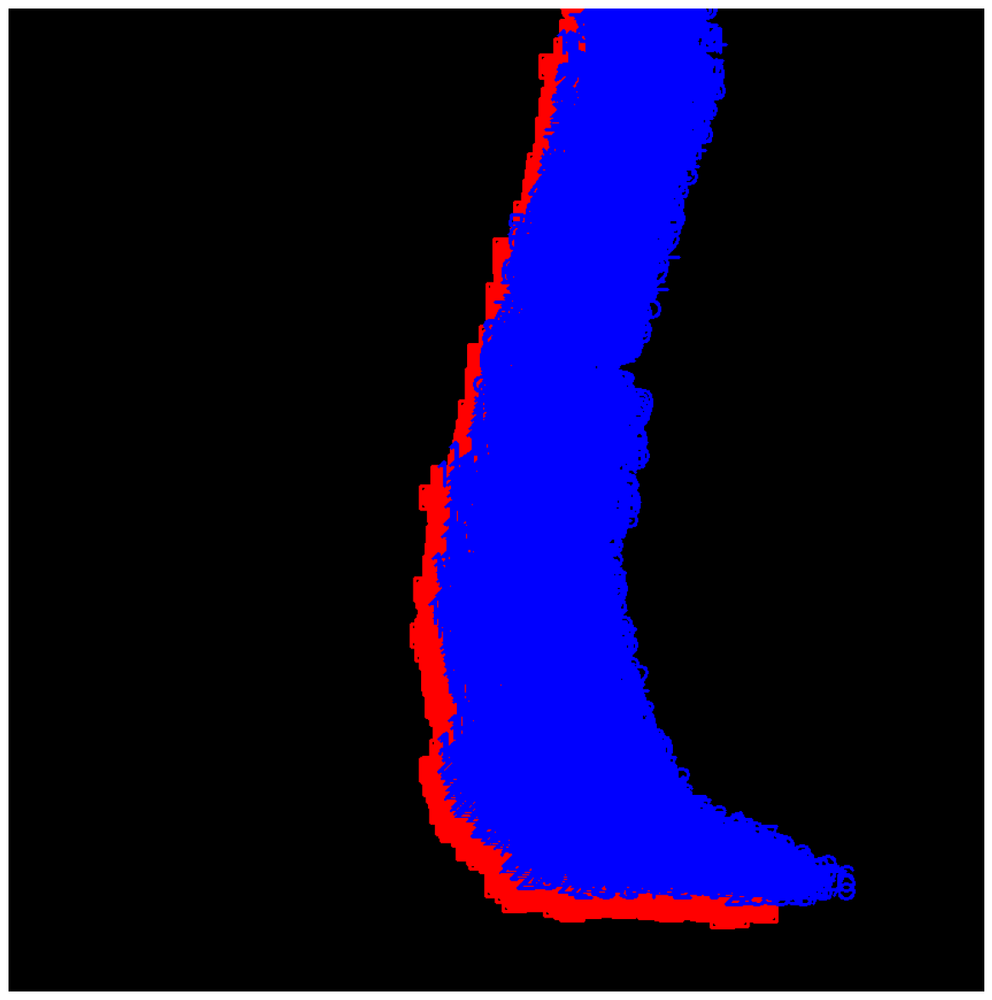

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


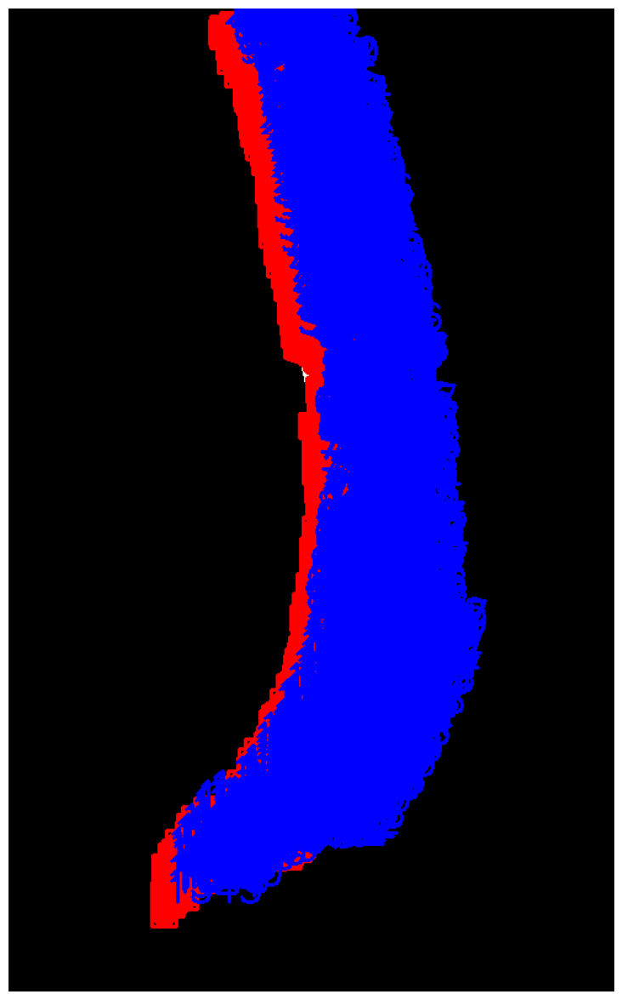

HOG özellikleri ve koordinatlar kaydedildi: ./DB/output/hog_features_with_coords.npz
Toplam 6962 patch HOG ile kodlandı.


In [73]:
import os
import cv2
import numpy as np

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen bir görüntüden HOG (Histogram of Oriented Gradients) özelliklerini hesaplar.

    Args:
        image (numpy.ndarray): Giriş görüntüsü.
        cell_size (tuple): HOG hücre boyutu.
        block_size (tuple): HOG blok boyutu.
        nbins (int): Histogramın yön sayısı (bins).

    Returns:
        numpy.ndarray: Düzleştirilmiş HOG özellik vektörü.
    """
    # Eğer görüntü RGB ise gri tonlamalıya dönüştür
    if image.ndim == 3:  
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Görüntünün veri türü uint8 değilse normalize ederek uint8'e dönüştür
    if image.dtype != np.uint8:
        image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # HOGDescriptor parametrelerini belirle
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    
    # HOG özelliklerini hesapla
    features = hog.compute(image)
    return features.flatten()  # Özellikleri düzleştirerek tek boyutlu diziye dönüştür


# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen patch'lerden HOG özelliklerini hesaplar ve koordinatları ile birlikte kaydeder.

    Args:
        patches (list): Görüntü patch'lerinin listesi.
        patch_info (list): Her bir patch için koordinat bilgisi.
        output_path (str): HOG özelliklerinin kaydedileceği dosya yolu.
        cell_size (tuple): HOG hücre boyutu.
        block_size (tuple): HOG blok boyutu.
        nbins (int): Histogramın yön sayısı (bins).
    """
    all_features = []
    all_coords = []

    # Her bir patch ve koordinat bilgisi üzerinde işlem yap
    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        # Her patch için HOG özelliklerini hesapla
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)  # HOG özelliklerini listeye ekle
        all_coords.append(info)  # Koordinat bilgilerini listeye ekle

    # Liste halinde olan özellikleri ve koordinatları numpy dizilerine dönüştür
    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    # Çıktı klasörünü oluştur (mevcut değilse oluşturulur)
    os.makedirs(os.path.dirname(output_path), exist_ok=True)

    # Özellikleri ve koordinatları dosyaya kaydet
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")


# Patch çıkarma ve HOG özelliklerini hesaplama
# İlk görsel için patch'leri çıkar
img_Patchs1, img_PatchsInfo1 = GetPatchsFromNonBlackPixels(point_masked_images1, img_Points1, PatchSize=10, draw=True)

# İkinci görsel için patch'leri çıkar
img_Patchs2, img_PatchsInfo2 = GetPatchsFromNonBlackPixels(point_masked_images2, img_Points2, PatchSize=10, draw=True)

# Üçüncü görsel için patch'leri çıkar
img_Patchs3, img_PatchsInfo3 = GetPatchsFromNonBlackPixels(point_masked_images3, img_Points3, PatchSize=10, draw=True)

# Tüm patch'leri ve koordinat bilgilerini birleştir
all_patches = img_Patchs1 + img_Patchs2 + img_Patchs3
all_patch_info = img_PatchsInfo1 + img_PatchsInfo2 + img_PatchsInfo3

# HOG özelliklerini hesaplayıp dosyaya kaydet
output_file_with_coords = "./DB/output/hog_features_with_coords.npz"
save_hog_features_with_coords(all_patches, all_patch_info, output_file_with_coords)

# Toplam işlenen patch sayısını konsola yazdır
print(f"Toplam {len(all_patches)} patch HOG ile kodlandı.")


# Kod Özeti

Bu kod, görüntüleri ve etiketleri yükler, görüntüler üzerinde çeşitli ön işleme adımları (piksel normalizasyonu, ortalama filtreleme ve parlaklık artırma) uygular ve sonuçları görselleştirir. Her bir işlenmiş görüntü ve etiket çiftini görselleştirir ve işlenen görüntülerin boyutlarını yazdırır.

---

### Adımlar:

1. **Görüntü ve Etiket Yükleme**:
   - `GetImageLabel` fonksiyonu, belirtilen dosya yollarından gri tonlamalı görüntüleri ve etiketleri yükler. 
   - Yüklenen görüntü ve etiketler isteğe bağlı olarak görselleştirilir.

2. **Ortalama Filtreleme**:
   - `mean_filter` fonksiyonu, görüntüye ortalama filtre uygular.
   - Bu işlem, görüntüdeki gürültüyü azaltmaya yardımcı olur.

3. **Görüntü İşleme**:
   - `process_image` fonksiyonu, bir görüntü üzerinde üç işlem yapar:
     1. **Piksel Normalizasyonu**: Görüntüdeki piksellerin değerlerini normalize eder.
     2. **Ortalama Filtreleme**: Gürültüyü azaltmak için ortalama filtre uygular.
     3. **Parlaklık Artırma**: Görüntünün parlaklığını artırır.
   - Her bir işlem sonucu işlenmiş görüntü ve etiket döndürülür.

4. **Görüntülerin Görselleştirilmesi**:
   - Her bir işlenmiş görüntü ve ilgili etiket yan yana görselleştirilir.
   - Görsellerin başlıkları ve eksenleri uygun şekilde ayarlanır.

5. **İşlenen Görüntülerin Boyutları**:
   - İşlenmiş her bir görüntünün boyutları (shape) yazdırılır.

---

### Kullanım:

- **Görüntü ve etiketler**: Görseller ve etiketler, belirtilen dosya yollarından yüklenir.
- **İşleme**: Yüklenen her bir görüntü, normalizasyon, ortalama filtreleme ve parlaklık artırma işlemleri ile işlenir.
- **Görselleştirme**: Her bir işlenmiş görüntü ve etiket görselleştirilir ve ekrana sunulur.
- **Boyutlar**: İşlenmiş görüntülerin boyutları konsola yazdırılır.

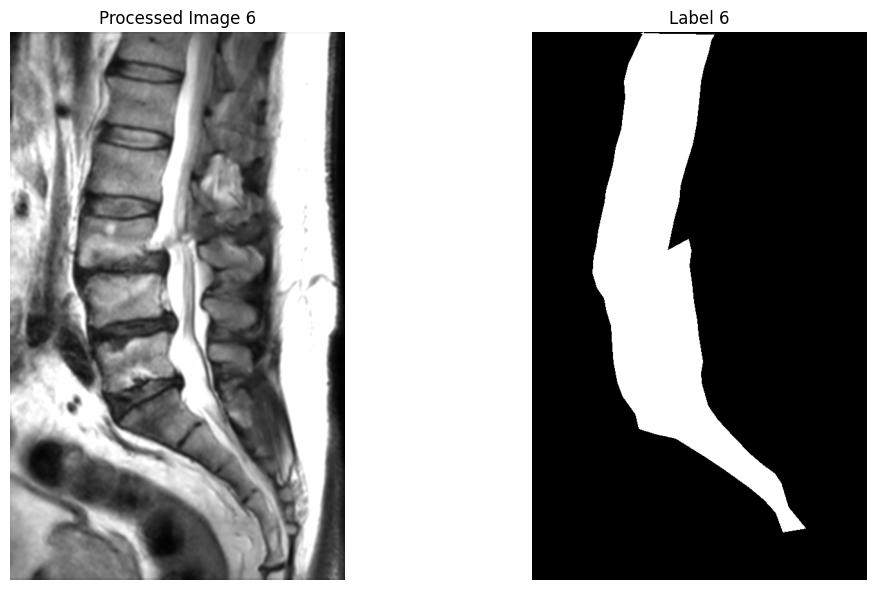

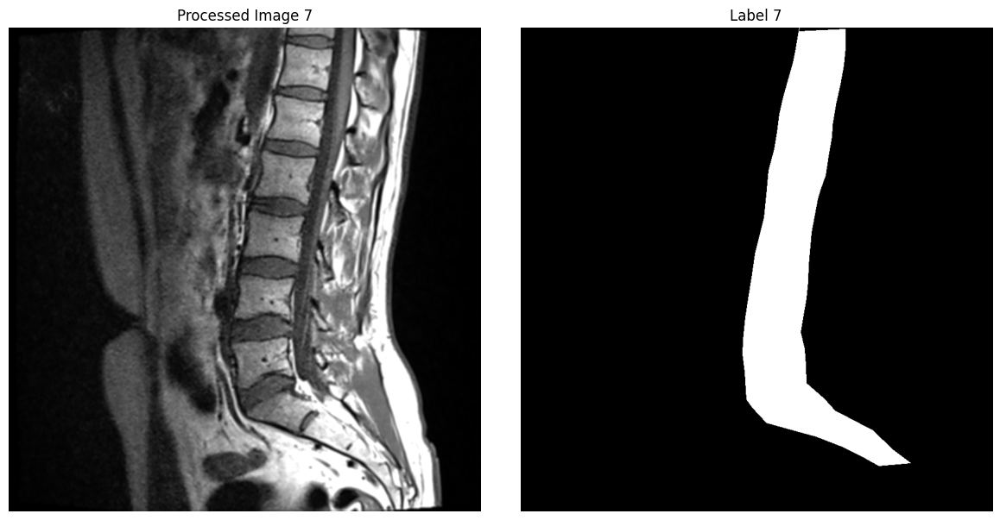

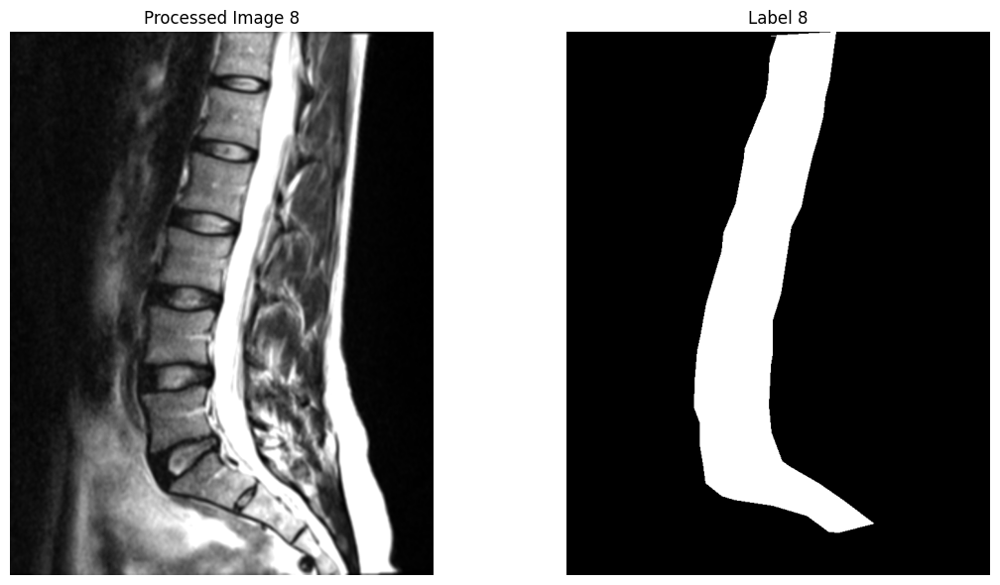

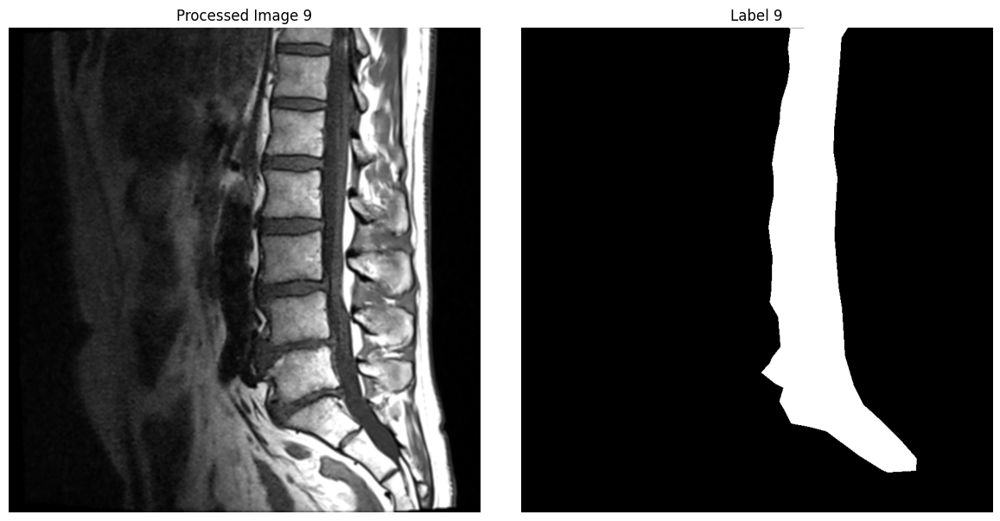

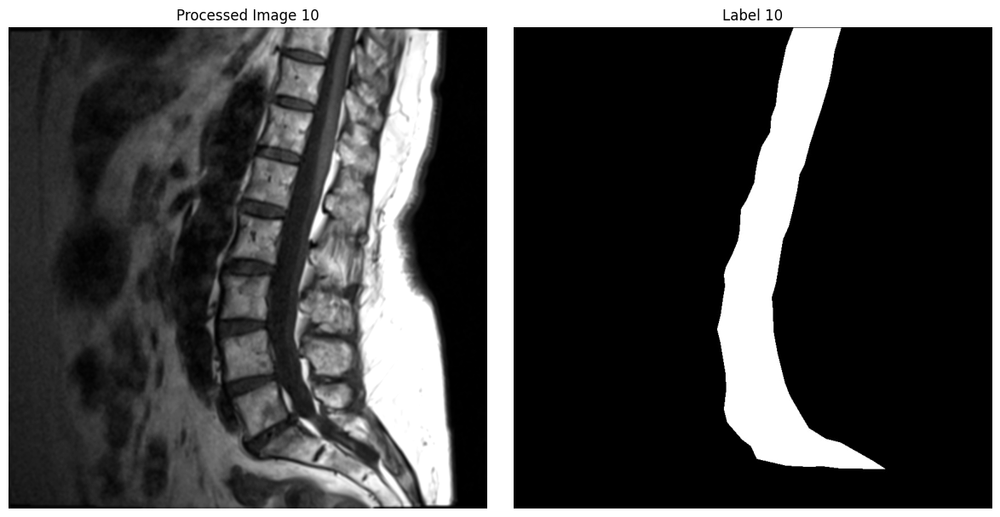

Processed Image 6 Shape: (853, 521)
Processed Image 7 Shape: (856, 833)
Processed Image 8 Shape: (848, 661)
Processed Image 9 Shape: (852, 828)
Processed Image 10 Shape: (855, 849)


In [4]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntü ve etiketleri yükleyen fonksiyon
def GetImageLabel(imgStr, labelStr, draw=False):
    """
    Verilen dosya yollarından görüntü ve etiketi yükler, isteğe bağlı olarak görselleştirir.

    Args:
        imgStr (str): Görüntü dosya yolu.
        labelStr (str): Etiket dosya yolu.
        draw (bool): Görselleştirme yapılıp yapılmayacağını belirtir.

    Returns:
        tuple: (img, label) Görüntü ve etiket verilerini döndürür.
    """
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title("Image")
        plt.axis('off')
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title("Label")
        plt.axis('off')
        plt.tight_layout()
        plt.show()
    return img, label

# Ortalama filtreleme fonksiyonu
def mean_filter(image, kernel_size=5):
    """
    Ortalama filtre uygular.

    Args:
        image (numpy.ndarray): Giriş görüntüsü.
        kernel_size (int): Çekirdek boyutu.

    Returns:
        numpy.ndarray: Filtrelenmiş görüntü.
    """
    return cv2.blur(image, (kernel_size, kernel_size))

# Görüntüleri işleyen fonksiyon
def process_image(image_path, label_path, brightness_increase=20):
    """
    Görüntüyü işler ve etiketi döndürür.

    Args:
        image_path (str): Görüntü dosya yolu.
        label_path (str): Etiket dosya yolu.
        brightness_increase (int): Parlaklık artırma miktarı.

    Returns:
        tuple: İşlenmiş görüntü ve etiket.
    """
    img, label = GetImageLabel(image_path, label_path, draw=False)

    # 1. Piksel normalizasyonu
    normalized_image = (img / 255.0 * 255).astype(np.uint8)

    # 2. Ortalama filtreleme
    mean_filtered = mean_filter(normalized_image, kernel_size=5)

    # 3. Parlaklık artırma
    brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

    return brightened_image, label

# Görüntü dosyalarının yolları
image_paths = [
    r"./DB/images/img (6).png",
    r"./DB/images/img (7).png",
    r"./DB/images/img (8).png",
    r"./DB/images/img (9).png",
    r"./DB/images/img (10).png"
]

# Etiket dosyalarının yolları
label_paths = [
    r"./DB/labels/label (6).png",
    r"./DB/labels/label (7).png",
    r"./DB/labels/label (8).png",
    r"./DB/labels/label (9).png",
    r"./DB/labels/label (10).png"
]

# İşlenmiş görüntüleri ve etiketleri saklamak için listeler
brightened_images = []
labels = []

# Görüntüleri işleme ve görselleştirme
for i, (image_path, label_path) in enumerate(zip(image_paths, label_paths)):
    brightened_image, label = process_image(image_path, label_path)
    brightened_images.append(brightened_image)
    labels.append(label)

    # Görselleştirme
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(brightened_image, cmap='gray')
    plt.title(f"Processed Image {i+6}")
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(label, cmap='gray')
    plt.title(f"Label {i+6}")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# İşlenen görüntülerin boyutlarını yazdır
for i, brightened_image in enumerate(brightened_images):
    print(f"Processed Image {i+6} Shape: {brightened_image.shape}")


# Kod Özeti

Bu kod, işlenmiş görüntüler üzerinde siyah olmayan pikselleri tespit eder ve bu noktaları kırmızı dairelerle işaretleyerek görselleştirir. Her bir işlenmiş görüntüdeki siyah olmayan piksellerin sayısını ekrana yazdırır.

---

### Adımlar:

1. **Çizim Fonksiyonu (`Drawing`)**:
   - `Drawing` fonksiyonu, verilen bir görüntü üzerinde belirtilen noktaların (piksel koordinatları) etrafında kırmızı daireler çizer.
   - Her bir nokta, belirli bir `circle_radius` değeriyle işaretlenir.

2. **Siyah Olmayan Pikselleri Bulma (`GetNonBlackPixels`)**:
   - Görüntü, üst ve alt yarılara ayrılır.
   - Her iki yarıda, siyah olmayan piksellerin koordinatları (`> 60` değeri) tespit edilir.
   - Bu pikseller, hem üst hem de alt yarıdan birleştirilir ve seyrekleştirilir (isteğe bağlı olarak).
   - Eğer `draw=True` ise, tespit edilen pikseller `Drawing` fonksiyonu ile işaretlenir.

3. **Siyah Olmayan Piksellerin İşaretlenmesi ve Görselleştirilmesi**:
   - `brightened_images` üzerinde her bir görüntü için `GetNonBlackPixels` fonksiyonu çağrılır.
   - Siyah olmayan piksellerin sayısı yazdırılır ve işaretlenmiş görüntü görselleştirilir.

---

### Kullanım:

- **Görüntü İşleme**: Her bir işlenmiş görüntüdeki siyah olmayan piksellerin koordinatları tespit edilir.
- **Görselleştirme**: Tespit edilen siyah olmayan pikseller, kırmızı dairelerle işaretlenir ve görselleştirilir.
- **Boyut Bilgisi**: Her bir işlenmiş görüntüde tespit edilen siyah olmayan piksellerin sayısı ekrana yazdırılır.

Processing Image 6...


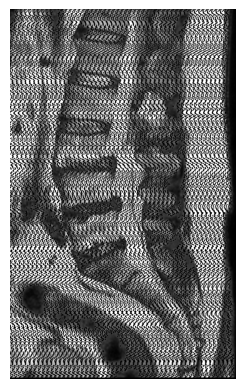

Image 6 için tespit edilen nokta sayısı: 39799
Processing Image 7...


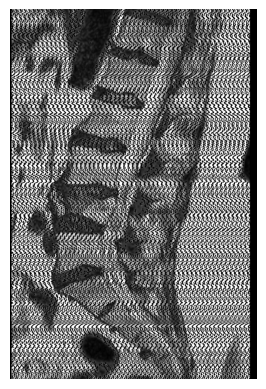

Image 7 için tespit edilen nokta sayısı: 43084
Processing Image 8...


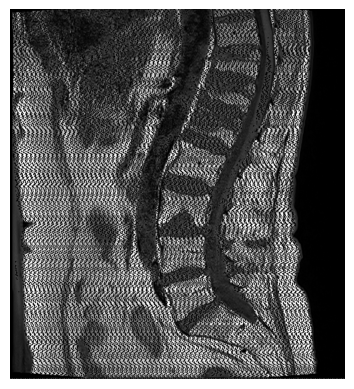

Image 8 için tespit edilen nokta sayısı: 44452
Processing Image 9...


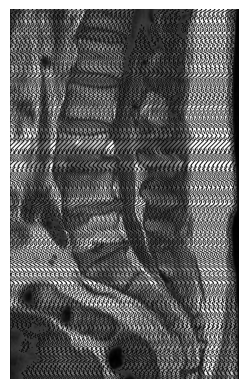

Image 9 için tespit edilen nokta sayısı: 41271
Processing Image 10...


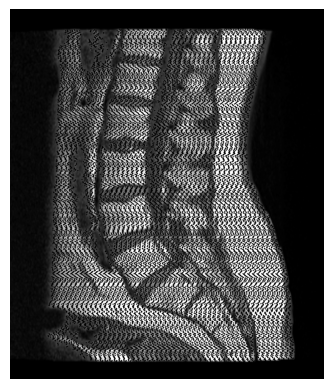

Image 10 için tespit edilen nokta sayısı: 29210


In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Noktaları işaretlemek için kullanılan çizim fonksiyonu
def Drawing(img, EdgePoints, circle_radius=10):
    """
    Görüntü üzerinde belirtilen noktalara kırmızı daireler çizer ve sonucu görselleştirir.

    Args:
        img (numpy.ndarray): Gri tonlamalı giriş görüntüsü.
        EdgePoints (numpy.ndarray): İşaretlenecek noktaların koordinatları.
        circle_radius (int): Daire yarıçapı.

    Returns:
        None
    """
    # Görüntünün bir kopyasını oluştur
    img_copy = img.copy()

    # Her bir nokta için kırmızı daire çiz
    for point in EdgePoints:
        cv2.circle(img_copy, tuple(point[::-1]), circle_radius, (0, 0, 255), -1)

    # Çizimi görselleştir
    plt.imshow(img_copy, cmap='gray')
    plt.axis('off')
    plt.show()

# Siyah olmayan pikselleri bulan fonksiyon
def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    """
    Görüntüdeki siyah olmayan piksellerin koordinatlarını bulur ve isteğe bağlı olarak işaretler.

    Args:
        img (numpy.ndarray): Gri tonlamalı giriş görüntüsü.
        sparsity_factor (int): Piksel seçimini seyrekleştirme faktörü.
        draw (bool): Noktaların görselleştirilip görselleştirilmemesi.
        circle_radius (int): Daire yarıçapı (çizim için).

    Returns:
        numpy.ndarray: Siyah olmayan piksellerin koordinatları.
    """
    # Görüntünün boyutlarını al
    height, width = img.shape

    # Görüntüyü üst ve alt yarılara ayır
    top_half = img[:height // 2, :]
    bottom_half = img[height // 2:, :]

    # Üst yarıdaki siyah olmayan pikselleri bul
    y_top, x_top = np.where(top_half > 60)
    pixels_top = np.vstack((y_top, x_top)).T

    # Alt yarıdaki siyah olmayan pikselleri bul
    y_bottom, x_bottom = np.where(bottom_half > 60)
    y_bottom += height // 2  # Y koordinatlarını düzelt
    pixels_bottom = np.vstack((y_bottom, x_bottom)).T

    # Üst ve alt yarıların piksellerini birleştir
    pixels = np.vstack((pixels_top, pixels_bottom))

    # Seyrekleştirme işlemi
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]

    # Çizim yapılacaksa, tespit edilen noktaları görüntü üzerinde işaretle
    if draw:
        Drawing(img, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# İşlenmiş görüntüler üzerinde siyah olmayan pikselleri bul ve görselleştir
image_dir = "./DB/images"  # Görüntülerin bulunduğu dizin
brightened_images = []

# Burada işlenmiş görüntüleri yükle veya oluştur (örneğin: grayscale, enhancement, vb.)
for i in range(5):  # Örnek: 5 görüntü üzerinde işlem yapıyorsunuz
    img_path = os.path.join(image_dir, f"img ({i+1}).png")  # Tam dosya yolunu oluştur
    
    # Dosya var mı kontrol et
    if not os.path.exists(img_path):
        print(f"Error: {img_path} dosyası bulunamadı!")
        continue  # Dosya yoksa bu görüntüyü atla
    
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    
    if img is None:
        print(f"Error: {img_path} dosyası yüklenemedi!")
        continue  # Dosya yüklenemediği için bu görüntüyü atla
    
    brightened_img = cv2.convertScaleAbs(img, alpha=1.5, beta=0)  # Görüntüyü parlaklaştır
    brightened_images.append(brightened_img)  # İşlenmiş görüntüyü listeye ekle

# Artık `brightened_images` tanımlandığı için döngü çalışacaktır
for i, img in enumerate(brightened_images, start=6):
    print(f"Processing Image {i}...")

    # Siyah olmayan pikselleri bul
    test_img_Points = GetNonBlackPixels(
        img=img,
        sparsity_factor=10,
        circle_radius=1,
        draw=True
    )

    print(f"Image {i} için tespit edilen nokta sayısı: {len(test_img_Points)}")


# Kod Özeti

Bu kod, işlenmiş görüntülerden rastgele seçilen siyah olmayan pikseller etrafında yama (patch) çıkarır ve bu yamaları azaltarak her bir görüntü için saklar.

---

### Adımlar:

1. **Siyah Olmayan Pikselleri Tespit Etme**:
   - `GetNonBlackPixels` fonksiyonu ile görüntüdeki siyah olmayan pikseller tespit edilir.
   - `sparsity_factor=10` kullanılarak seyrekleştirme yapılır.
   - Siyah olmayan noktalar, çizim yapılmadan tespit edilir.

2. **Patch Çıkarma**:
   - `GetPatchsFromNonBlackPixels` fonksiyonu ile siyah olmayan pikseller etrafında yamalar (patch'ler) oluşturulur.
   - Her bir patch, `PatchSize=10` boyutunda çıkarılır.

3. **Patch'leri Azaltma**:
   - Çıkarılan patch'lerin sayısı %12'ye kadar rastgele azaltılır.
   - En az bir patch kalacak şekilde rastgele bir seçim yapılır.

4. **Patch'leri Saklama**:
   - Her bir görüntü için çıkarılan patch'ler ve bu patch'lerin bilgileri (`patch_info`) bir sözlükte saklanır.

5. **Sonuçları Konsola Yazdırma**:
   - Her bir görüntü için azaltılmış patch sayısı konsola yazdırılır.






In [77]:
import random

# Patch almak için her bir görüntüde uygulama yapılır
patches_dict = {}  # Her bir görüntü için patch'leri ve bilgileri saklayacak bir sözlük

# Görüntülerin listesi ve isimleri
sharpened_images = brightened_images  # İşlenmiş görüntüler
image_names = [
    'test_sharpened_image6',
    'test_sharpened_image7',
    'test_sharpened_image8',
    'test_sharpened_image9',
    'test_sharpened_image10'
]

# Her bir görüntü üzerinde işlemler
for img, img_name in zip(sharpened_images, image_names):
    # 1. Siyah olmayan pikselleri al
    non_black_pixels = GetNonBlackPixels(
        img=img,
        sparsity_factor=10,  # Daha az nokta seçmek için seyrekleştirme
        circle_radius=1,
        draw=False  # Noktaları çizme işlemi yapılmaz
    )

    # 2. Patch'leri çıkar
    patches, patch_info = GetPatchsFromNonBlackPixels(
        img=img,
        NonBlackPixels=non_black_pixels,
        PatchSize=10,  # Patch boyutu
        draw=False  # Patch görselleştirmesi yapılmaz
    )

    # 3. Patch'leri %12'ye kadar azalt
    if len(patches) > 0:
        num_to_keep = max(1, int(len(patches) * 0.12))  # Minimum 1 patch olacak şekilde %12'sini al
        selected_indices = random.sample(range(len(patches)), num_to_keep)  # Rastgele seçim yap
        patches = [patches[i] for i in selected_indices]  # Seçilen patch'leri al
        patch_info = [patch_info[i] for i in selected_indices]  # Seçilen patch bilgilerini al

    # 4. Patch bilgilerini sözlüğe ekle
    patches_dict[img_name] = {
        'patches': patches,
        'patch_info': patch_info
    }

# Toplanan patch bilgilerini görüntü bazında yazdır
for img_name, patch_data in patches_dict.items():
    print(f"{img_name} için toplam patch sayısı (azaltılmış): {len(patch_data['patches'])}")


test_sharpened_image6 için toplam patch sayısı (azaltılmış): 4615
test_sharpened_image7 için toplam patch sayısı (azaltılmış): 4557
test_sharpened_image8 için toplam patch sayısı (azaltılmış): 3427
test_sharpened_image9 için toplam patch sayısı (azaltılmış): 3835
test_sharpened_image10 için toplam patch sayısı (azaltılmış): 4315


# Kod Özeti

Bu kod, işlenmiş görüntülerden çıkarılan yamalar (patch'ler) üzerinden HOG (Histogram of Oriented Gradients) özelliklerini çıkarır ve bu özellikleri ve koordinat bilgilerini dosyaya kaydeder.

---

### Adımlar:

1. **HOG Özelliklerini Çıkarma**:
   - `save_hog_features_with_coords` fonksiyonu, her bir patch için HOG özelliklerini çıkarır.
   - HOG hesaplaması için kullanılan parametreler:
     - Yön sayısı: 9
     - Hücre boyutu: 8x8
     - Blok boyutu: 2x2
   - Çıkarılan HOG özellikleri ve koordinatlar, belirtilen dosyaya kaydedilir.

2. **Patch'lerden HOG Özelliklerini Çıkarma**:
   - `GetNonBlackPixels` fonksiyonu ile siyah olmayan pikseller tespit edilir.
   - `GetPatchsFromNonBlackPixels` fonksiyonu ile bu pikseller etrafında yamalar (patch'ler) çıkarılır.
   - Ardından, her patch için HOG özellikleri çıkarılır ve dosyaya kaydedilir.

3. **Çıktı Dosyasına Kaydetme**:
   - HOG özellikleri ve koordinatları, belirtilen `output_file` yolunda sıkıştırılmış bir `.npz` dosyasına kaydedilir.

---

### Kullanım:
- Görüntülerdeki siyah olmayan pikseller tespit edilerek, bu pikseller etrafında yamalar çıkarılır.
- Bu yamalar üzerinden HOG özellikleri hesaplanır ve koordinat bilgileriyle birlikte dosyaya kaydedilir.
- Çıkarılan her bir görüntü için HOG özellikleri kaydedilir.



In [78]:
import os
import numpy as np
from skimage.feature import hog  # HOG fonksiyonu

# HOG (Histogram of Oriented Gradients) özelliklerini çıkaran ve kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_file):
    """
    Verilen patch'lerden HOG özelliklerini çıkarır ve koordinat bilgileriyle birlikte dosyaya kaydeder.

    Args:
        patches (list): Görüntüden çıkarılan patch'lerin listesi.
        patch_info (list): Patch'lerin koordinat bilgileri.
        output_file (str): HOG özelliklerinin kaydedileceği dosya yolu.
    """
    # HOG özelliklerini ve koordinatları saklamak için listeler
    hog_features = []
    coords = []

    # Her bir patch üzerinde işlem yap
    for patch, info in zip(patches, patch_info):
        # HOG özelliklerini çıkar
        fd = hog(
            patch,  # Giriş patch'i
            orientations=9,  # Yön sayısı
            pixels_per_cell=(8, 8),  # Hücre boyutu
            cells_per_block=(2, 2),  # Blok boyutu
            visualize=False  # Görselleştirme devre dışı
        )
        hog_features.append(fd)  # HOG özelliklerini listeye ekle
        coords.append(info)  # Patch'in koordinatlarını listeye ekle

    # Özellikleri ve koordinatları sıkıştırılmış dosyaya kaydet
    np.savez_compressed(output_file, hog_features=hog_features, coords=coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_file}")


# Görüntülerin ve isimlerinin listesi
sharpened_images = brightened_images  # İşlenmiş görüntüler
image_names = ['test_image6', 'test_image7', 'test_image8', 'test_image9', 'test_image10']  # Görüntü adları
output_directory = r"./DB/output/hog_features"  # HOG dosyalarının kaydedileceği dizin

# Çıktı klasörünü oluştur
os.makedirs(output_directory, exist_ok=True)

# Her bir görüntü üzerinde işlem yap
for img, img_name in zip(sharpened_images, image_names):
    """
    Her bir keskinleştirilmiş görüntü için:
    1. Siyah olmayan pikselleri tespit et.
    2. Patch'ler çıkar.
    3. Patch'lerden HOG özelliklerini hesapla.
    4. HOG özelliklerini ve koordinatları sıkıştırılmış dosyaya kaydet.
    """
    # Siyah olmayan pikselleri tespit et
    non_black_pixels = GetNonBlackPixels(
        img=img,
        sparsity_factor=10,  # Daha seyrek nokta seçimi için faktör
        circle_radius=1,
        draw=False
    )

    # Patch'leri çıkar
    patches, patch_info = GetPatchsFromNonBlackPixels(
        img=img,
        NonBlackPixels=non_black_pixels,
        PatchSize=10,
        draw=False
    )

    # Eğer patch yoksa işlemi atla
    if not patches:
        print(f"{img_name} için hiçbir patch bulunamadı.")
        continue

    # HOG özelliklerini kaydet
    output_file = os.path.join(output_directory, f"{img_name}_hog_features_with_coords.npz")
    save_hog_features_with_coords(patches, patch_info, output_file)

    # Başarı mesajı
    print(f"{img_name} için HOG özellikleri kaydedildi.")


HOG özellikleri ve koordinatlar kaydedildi: ./DB/output/hog_features\test_image6_hog_features_with_coords.npz
test_image6 için HOG özellikleri kaydedildi.
HOG özellikleri ve koordinatlar kaydedildi: ./DB/output/hog_features\test_image7_hog_features_with_coords.npz
test_image7 için HOG özellikleri kaydedildi.
HOG özellikleri ve koordinatlar kaydedildi: ./DB/output/hog_features\test_image8_hog_features_with_coords.npz
test_image8 için HOG özellikleri kaydedildi.
HOG özellikleri ve koordinatlar kaydedildi: ./DB/output/hog_features\test_image9_hog_features_with_coords.npz
test_image9 için HOG özellikleri kaydedildi.
HOG özellikleri ve koordinatlar kaydedildi: ./DB/output/hog_features\test_image10_hog_features_with_coords.npz
test_image10 için HOG özellikleri kaydedildi.


# Kod Özeti

Bu kod, test görüntülerinin HOG (Histogram of Oriented Gradients) özelliklerini, diskten kaydedilmiş referans HOG vektörleri ile karşılaştırarak eşleşen noktaları bulur ve bu noktaları çıktı görüntüsünde işaretler.

---

### Adımlar:

1. **Çapraz Korelasyon Hesaplama**:
   - `compute_cross_correlation_optimized` fonksiyonu, test görüntüsünün HOG özellik vektörleri ile referans HOG vektörleri arasındaki korelasyonu hesaplar.
   - Korelasyon matrisini `cdist` fonksiyonu ile hesaplar ve `1 - cdist` formülü ile benzerliği ölçer.

2. **HOG Vektörlerini Yükleme**:
   - Her test görüntüsü için ilgili HOG özellik vektörleri ve koordinatları yüklenir.
   - Bu veriler, daha sonra çapraz korelasyon hesaplamalarında kullanılır.

3. **Eşleşen Noktaları İşaretleme**:
   - Korelasyon eşiği (`threshold`) belirlenir ve eşleşen noktalar tespit edilir.
   - Eşleşen noktalar, çıktı görüntüsünde beyaz dairelerle işaretlenir.

4. **Görselleştirme**:
   - Orijinal test görüntüsü, etiket görüntüsü ve çıktı görüntüsü (eşleşen noktalarla birlikte) görselleştirilir.
   - Görselleştirme için matplotlib kullanılır.

---

### Kullanım:

- **Test Görüntüleri ve HOG Vektörleri**: Test görüntüleri, etiketler ve ilgili HOG dosyalarının yolları sağlanır.
- **Korelasyon Hesaplama**: Test görüntüsü için HOG vektörleri ile referans HOG vektörleri arasında korelasyon hesaplanır.
- **Eşleşme İşlemi**: Belirlenen korelasyon eşiği ile eşleşen noktalar bulunur ve bu noktalar çıktı görüntüsünde işaretlenir.
- **Görselleştirme**: Orijinal, etiket ve çıktı görüntüleri görselleştirilir.





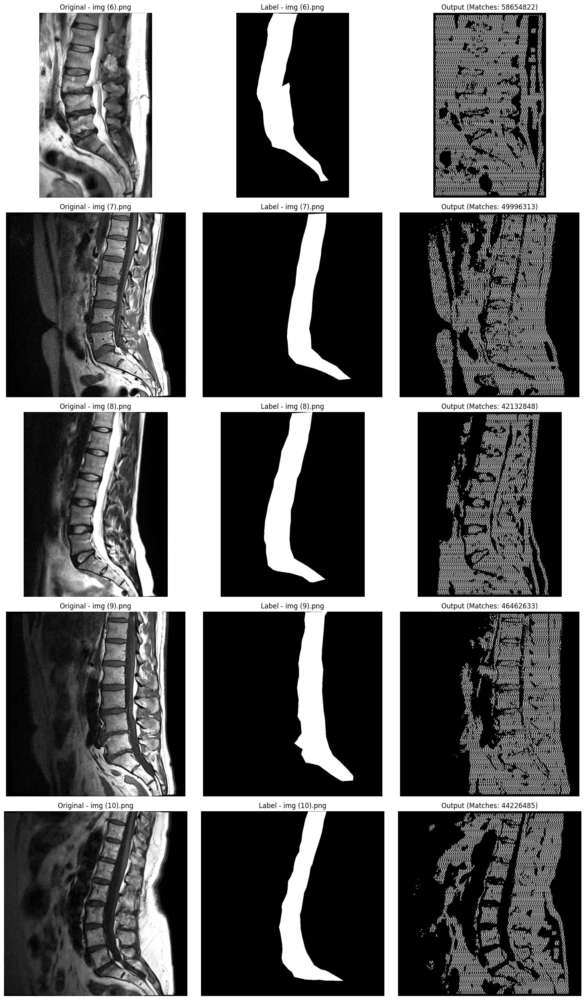

In [80]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    """
    İki vektör kümesi arasındaki korelasyon matrisini hesaplar.
    """
    return 1 - cdist(vectors1, vectors2, metric='correlation')

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_file = r"./DB/output/hog_features_with_coords.npz"
stored_hog_data = np.load(stored_hog_file)
stored_hog_vectors = stored_hog_data['features']

# Test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"./DB/images/img (6).png",
    r"./DB/images/img (7).png",
    r"./DB/images/img (8).png",
    r"./DB/images/img (9).png",
    r"./DB/images/img (10).png"
]

label_image_paths = [
    r"./DB/labels/label (6).png",
    r"./DB/labels/label (7).png",
    r"./DB/labels/label (8).png",
    r"./DB/labels/label (9).png",
    r"./DB/labels/label (10).png"
]

hog_files = [
    r"./DB/output/test_image6_hog_features_with_coords.npz",
    r"./DB/output/test_image7_hog_features_with_coords.npz",
    r"./DB/output/test_image8_hog_features_with_coords.npz",
    r"./DB/output/test_image9_hog_features_with_coords.npz",
    r"./DB/output/test_image10_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))  # Görsellerin boyutlarını ayarla

for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    try:
        # HOG vektörlerini ve koordinatlarını yükle
        hog_data = np.load(hog_file)
        test_hog_vectors = hog_data['hog_features']
        test_coords = hog_data['coords']

        # Test görüntüsünü yükle
        test_image = cv2.imread(test_image_path)
        if test_image is None:
            raise FileNotFoundError(f"Test görüntüsü bulunamadı: {test_image_path}")
        
        output_img = np.zeros_like(test_image)  # Çıktı görseli

        # Etiket görüntüsünü yükle
        label_image = cv2.imread(label_image_path)
        if label_image is None:
            raise FileNotFoundError(f"Etiket görüntüsü bulunamadı: {label_image_path}")

        # Korelasyon hesaplama
        correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
        threshold = 0.30  # Korelasyon eşiği
        high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

        # Eşleşen noktaları işleme
        matching_coords_count = 0
        for test_idx, _ in high_correlation_indices:
            coord = test_coords[test_idx]
            x, y = int(coord[0]), int(coord[1])
            cv2.circle(output_img, (x, y), 1, (255, 255, 255), -1)
            matching_coords_count += 1

        # Görüntü adını dosya yolundan çıkarma
        image_name = os.path.basename(test_image_path)

        # Orijinal görüntüyü görselleştir
        plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
        plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Original - {image_name}")
        plt.axis('off')

        # Etiket görüntüsünü görselleştir
        plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
        plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Label - {image_name}")
        plt.axis('off')

        # Çıktı görüntüsünü görselleştir
        plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
        plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Output (Matches: {matching_coords_count})")
        plt.axis('off')

    except Exception as e:
        print(f"Hata: {test_image_path} işlenirken bir hata oluştu. {str(e)}")

plt.tight_layout()
plt.show()


# Kod Özeti

Bu kod, çapraz korelasyon kullanarak görüntüler arasındaki eşleşmeleri tespit eder, her bir görüntü için Intersection over Union (IoU) değerini hesaplar ve bu değerleri görselleştirir. Ayrıca, IoU değerlerinin ortalamasını hesaplar ve bir grafik üzerinde gösterir.

---

### Adımlar:

1. **IoU Hesaplama**:
   - `calculate_iou` fonksiyonu, iki görüntü arasındaki Intersection over Union (IoU) değerini hesaplar.
   - Görüntüler ikili (binary) formatta dönüştürülür.
   - Kesişim ve birleşim hesaplanarak IoU değeri elde edilir.

2. **Çapraz Korelasyon Hesaplama**:
   - `compute_cross_correlation_optimized` fonksiyonu, HOG özellikleri arasında çapraz korelasyon hesaplar.
   - Bu korelasyon, test görüntüsü ile referans HOG vektörleri arasında yüksek korelasyona sahip eşleşmeleri tespit eder.

3. **Eşleşen Noktaların İşaretlenmesi**:
   - Yüksek korelasyona sahip noktalara beyaz daireler çizilir.
   - Eşleşen noktalar çıktı görüntüsünde işaretlenir.

4. **Görselleştirme ve Sonuçların Yazdırılması**:
   - Her bir test görüntüsü için, hesaplanan IoU değeri konsola yazdırılır.
   - IoU değerlerinin görselleştirilmesi için bir grafik oluşturulur.

---

### Kullanım:

- **Görüntü İşleme**: Test görüntüleri, etiketler ve HOG dosyaları kullanılarak eşleşmeler bulunur.
- **IoU Hesaplama**: Çıktı görüntüsü ile etiket görüntüsü arasındaki IoU değeri hesaplanır.
- **Görselleştirme**: Eşleşen noktalar işaretlenir ve IoU değerleri görselleştirilir.




Test Image 6: IoU = 0.2030
Test Image 7: IoU = 0.1734
Test Image 8: IoU = 0.2497
Test Image 9: IoU = 0.2353
Test Image 10: IoU = 0.1732

(Erosion Label + Görüntü + Hog + Cross Kolerasyon) Ortalama IoU: 0.2069


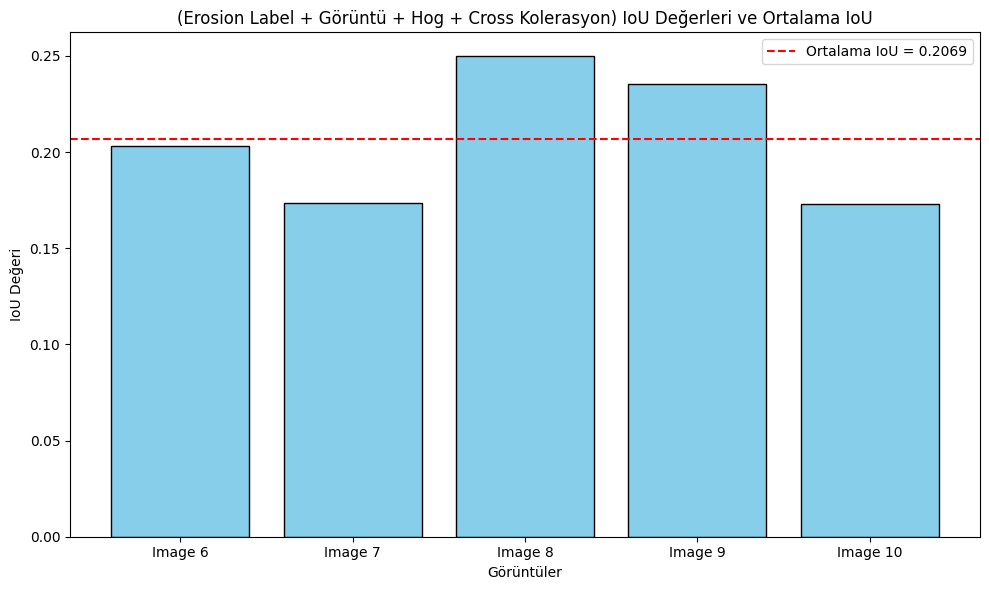

In [81]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    """
    İki görüntü arasındaki Intersection over Union (IoU) değerini hesaplar.
    """
    # İkili görüntüye dönüştürme (thresholding)
    _, pred_binary = cv2.threshold(cv2.cvtColor(predicted_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(cv2.cvtColor(label_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)
    
    # Kesişim ve birleşim hesaplama
    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()
    
    # IoU hesaplama
    return intersection / union if union != 0 else 0

# IoU hesaplama ve çıktı
ious = []
threshold = 0.30  # Korelasyon eşiği

for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    try:
        # Çıkış görüntüsünü oluştur
        output_img = np.zeros_like(cv2.imread(test_image_path))
        
        # HOG vektörlerini yükle ve yüksek korelasyonlu alanları işaretle
        hog_data = np.load(hog_file)
        test_hog_vectors = hog_data['hog_features']
        test_coords = hog_data['coords']
        
        # Çapraz korelasyonu hesapla ve yüksek korelasyonlu eşleşmeleri bul
        correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
        high_correlation_indices = np.argwhere(correlations_matrix >= threshold)
        
        # Yüksek korelasyonlu eşleşmeleri işaretle
        for test_idx, _ in high_correlation_indices:
            coord = test_coords[test_idx]
            x, y = int(coord[0]), int(coord[1])
            cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)
        
        # Etiket görüntüsünü yükle
        label_image = cv2.imread(label_image_path)
        if label_image is None:
            raise FileNotFoundError(f"Etiket görüntüsü bulunamadı: {label_image_path}")
        
        # IoU hesapla
        iou = calculate_iou(output_img, label_image)
        ious.append(iou)
        print(f"Test Image {idx + 6}: IoU = {iou:.4f}")

    except Exception as e:
        print(f"Test Image {idx + 6} işlenirken hata oluştu: {str(e)}")

# Ortalama IoU hesaplama
if ious:
    mean_iou = np.mean(ious)
    print(f"\n(Erosion Label + Görüntü + Hog + Cross Kolerasyon) Ortalama IoU: {mean_iou:.4f}")
else:
    print("IoU hesaplamaları için geçerli sonuç bulunamadı.")

# IoU Grafik Çıktısı
if ious:
    image_names = [f"Image {i+6}" for i in range(len(ious))]
    plt.figure(figsize=(10, 6))
    plt.bar(image_names, ious, color='skyblue', edgecolor='black')
    plt.axhline(mean_iou, color='red', linestyle='--', label=f'Ortalama IoU = {mean_iou:.4f}')
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('(Erosion Label + Görüntü + Hog + Cross Kolerasyon) IoU Değerleri ve Ortalama IoU')
    plt.legend()
    plt.tight_layout()
    plt.show()


# Kod Özeti

Bu kod, verilen görüntüleri sırasıyla normalizasyon, ortalama filtreleme ve parlaklık artırma işlemlerinden geçirir. Ardından etiketli bölgeyi çıkararak işlenmiş maskelenmiş görüntüleri elde eder ve bu görüntüleri görselleştirir.

---

### Adımlar:

1. **Normalizasyon**:
   - `normalize_image` fonksiyonu, her bir görüntüdeki piksel değerlerini [0, 1] aralığına getirir ve ardından tekrar [0, 255] aralığına çevirir.

2. **Ortalama Filtreleme**:
   - `mean_filter` fonksiyonu, görüntüye ortalama filtre uygular (kernel boyutu 5x5).
   - Bu işlem, görüntüdeki gürültüyü azaltmaya yardımcı olur.

3. **Parlaklık Artırma**:
   - `increase_brightness` fonksiyonu, her bir görüntüdeki parlaklığı belirtilen bir değerde (default 25) artırır.

4. **Etiketli Bölgeyi Çıkarma**:
   - Etiket görüntüsü ile maskeleme işlemi yapılarak sadece ilgi alanındaki kısımlar çıkarılır.
   - `cv2.bitwise_and` fonksiyonu, maskelenmiş görüntüyü elde etmek için kullanılır.

5. **Görselleştirme**:
   - Orijinal görüntü, etiket görüntüsü ve işlenmiş maskelenmiş görüntü sırasıyla görselleştirilir.
   - Matplotlib ile görseller yan yana gösterilir.

6. **Boyutları Yazdırma**:
   - Her bir işlenmiş maskelenmiş görüntünün boyutları konsola yazdırılır.

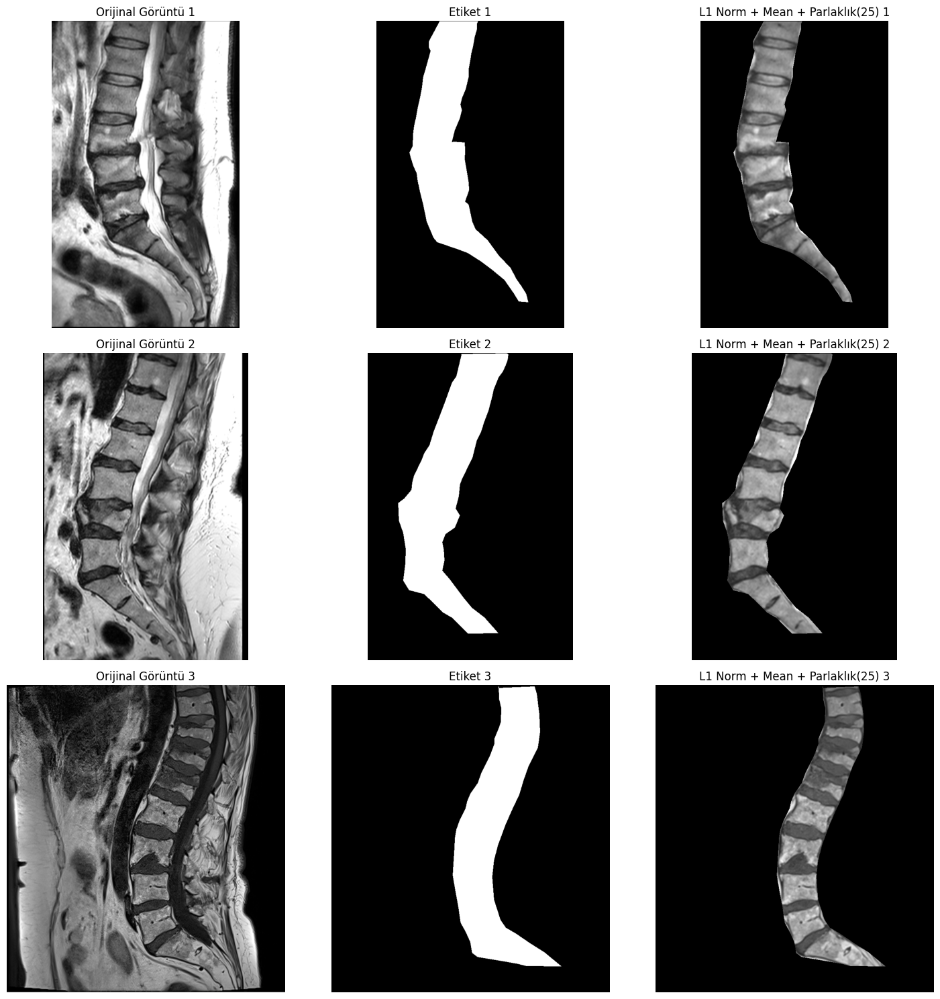

masked_image1 Boyutları: (856, 523)
masked_image2 Boyutları: (856, 572)
masked_image3 Boyutları: (855, 774)


In [87]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Görüntü ve etiket dosyalarının yolları
image_paths = [

    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png",
]

label_paths = [
    r"./DB/labels/label (1).png",
    r"./DB/labels/label (2).png",
    r"./DB/labels/label (3).png",
]

# Adım 1: I1 Norm Normalizasyonu
def normalize_image(image):
    """
    Görüntüyü normalize eder (0-255 arasında).
    """
    normalized_image = image / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    return (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir

# Adım 2: Mean (Ortalama) Filtreleme
def mean_filter(image, kernel_size=5):
    """
    Görüntüye ortalama filtre uygular.
    """
    return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

# Adım 3: Parlaklık Artırma
def increase_brightness(image, brightness_increase=25):
    """
    Görüntünün parlaklığını artırır.
    """
    return cv2.add(image, np.full_like(image, brightness_increase))

# Görüntü işleme fonksiyonu
def process_image(image_path, label_path):
    """
    Görüntüyü işler ve maskelenmiş sonucu döndürür.
    """
    # Görüntüyü ve etiketi yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    label_image = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

    # 1. Normalizasyon
    normalized_image = normalize_image(image)

    # 2. Ortalama Filtreleme
    mean_filtered = mean_filter(normalized_image, kernel_size=5)

    # 3. Parlaklık Artırma
    brightened_image = increase_brightness(mean_filtered, brightness_increase=25)

    # Etiketli bölgeyi çıkarma
    masked_image = cv2.bitwise_and(brightened_image, brightened_image, mask=label_image)

    return image, label_image, masked_image

# Görüntüleri işleme
processed_images = [process_image(image_paths[i], label_paths[i]) for i in range(len(image_paths))]

# masked_image'leri adlandırma
masked_images = [masked for _, _, masked in processed_images]

# Sonuçları görselleştirme
plt.figure(figsize=(15, 15))

for i, (original, label, masked) in enumerate(processed_images):
    # Orijinal Görüntü
    plt.subplot(len(processed_images), 3, i*3 + 1)
    plt.title(f"Orijinal Görüntü {i+1}")
    plt.imshow(original, cmap="gray")
    plt.axis("off")

    # Etiket Görüntüsü
    plt.subplot(len(processed_images), 3, i*3 + 2)
    plt.title(f"Etiket {i+1}")
    plt.imshow(label, cmap="gray")
    plt.axis("off")

    # İşlenmiş Maskelenmiş Görüntü
    plt.subplot(len(processed_images), 3, i*3 + 3)
    plt.title(f"L1 Norm + Mean + Parlaklık(25) {i+1}")
    plt.imshow(masked, cmap="gray")
    plt.axis("off")

plt.tight_layout()
plt.show()

# Maskelenmiş görüntülerin boyutlarını yazdır
for i, masked_image in enumerate(masked_images, start=1):
    print(f"masked_image{i} Boyutları: {masked_image.shape}")


# Kod Özeti

Bu kod, verilen görüntüleri sırasıyla normalizasyon, ortalama filtreleme ve parlaklık artırma işlemlerinden geçirir. Ardından etiketli bölgeyi çıkararak işlenmiş maskelenmiş görüntüleri elde eder ve bu görüntüleri görselleştirir.

---

### Adımlar:

1. **Normalizasyon**:
   - `normalize_image` fonksiyonu, her bir görüntüdeki piksel değerlerini [0, 1] aralığına getirir ve ardından tekrar [0, 255] aralığına çevirir.

2. **Ortalama Filtreleme**:
   - `mean_filter` fonksiyonu, görüntüye ortalama filtre uygular (kernel boyutu 5x5).
   - Bu işlem, görüntüdeki gürültüyü azaltmaya yardımcı olur.

3. **Parlaklık Artırma**:
   - `increase_brightness` fonksiyonu, her bir görüntüdeki parlaklığı belirtilen bir değerde (default 25) artırır.

4. **Etiketli Bölgeyi Çıkarma**:
   - Etiket görüntüsü ile maskeleme işlemi yapılarak sadece ilgi alanındaki kısımlar çıkarılır.
   - `cv2.bitwise_and` fonksiyonu, maskelenmiş görüntüyü elde etmek için kullanılır.

5. **Görselleştirme**:
   - Orijinal görüntü, etiket görüntüsü ve işlenmiş maskelenmiş görüntü sırasıyla görselleştirilir.
   - Matplotlib ile görseller yan yana gösterilir.

6. **Boyutları Yazdırma**:
   - Her bir işlenmiş maskelenmiş görüntünün boyutları konsola yazdırılır.

---

### Kullanım:

- **Görüntü İşleme**: Her bir görüntü sırasıyla normalizasyon, ortalama filtreleme ve parlaklık artırma adımlarından geçer.
- **Etiketli Bölgeyi Çıkarma**: Etiket görüntüsündeki ilgi alanları maskelenerek işlenmiş görüntüler elde edilir.
- **Görselleştirme**: Görselleştirme adımında orijinal, etiketli ve maskelenmiş görüntüler görüntülenir.


In [13]:
import cv2
import matplotlib.pyplot as plt

def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius=10):
    """
    Görüntü üzerine noktaları, çizgileri ve patch'leri işaretlemek için kullanılır.

    Args:
        img (numpy.ndarray): Giriş görüntüsü (gri tonlamalı).
        EdgePoints (list, optional): İşaretlenecek noktaların koordinatları [(y, x), ...].
        EdgeLines (list, optional): Çizilecek çizgilerin başlangıç ve bitiş noktaları [{'StartPointYX': (y1, x1), 'StopPointYX': (y2, x2)}, ...].
        EdgePatchs (list, optional): Çizilecek patch'lerin merkezi ve boyut bilgisi [(x, y, PatchSize), ...].
        title (str, optional): Görüntü başlığı.
        circle_radius (int, optional): Noktalar için çizilecek dairelerin yarıçapı.

    Returns:
        None: Görsel ekranda gösterilir.
    """
    # Gri tonlamalı görüntüyü BGR formatına dönüştür
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

    # Noktaları işaretle
    if EdgePoints is not None:
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # Koordinatları (x, y) formatına çevir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire

    # Çizgileri işaretle
    if EdgeLines is not None:
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color=(255, 255, 0), thickness=2)

    # Patch'leri işaretle
    if EdgePatchs is not None:
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)
        thickness = 2
        for k, (x, y, PatchSize) in enumerate(EdgePatchs):
            top_left = (x - PatchSize, y - PatchSize)
            bottom_right = (x + PatchSize, y + PatchSize)
            cv2.rectangle(output_img, top_left, bottom_right, (0, 0, 255), 2)
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)

    # Görsel boyutlarını hesapla
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)

    # Görselleştirme
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title:
        plt.title(title, fontsize=20)
    plt.axis('off')
    plt.show()


# Kod Özeti

Bu kod, maskelenmiş görüntülerdeki siyah olmayan pikselleri tespit eder, bu pikseller üzerine SIFT (Scale-Invariant Feature Transform) algoritması ile anahtar noktalar çıkarır ve bu noktaları görselleştirir.

---

### Adımlar:

1. **SIFT Anahtar Noktaları Çıkarma**:
   - SIFT algoritması kullanarak, görüntüdeki anahtar noktalar ve descriptor'lar çıkarılır.

2. **Siyah Olmayan Piksellerin Maskesini Oluşturma**:
   - Görüntüdeki siyah olmayan pikselleri tespit ederek bir maske oluşturulur.

3. **Anahtar Noktaları Çizme**:
   - Çıkarılan anahtar noktalar, belirtilen daire yarıçapı ile kırmızı daireler olarak çizilir ve görselleştirilir.

4. **Görselleştirme**:
   - Her işlenmiş görüntüdeki anahtar noktalar görselleştirilir.

--- 

### Kullanım:

- **Siyah Olmayan Piksellerin Maskesini Alma**: Görüntüdeki siyah olmayan pikseller tespit edilir.
- **SIFT Anahtar Noktaları Çıkarma**: Siyah olmayan piksellerde anahtar noktalar çıkarılır.
- **Anahtar Noktalarını Görselleştirme**: Görüntü üzerine anahtar noktalar kırmızı dairelerle işaretlenir.


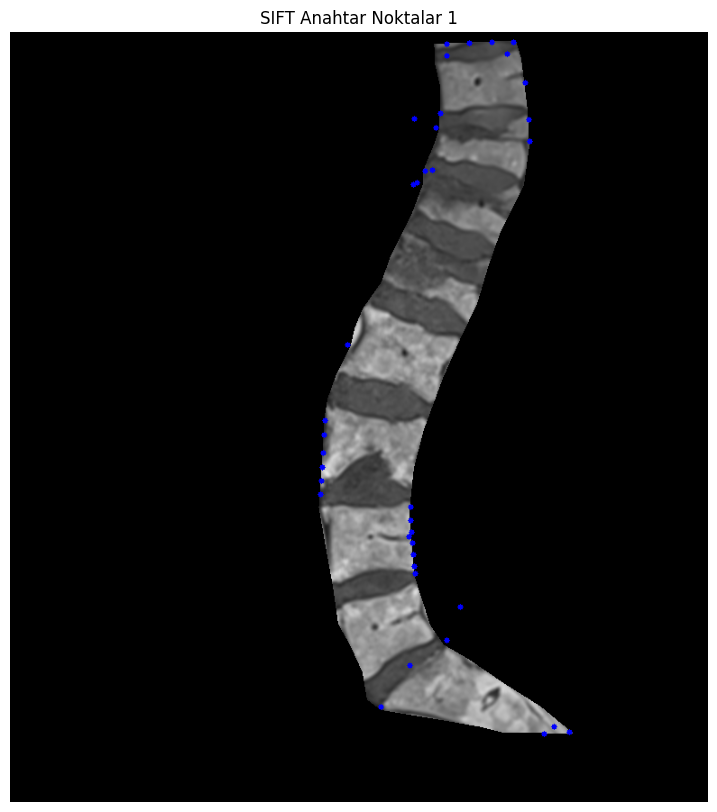

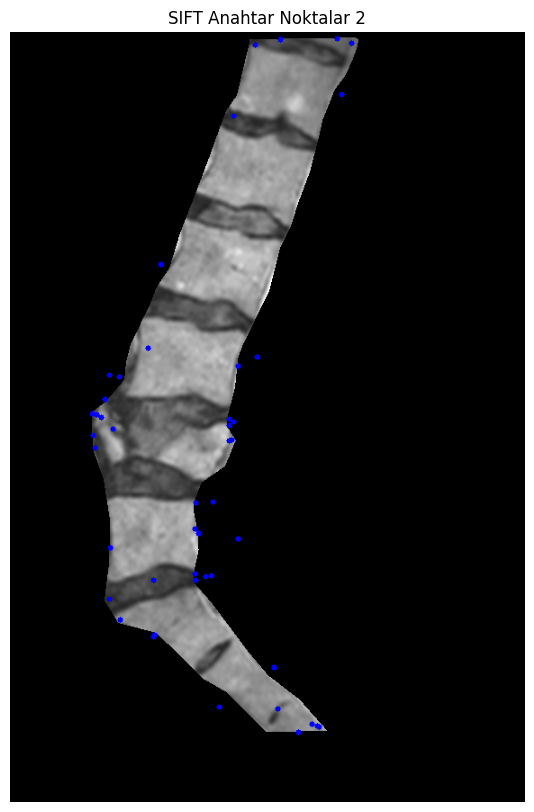

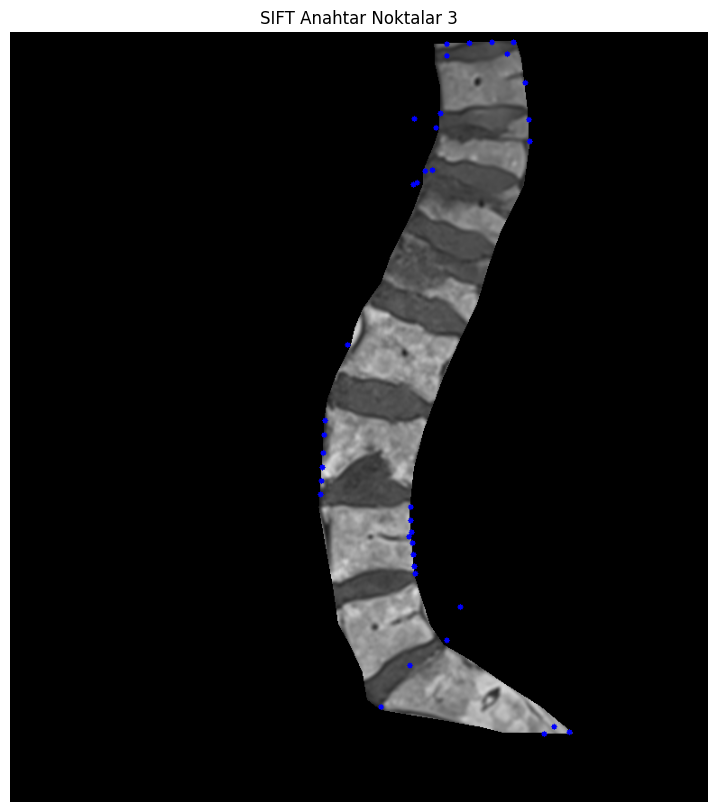

In [102]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# SIFT anahtar noktaları alma fonksiyonu
def extract_sift_keypoints(image):
    """
    SIFT (Scale-Invariant Feature Transform) kullanarak bir görüntüdeki anahtar noktaları ve descriptor'ları çıkarır.
    
    Args:
        image (numpy.ndarray): Giriş görüntüsü (grayscale).
    
    Returns:
        tuple: Anahtar noktalar (keypoints) ve descriptor'lar.
    """
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(image, None)
    return keypoints, descriptors

# Siyah olmayan piksellerin maskesini oluşturma
def get_non_black_pixels(image):
    """
    Siyah olmayan pikseller için bir maske oluşturur.
    
    Args:
        image (numpy.ndarray): Giriş görüntüsü (grayscale).
    
    Returns:
        numpy.ndarray: Siyah olmayan bölgeleri beyaz (255) olan maske.
    """
    non_black_mask = image > 0
    return non_black_mask.astype(np.uint8) * 255

# Anahtar noktaları çizme fonksiyonu
def draw_keypoints(image, keypoints, title=None, circle_radius=10):
    """
    Bir görüntü üzerine SIFT anahtar noktalarını çizer.
    
    Args:
        image (numpy.ndarray): Giriş görüntüsü (grayscale).
        keypoints (list): Anahtar noktalar (SIFT keypoints).
        title (str): Görüntü başlığı.
        circle_radius (int): Çizilen dairelerin yarıçapı.
    """
    # Gri tonlamalı görüntüyü renkli (BGR) formata dönüştür
    output_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    
    # Anahtar noktaları kırmızı dairelerle işaretle
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(output_image, (x, y), circle_radius, (0, 0, 255), -1)
    
    # Görüntüyü görselleştir
    plt.figure(figsize=(10, 10))
    plt.imshow(output_image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# İşlenmiş maskelenmiş görüntülerin listesi
masked_images = [masked_image, masked_image2, masked_image3]  # Önceden işlenmiş görüntüler

# Görselleri işleme ve anahtar noktaları çizme
for i, masked_image in enumerate(masked_images):
    if masked_image is None:
        print(f"Masked image {i+1} yüklenemedi veya geçersiz.")
        continue
    
    # Siyah olmayan piksellerin maskesini oluştur
    non_black_mask = get_non_black_pixels(masked_image)
    
    # Anahtar noktaları ve descriptor'ları çıkar
    keypoints, _ = extract_sift_keypoints(non_black_mask)
    
    # Anahtar noktaları çiz ve görselleştir
    draw_keypoints(masked_image, keypoints, title=f"SIFT Anahtar Noktalar {i+1}", circle_radius=3)


# Kod Özeti

Bu kod, işlenmiş maskelenmiş görüntülerdeki siyah olmayan pikselleri tespit eder, bu piksellerin etrafındaki bölgelere SIFT anahtar noktaları çıkarır ve bu noktalara göre yama (patch) çıkarır. Ayrıca, çıkartılan yamalar ve numaraları ile birlikte görselleştirme işlemi yapar.

---

### Adımlar:

1. **SIFT Anahtar Noktaları Çıkarma (`extract_sift_keypoints`)**:
   - SIFT algoritması ile verilen görüntüdeki anahtar noktalar ve descriptor'lar çıkarılır.
   - Bu işlem, görüntüdeki önemli özellikleri tanımak için kullanılır.

2. **Siyah Olmayan Piksellerin Maskesini Oluşturma (`get_non_black_pixels`)**:
   - Görüntüdeki siyah olmayan pikselleri tespit ederek bir maske oluşturulur.
   - Siyah olmayan piksellerin bulunduğu bölgeler beyaz (255), geri kalanlar ise siyah (0) olarak işaretlenir.

3. **Yama Çıkarma (`GetPatchsFromNonBlackPixels`)**:
   - Siyah olmayan piksellerin etrafında belirtilen boyutta yamalar (patch) çıkarılır.
   - Her bir yama, siyah olmayan pikselin etrafında belirli bir boyutla alınır.

4. **Anahtar Noktaları ve Yamaları Çizme (`draw_keypoints_with_patches`)**:
   - Çıkarılan anahtar noktalar ve yamalar üzerine kırmızı dikdörtgenler çizilir.
   - Her yamanın etrafına numara eklenir ve görselleştirme yapılır.

---

### Kullanım:

- **Anahtar Noktaları Çıkarma**: SIFT algoritması kullanılarak siyah olmayan piksellerin etrafında anahtar noktalar çıkarılır.
- **Patch Çıkarmak**: Anahtar noktaların koordinatları etrafında yamalar (patches) çıkarılır.
- **Görselleştirme**: Çıkarılan yamalar ve anahtar noktalar, numaralarla birlikte kırmızı dikdörtgenler ile görselleştirilir.

--- 

### Notlar:

- **SIFT Algoritması**: Görüntülerdeki önemli özellikleri tespit eden ve nesne tanıma gibi görevlerde kullanılan bir algoritmadır.
- **Görselleştirme**: `matplotlib` ve `cv2` kullanılarak görseller üzerinde yamalar ve anahtar noktalar çizilir.
- **İşlem Sırası**: İlk olarak siyah olmayan piksellerin maskesi çıkarılır, ardından SIFT anahtar noktaları ile bu noktalar etrafında yamalar çıkarılır.


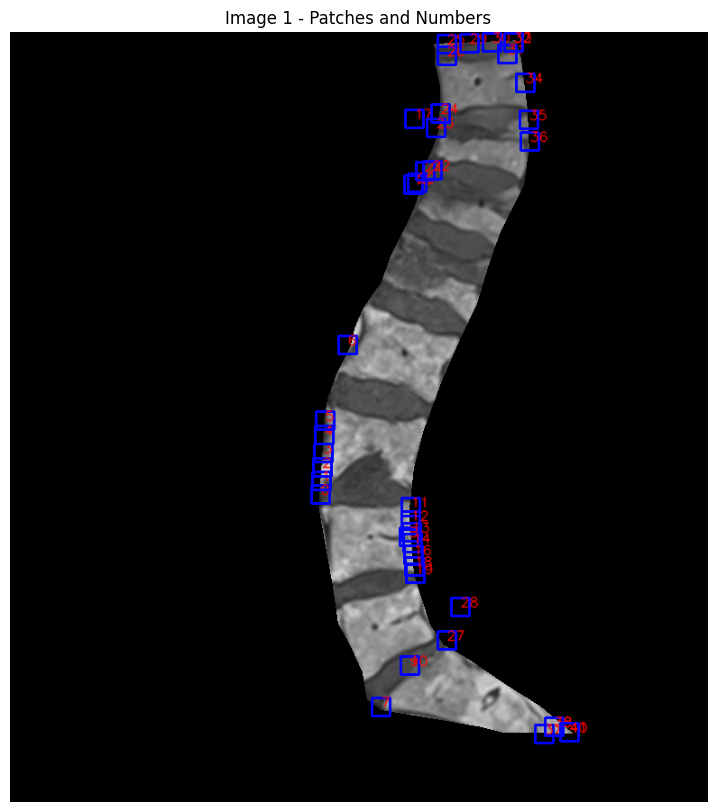

Görüntü 1: Toplam 42 yama çıkarıldı.


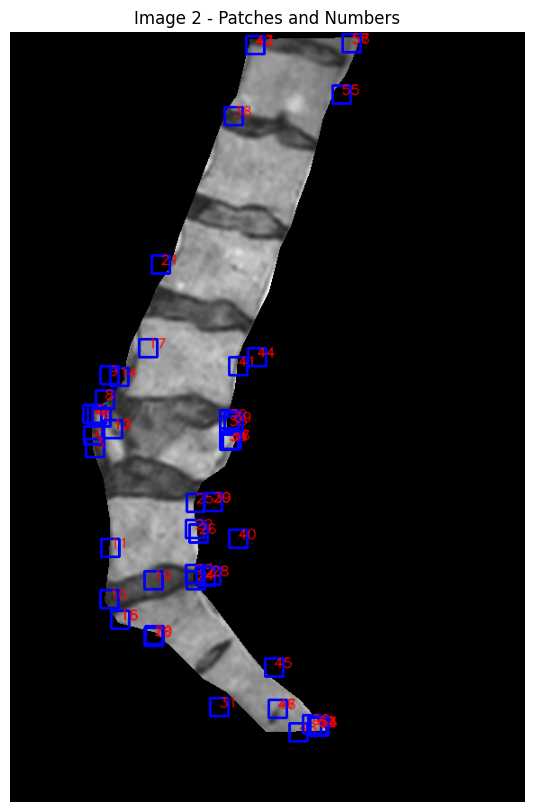

Görüntü 2: Toplam 58 yama çıkarıldı.


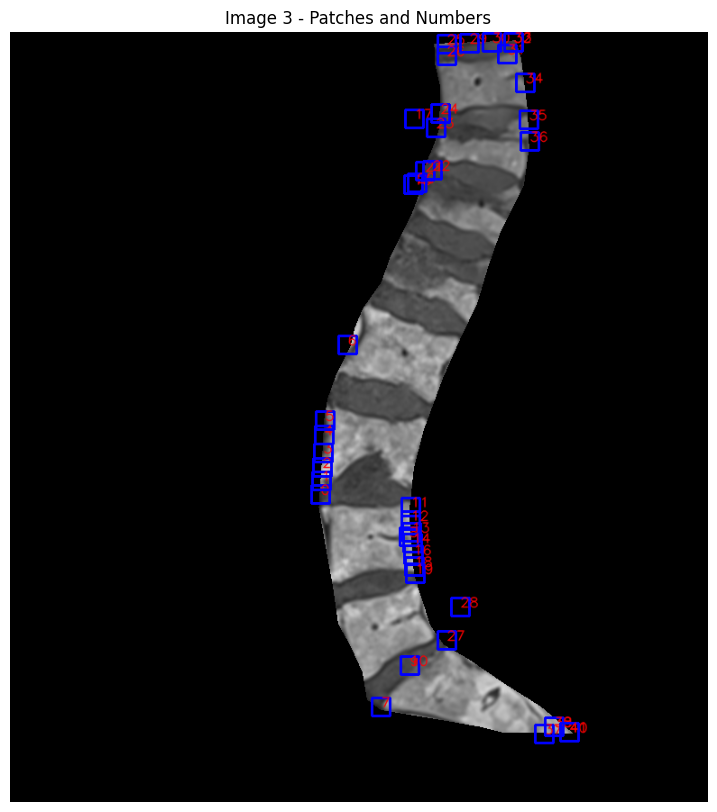

Görüntü 3: Toplam 42 yama çıkarıldı.


In [104]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# SIFT anahtar noktaları alma fonksiyonu
def extract_sift_keypoints(image):
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(image, None)
    return keypoints, descriptors

# Siyah olmayan piksellerin maskesini oluşturma
def get_non_black_pixels(image):
    non_black_mask = image > 0
    return non_black_mask.astype(np.uint8) * 255

# Anahtar noktaları ve yamaları çizme fonksiyonu
def draw_keypoints_with_patches(image, patches_info, title=None):
    output_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    font = cv2.FONT_HERSHEY_SIMPLEX

    for idx, (x, y, patch_size) in enumerate(patches_info):
        # Dikdörtgen çiz
        top_left = (x - patch_size, y - patch_size)
        bottom_right = (x + patch_size, y + patch_size)
        cv2.rectangle(output_image, top_left, bottom_right, (0, 0, 255), 2)
        # Numara ekle
        cv2.putText(output_image, str(idx), (x, y), font, 0.5, (255, 0, 0), 1, cv2.LINE_AA)

    plt.figure(figsize=(10, 10))
    plt.imshow(output_image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Patch çıkarma fonksiyonu
def GetPatchsFromNonBlackPixels(img, NonBlackPixels, PatchSize=10):
    patches = []
    patches_info = []
    rows, cols = img.shape

    for y, x in NonBlackPixels:
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            continue

        patch = img[y_start:y_end, x_start:x_end]
        patches.append(patch)
        patches_info.append((x, y, PatchSize))

    return patches, patches_info

# Görselleri işleme
for i, masked_image in enumerate([masked_image, masked_image2, masked_image3]):
    # Siyah olmayan pikselleri al
    non_black_mask = get_non_black_pixels(masked_image)
    # SIFT anahtar noktalarını çıkar
    keypoints, _ = extract_sift_keypoints(non_black_mask)
    # Anahtar noktalara göre patch çıkar
    patches, patches_info = GetPatchsFromNonBlackPixels(
        masked_image,
        [(int(kp.pt[1]), int(kp.pt[0])) for kp in keypoints],
        PatchSize=10
    )
    # Patch'leri ve numaraları çiz
    draw_keypoints_with_patches(masked_image, patches_info, title=f"Image {i+1} - Patches and Numbers")
    print(f"Görüntü {i+1}: Toplam {len(patches)} yama çıkarıldı.")


# Kod Özeti

Bu kod, işlenmiş görüntülerdeki siyah olmayan pikselleri tespit eder, bu piksellerin etrafındaki bölgelerden SIFT anahtar noktaları çıkarır ve her bir yamanın HOG (Histogram of Oriented Gradients) özelliklerini hesaplayarak kaydeder.

---

### Adımlar:

1. **HOG Özelliklerini Hesaplama (`compute_hog_features`)**:
   - Görüntü üzerinde HOG özelliklerini hesaplamak için `cv2.HOGDescriptor` kullanılır. Bu, görüntüdeki yapısal bilgileri belirli hücreler ve bloklar kullanarak çıkarır.

2. **HOG Özelliklerini ve Koordinatları Kaydetme (`save_hog_features_with_coords`)**:
   - Çıkarılan patch'lerden HOG özellikleri ve bu patch'lerin koordinat bilgileri bir dosyaya kaydedilir.
   
3. **Siyah Olmayan Pikselleri Tespit Etme (`get_non_black_pixels`)**:
   - Görüntüdeki siyah olmayan pikseller tespit edilir ve bu piksellerin bir maskesi oluşturulur.

4. **SIFT Anahtar Noktaları Çıkarma (`extract_sift_keypoints`)**:
   - Görüntüdeki SIFT anahtar noktaları çıkarılır. Bu noktalar, görüntüdeki en belirgin ve tekrar kullanılabilir özellikleri temsil eder.

5. **Patch Çıkartma (`GetPatchsFromNonBlackPixels`)**:
   - Anahtar noktalar etrafında belirtilen boyutta patch'ler (görüntü bölgeleri) çıkarılır. Bu yamalar, ilgili anahtar noktalar etrafındaki bölgeyi temsil eder.

6. **İşlenmiş Görüntüler Üzerinde HOG Hesaplama ve Kaydetme**:
   - Her bir işlenmiş görüntü için, siyah olmayan piksellerden anahtar noktalar çıkarılır, bu noktalar etrafında yamalar (patch'ler) çıkarılır ve her bir yamanın HOG özellikleri kaydedilir.

---

### Kullanım:

- **HOG Özellikleri**: Görüntüdeki yapısal ve yönsel bilgileri çıkarır.
- **SIFT Anahtar Noktaları**: Görüntüdeki belirgin noktaları tespit eder.
- **Patch Çıkartma**: Anahtar noktalar etrafında yamalar çıkarır ve bu yamaların özelliklerini hesaplar.
- **Görselleştirme**: Her bir yamadaki HOG özellikleri kaydedilir.



In [107]:
import os
import numpy as np
import cv2

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Görüntüden HOG özelliklerini hesaplar.
    """
    # Görüntüyü gri tonlamalıya çevir ve normalize et
    if image.ndim == 3:  # RGB görüntü kontrolü
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    if image.dtype != np.uint8:  # Görüntü tipi 8-bit değilse normalize et
        image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # HOG hesaplayıcıyı yapılandır
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    # HOG özelliklerini hesapla
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    HOG özelliklerini ve koordinatlarını bir dosyaya kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        # Her patch için HOG özelliklerini hesapla
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)  # HOG özelliklerini listeye ekle
        all_coords.append(info)  # Patch koordinatlarını ekle

    # Özellikleri ve koordinatları numpy dizilerine dönüştür
    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    # Çıktı dizinini oluştur
    os.makedirs(os.path.dirname(output_path), exist_ok=True)

    # Özellikleri ve koordinatları sıkıştırılmış bir dosyaya kaydet
    np.savez_compressed(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar başarıyla kaydedildi: {output_path}")

# Siyah olmayan pikselleri tespit etme
def get_non_black_pixels(image):
    """
    Görüntüde siyah olmayan piksellerin maskesini döndürür.
    """
    return (image > 0).astype(np.uint8)

# SIFT anahtar noktalarını çıkarma
def extract_sift_keypoints(image):
    """
    Görüntüden SIFT anahtar noktalarını ve descriptor'larını çıkarır.
    """
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(image, None)
    return keypoints, descriptors

# Patch'leri çıkarma fonksiyonu
def GetPatchsFromNonBlackPixels(img, keypoints, PatchSize=10, draw=True):
    """
    Siyah olmayan piksellerden patch'leri çıkarır.
    """
    Patchs = []
    PatchsInfo = []
    rows, cols = img.shape

    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])  # Anahtar noktaların koordinatları
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        # Görüntü sınır kontrolü
        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            continue

        Patch = img[y_start:y_end, x_start:x_end]
        Patchs.append(Patch)
        PatchsInfo.append((x, y, PatchSize))

    return Patchs, PatchsInfo

# Çıktı dizini
output_directory = r"./DB/output/hog_features"

# Görselleri işleme ve HOG hesaplama
for i, masked_image in enumerate([masked_image, masked_image2, masked_image3], start=1):
    print(f"Görüntü {i} için işlem başlıyor...")

    # Siyah olmayan pikselleri al
    non_black_mask = get_non_black_pixels(masked_image)

    # SIFT anahtar noktalarını al
    keypoints, _ = extract_sift_keypoints(non_black_mask)

    # Patch'leri al
    patches, patches_info = GetPatchsFromNonBlackPixels(
        masked_image,
        keypoints,
        PatchSize=10,
        draw=False
    )

    # HOG özelliklerini kaydetme
    output_file_with_coords = os.path.join(output_directory, f"image_{i}_hog_features_with_coords.npz")
    save_hog_features_with_coords(patches, patches_info, output_file_with_coords)

    # Kodlanan toplam patch sayısını yazdır
    print(f"Görüntü {i}: Toplam {len(patches)} patch HOG ile kodlandı.")


Görüntü 1 için işlem başlıyor...
HOG özellikleri ve koordinatlar başarıyla kaydedildi: ./DB/output/hog_features\image_1_hog_features_with_coords.npz
Görüntü 1: Toplam 0 patch HOG ile kodlandı.
Görüntü 2 için işlem başlıyor...
HOG özellikleri ve koordinatlar başarıyla kaydedildi: ./DB/output/hog_features\image_2_hog_features_with_coords.npz
Görüntü 2: Toplam 0 patch HOG ile kodlandı.
Görüntü 3 için işlem başlıyor...
HOG özellikleri ve koordinatlar başarıyla kaydedildi: ./DB/output/hog_features\image_3_hog_features_with_coords.npz
Görüntü 3: Toplam 0 patch HOG ile kodlandı.


# Kod Özeti

Bu kod, verilen görüntü dosyalarından her birini işleyerek parlaklık artırma ve normalizasyon gibi işlemleri uygular ve ardından her bir işlenmiş görüntüyü görselleştirir.

---

### Adımlar:

1. **Görüntü ve Etiket Yükleme (`GetImageLabel`)**:
   - Bu fonksiyon, verilen dosya yollarından gri tonlamalı görüntüleri ve etiketleri yükler.
   - Yüklenen görüntüleri isteğe bağlı olarak yan yana görselleştirir.

2. **Görüntü İşleme (`process_image`)**:
   - Görüntü işleme adımları şunlardır:
     - **Normalizasyon**: Görüntüyü [0, 255] aralığına dönüştürür.
     - **Ortalama Filtreleme**: Görüntüyü yumuşatarak filtreler.
     - **Parlaklık Artırma**: Görüntünün parlaklığını artırır.

3. **Görselleştirme**:
   - Her bir işlenmiş görüntü ile birlikte ilgili etiket de görselleştirilir.
   - Görüntüler, işlenmiş hali ve etiketleriyle yan yana gösterilir.

---

### Kullanım:

- **Görüntü İşleme**: Her bir görüntüye normalizasyon, ortalama filtreleme ve parlaklık artırma işlemleri uygulanır.
- **Görselleştirme**: İşlenen görüntüler ile etiketler yan yana olarak görselleştirilir.
- **Ekran Çıktısı**: Her bir işlenmiş görüntü ve etiketi görsel olarak ekranda gösterilir.




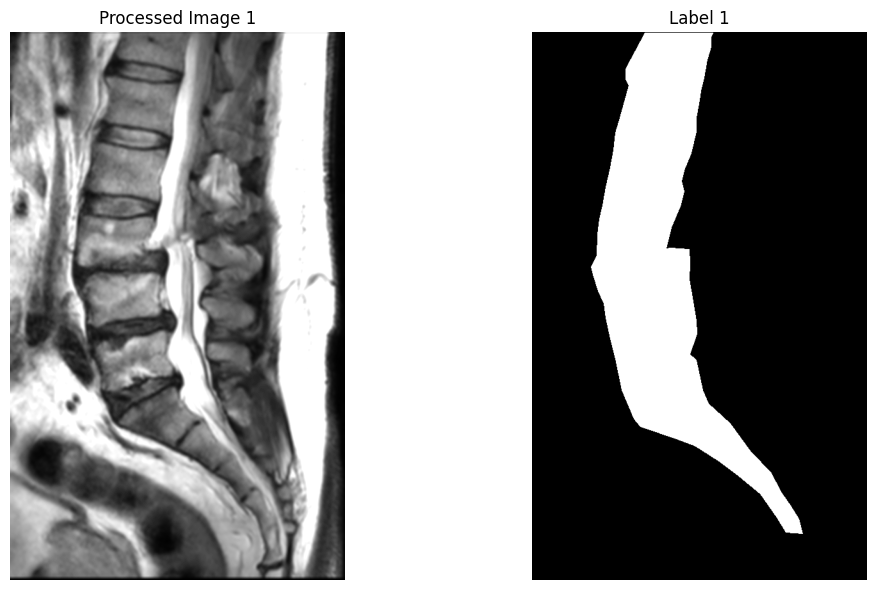

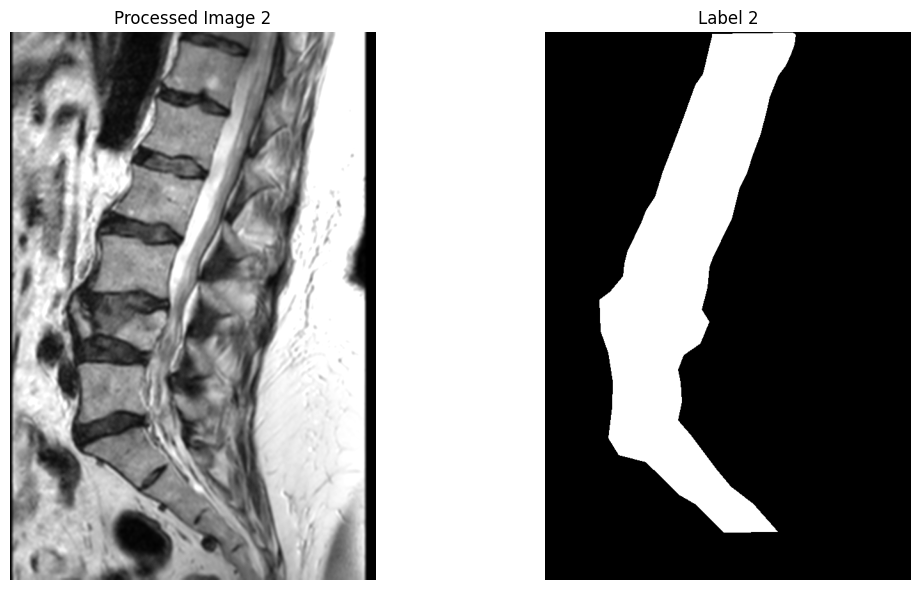

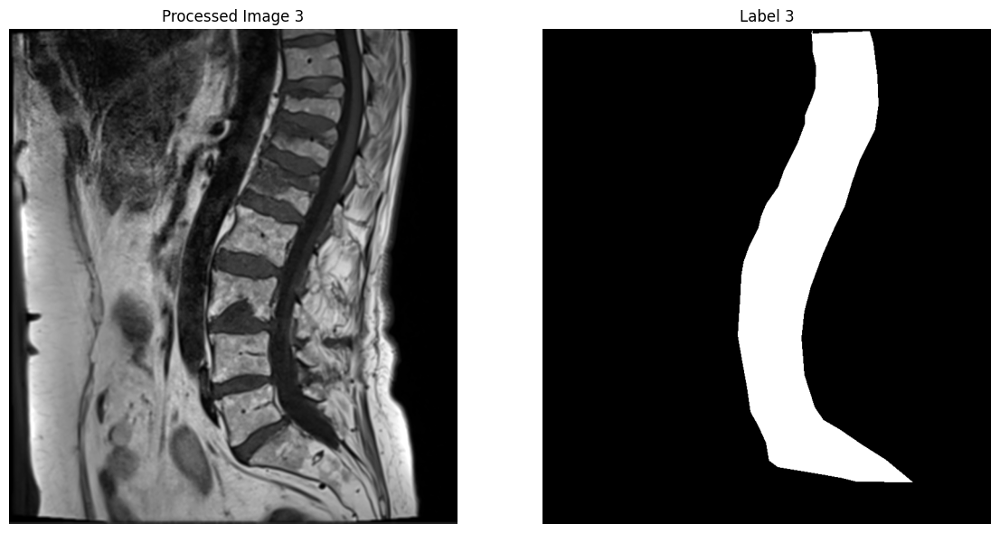

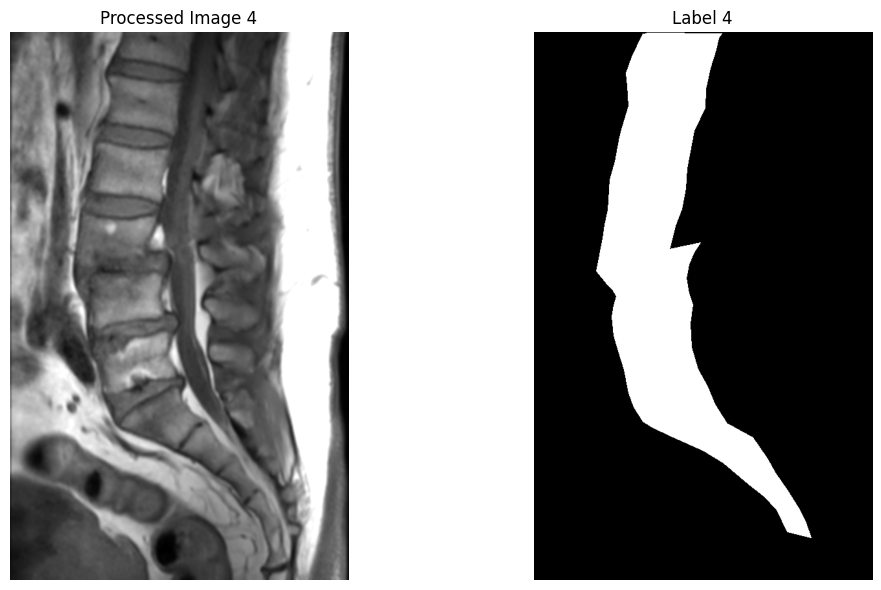

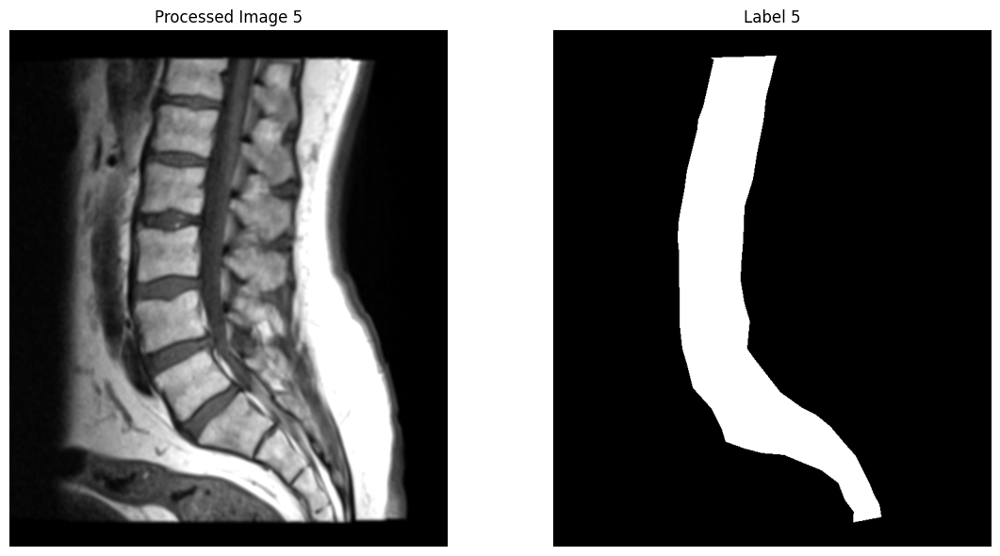

In [110]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntü ve etiketleri yükleyen fonksiyon
def GetImageLabel(imgStr, labelStr, draw=False):
    """
    Görüntü ve etiket dosyalarını yükler ve isteğe bağlı olarak görselleştirir.
    """
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    if draw:
        # Görüntü ve etiketleri yan yana çiz
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')

        plt.tight_layout()
        plt.show()
    return img, label

# Görüntü ve etiket dosyalarının yolları
image_paths = [
    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png",
    r"./DB/images/img (4).png",
    r"./DB/images/img (5).png"
]

label_paths = [
    r"./DB/labels/label (1).png",
    r"./DB/labels/label (2).png",
    r"./DB/labels/label (3).png",
    r"./DB/labels/label (4).png",
    r"./DB/labels/label (5).png"
]

# Görüntü işleme adımları
def process_image(image_path, label_path):
    """
    Görüntüyü işler ve etiketi döndürür.
    """
    # Görüntü ve etiketi yükle
    img, label = GetImageLabel(image_path, label_path, draw=False)

    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0
    normalized_image = (normalized_image * 255).astype(np.uint8)

    # Ortalama Filtreleme
    def mean_filter(image, kernel_size=5):
        """
        Ortalama filtre uygular.
        """
        return cv2.blur(image, (kernel_size, kernel_size))

    mean_filtered = mean_filter(normalized_image, kernel_size=5)

    # Parlaklık Artırma
    brightness_increase = 20
    brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

    return brightened_image, label

# İşlenmiş görüntüleri ve etiketleri saklamak için listeler
brightened_images = []
labels = []

# Görüntüleri işleme ve görselleştirme
for i, (image_path, label_path) in enumerate(zip(image_paths, label_paths)):
    # Görüntüyü işleme
    brightened_image, label = process_image(image_path, label_path)
    brightened_images.append(brightened_image)
    labels.append(label)

    # İşlenmiş görüntüyü ve etiketi görselleştirme
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(brightened_image, cmap='gray')
    plt.title(f"Processed Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(label, cmap='gray')
    plt.title(f"Label {i+1}")
    plt.axis('off')

    plt.tight_layout()
    plt.show()


# Kod Özeti

Bu kod, görüntüler üzerinde siyah olmayan pikselleri tespit eder ve bu noktaları kırmızı dairelerle işaretleyerek görselleştirir. Ayrıca, her bir işlenmiş görüntüdeki siyah olmayan piksellerin sayısını ekrana yazdırır.

---

### Adımlar:

1. **Çizim Fonksiyonu (`Drawing`)**:
   - `Drawing` fonksiyonu, verilen görüntü üzerinde belirtilen noktaların (piksel koordinatları) etrafında kırmızı daireler çizer.
   - Bu fonksiyon, noktaları işaretlemek için belirli bir `circle_radius` kullanır ve görselleştirir.

2. **Siyah Olmayan Pikselleri Bulma (`GetNonBlackPixels`)**:
   - Görüntü, üst ve alt yarılara ayrılır.
   - Her iki yarıda, siyah olmayan piksellerin koordinatları (`> 70` değeri) tespit edilir.
   - Bu pikseller, hem üst hem de alt yarıdan birleştirilir ve seyrekleştirilir (isteğe bağlı olarak).
   - Eğer `draw=True` ise, tespit edilen pikseller `Drawing` fonksiyonu ile işaretlenir.

3. **Görselleştirme**:
   - `brightened_images` üzerinde her bir görüntü için `GetNonBlackPixels` fonksiyonu çağrılır.
   - Siyah olmayan piksellerin sayısı yazdırılır ve işaretlenmiş görüntü görselleştirilir.

---

### Kullanım:

- **Görüntü İşleme**: Her bir işlenmiş görüntüdeki siyah olmayan piksellerin koordinatları tespit edilir.
- **Görselleştirme**: Tespit edilen siyah olmayan pikseller, kırmızı dairelerle işaretlenir ve görselleştirilir.
- **Boyut Bilgisi**: Her bir işlenmiş görüntüde tespit edilen siyah olmayan piksellerin sayısı ekrana yazdırılır.


Görüntü 1 için siyah olmayan pikseller tespit ediliyor...


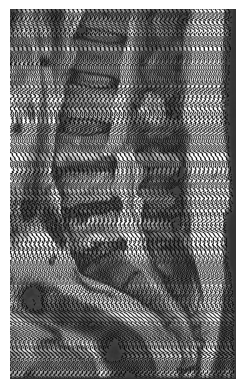

Görüntü 1: Tespit edilen siyah olmayan piksel sayısı: 42781
Görüntü 2 için siyah olmayan pikseller tespit ediliyor...


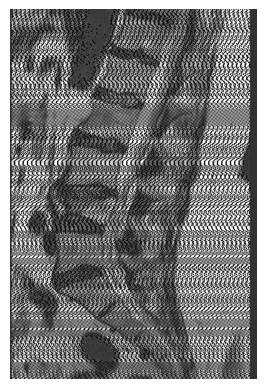

Görüntü 2: Tespit edilen siyah olmayan piksel sayısı: 45724
Görüntü 3 için siyah olmayan pikseller tespit ediliyor...


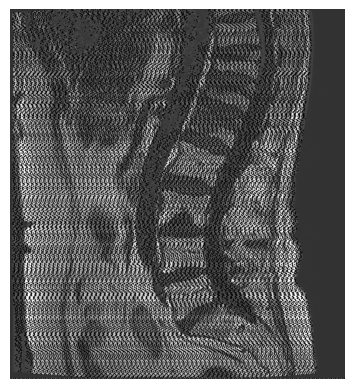

Görüntü 3: Tespit edilen siyah olmayan piksel sayısı: 52861
Görüntü 4 için siyah olmayan pikseller tespit ediliyor...


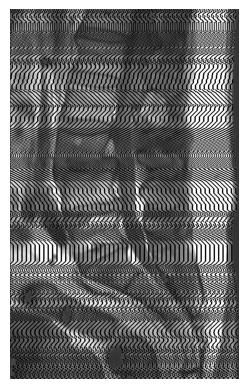

Görüntü 4: Tespit edilen siyah olmayan piksel sayısı: 43380
Görüntü 5 için siyah olmayan pikseller tespit ediliyor...


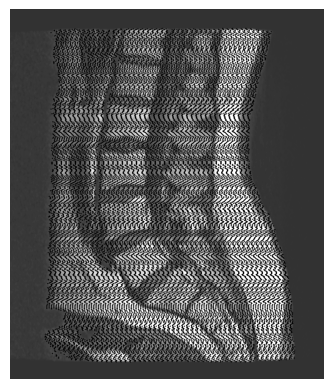

Görüntü 5: Tespit edilen siyah olmayan piksel sayısı: 32438


In [111]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Önceden tanımlı Drawing fonksiyonu
def Drawing(img, EdgePoints, circle_radius=10):
    """
    Görüntü üzerinde belirtilen koordinatlarda kırmızı noktalar çizer.
    """
    img_copy = img.copy()
    for point in EdgePoints:
        cv2.circle(img_copy, tuple(point[::-1]), circle_radius, (0, 0, 255), -1)  # Kırmızı nokta çizer
    plt.imshow(img_copy, cmap='gray')
    plt.axis('off')  # Eksenleri kapat
    plt.show()

# Siyah olmayan pikselleri alan fonksiyon
def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    """
    Siyah olmayan pikselleri tespit eder ve isteğe bağlı olarak görselleştirir.
    """
    # Görüntünün boyutlarını al
    height, width = img.shape

    # Görüntüyü yukarı ve aşağı olarak iki bölgeye ayır
    top_half = img[:height // 2, :]
    bottom_half = img[height // 2:, :]

    # Yukarı bölge için eşikleme
    y_top, x_top = np.where(top_half > 70)
    pixels_top = np.vstack((y_top, x_top)).T

    # Aşağı bölge için eşikleme
    y_bottom, x_bottom = np.where(bottom_half > 70)
    y_bottom += height // 2  # Aşağı bölgenin y koordinatını düzelt
    pixels_bottom = np.vstack((y_bottom, x_bottom)).T

    # Yukarı ve aşağı bölgelerin piksellerini birleştir
    pixels = np.vstack((pixels_top, pixels_bottom))

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]

    # Çizim yapmak istenirse
    if draw:
        Drawing(img, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# Görüntü ve etiket yolları
image_paths = [
    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png",
    r"./DB/images/img (4).png",
    r"./DB/images/img (5).png"
]

# İşlenmiş görüntüleri saklamak için liste
brightened_images = []

# Görüntü işleme (örnek bir işleme adımı, parlaklık artırımı)
for image_path in image_paths:
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Görüntüyü yükle
    brightened_image = cv2.add(img, 50)  # Parlaklık artır
    brightened_images.append(brightened_image)

# Her bir işlenmiş görüntü için siyah olmayan pikselleri al ve çiz
for i, img in enumerate(brightened_images, start=1):
    print(f"Görüntü {i} için siyah olmayan pikseller tespit ediliyor...")
    # Siyah olmayan pikselleri al
    test_img_Points = GetNonBlackPixels(img, sparsity_factor=10, circle_radius=1, draw=True)
    print(f"Görüntü {i}: Tespit edilen siyah olmayan piksel sayısı: {len(test_img_Points)}")


# Kod Özeti

Bu kod, işlenmiş görüntüler üzerinde siyah olmayan pikselleri tespit eder ve bu noktaların etrafındaki bölgelerden patch'ler (yama) çıkararak bunları bir sözlükte saklar. Ayrıca, her görüntü için tespit edilen patch'lerin sayısını yazdırır ve ilk birkaç patch'i görselleştirir.

---

### Adımlar:

1. **Siyah Olmayan Pikselleri Tespit Etme (`GetNonBlackPixels`)**:
   - Görüntüdeki siyah olmayan piksellerin koordinatları tespit edilir. 
   - `sparsity_factor` ile daha az piksel seçilmesi sağlanır.
   - Eğer `draw=True` ise, bu noktalar görselleştirilir.

2. **Patch Alma (`GetPatchsFromNonBlackPixels`)**:
   - Siyah olmayan pikseller etrafında belirtilen boyutta patch'ler çıkarılır.
   - Görüntü sınırları dışındaki pikseller için patch çıkarılmaz.
   - `draw=True` seçeneğiyle patch'ler görselleştirilebilir.

3. **Patch'leri Saklama ve Görselleştirme**:
   - Her bir işlenmiş görüntü için siyah olmayan pikseller tespit edilir ve bu pikseller etrafından patch'ler çıkarılır.
   - Her bir görüntüye ait patch'ler ve patch bilgileri bir sözlükte saklanır.
   - Patch'lerin sayısı yazdırılır ve bazı patch'ler görselleştirilir.

In [151]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Siyah olmayan pikselleri bulma fonksiyonu
def GetNonBlackPixels(img, sparsity_factor=50, draw=False, circle_radius=5):
    """
    Görüntüde siyah olmayan pikselleri tespit eder ve isteğe bağlı olarak bu noktaları görselleştirir.
    """
    y, x = np.where(img > 0)  # Siyah olmayan pikselleri bul
    pixels = np.vstack((y, x)).T  # Y ve X koordinatlarını birleştir

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]  # Daha az piksel seç

    # Çizim yapmak istenirse
    if draw:
        img_copy = img.copy()
        for point in pixels:
            cv2.circle(img_copy, tuple(point[::-1]), circle_radius, (255, 0, 0), -1)  # Kırmızı noktalar
        plt.figure(figsize=(10, 10))
        plt.imshow(img_copy, cmap='gray')
        plt.axis('off')
        plt.title("Siyah Olmayan Pikseller")
        plt.show()

    return pixels

# Patch'leri alma fonksiyonu
def GetPatchsFromNonBlackPixels(img, NonBlackPixels, PatchSize=50, draw=False):
    """
    Siyah olmayan pikseller etrafından belirlenen boyutta patch'ler çıkarır.
    """
    Patchs = []
    PatchsInfo = []
    rows, cols = img.shape

    for y, x in NonBlackPixels:
        # Yama sınırlarını kontrol ederek al
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Yama görüntü sınırların dışında, atla
            continue

        Patch = img[y_start:y_end, x_start:x_end]
        Patchs.append(Patch)
        PatchsInfo.append((x, y, PatchSize))

    # İsteğe bağlı olarak patch'leri görselleştir
    if draw:
        img_copy = img.copy()
        for (x, y, size) in PatchsInfo:
            cv2.rectangle(img_copy, (y - size, x - size), (y + size, x + size), (255, 0, 0), 2)
        plt.figure(figsize=(10, 10))
        plt.imshow(img_copy, cmap='gray')
        plt.axis('off')
        plt.title("Patch'ler")
        plt.show()

    return Patchs, PatchsInfo

# Patch almak için fonksiyonu her bir görüntüde uygulamak
patches_dict = {}  # Her bir görüntü için patch'leri saklayacak bir sözlük

# Görüntülerin listesi ve isimleri
# Örnek olarak işlenmiş (brightened) görüntüleri kullandığımızı varsayıyoruz
sharpened_images = brightened_images  # İşlenmiş görüntüler
image_names = [
    'test_sharpened_image1',
    'test_sharpened_image2',
    'test_sharpened_image3',
    'test_sharpened_image4',
    'test_sharpened_image5'
]

# Patch sayısını düşürmek için ayarlar
SPARSITY_FACTOR = 150  # Daha az piksel seçmek için artırıldı
PATCH_SIZE = 60        # Daha büyük patch'ler için artırıldı

# Her bir görüntüde siyah olmayan pikselleri al ve patch'leri oluştur
for img, img_name in zip(sharpened_images, image_names):
    print(f"Görüntü '{img_name}' için işlem başlıyor...")

    # Siyah olmayan pikselleri al
    non_black_pixels = GetNonBlackPixels(img, sparsity_factor=SPARSITY_FACTOR, circle_radius=1, draw=False)

    # Patch'leri al
    patches, patch_info = GetPatchsFromNonBlackPixels(img, non_black_pixels, PatchSize=PATCH_SIZE, draw=False)

    # Görüntü ismi ile patch'leri sözlüğe ekle
    patches_dict[img_name] = {
        'patches': patches,
        'patch_info': patch_info
    }

    # Her görüntü için tespit edilen patch sayısını yazdır
    print(f"{img_name} için toplam patch sayısı: {len(patches)}")

# Patch'lere erişmek için
for img_name, patch_data in patches_dict.items():
    print(f"{img_name} için toplam patch sayısı: {len(patch_data['patches'])}")

# İlk birkaç patch'i görselleştirme
for img_name in patches_dict:
    print(f"\n{img_name} için bazı patch bilgileri:")
    for i, (patch, info) in enumerate(zip(patches_dict[img_name]['patches'], patches_dict[img_name]['patch_info'][:5]), start=1):
        print(f"Patch {i}: Konum = {info[:2]}, Boyut = {info[2]}")


Görüntü 'test_sharpened_image1' için işlem başlıyor...
test_sharpened_image1 için toplam patch sayısı: 1980
Görüntü 'test_sharpened_image2' için işlem başlıyor...
test_sharpened_image2 için toplam patch sayısı: 2218
Görüntü 'test_sharpened_image3' için işlem başlıyor...
test_sharpened_image3 için toplam patch sayısı: 3204
Görüntü 'test_sharpened_image4' için işlem başlıyor...
test_sharpened_image4 için toplam patch sayısı: 1967
Görüntü 'test_sharpened_image5' için işlem başlıyor...
test_sharpened_image5 için toplam patch sayısı: 2450
test_sharpened_image1 için toplam patch sayısı: 1980
test_sharpened_image2 için toplam patch sayısı: 2218
test_sharpened_image3 için toplam patch sayısı: 3204
test_sharpened_image4 için toplam patch sayısı: 1967
test_sharpened_image5 için toplam patch sayısı: 2450

test_sharpened_image1 için bazı patch bilgileri:
Patch 1: Konum = (120, 60), Boyut = 60
Patch 2: Konum = (270, 60), Boyut = 60
Patch 3: Konum = (420, 60), Boyut = 60
Patch 4: Konum = (197, 61), 

# Kod Özeti

Bu kod, verilen test görüntülerinden patch'ler çıkarır, her patch için HOG (Histogram of Oriented Gradients) özelliklerini hesaplar ve bunları belirtilen dosya yoluna kaydeder. Ayrıca, her bir görüntü için HOG özelliklerinin başarıyla kaydedildiğini konsola yazdırır.

---

### Adımlar:

1. **HOG Özelliklerini Hesaplama (`compute_hog_features`)**:
   - Görüntüden HOG özellikleri çıkarılır.
   - Özellikler, belirli bir yön sayısı, hücre boyutu ve blok boyutu ile hesaplanır.

2. **Patch'lerden HOG Özelliklerini Kaydetme (`save_hog_features`)**:
   - Görüntüdeki siyah olmayan piksellerden patch'ler çıkarılır.
   - Her bir patch için HOG özellikleri hesaplanır.
   - Özellikler ve patch koordinatları sıkıştırılmış formatta kaydedilir.

3. **Test Görüntülerinin İşlenmesi**:
   - Belirtilen test görüntüleri üzerinde işlem yapılır.
   - Görüntüler yüklenir, siyah olmayan piksellerden patch'ler çıkarılır ve HOG özellikleri hesaplanıp kaydedilir.

---

### Kullanım:

- **HOG Hesaplama**: Görüntülerden HOG özellikleri çıkarılır.
- **Patch Çıkarmak**: Siyah olmayan piksellerden belirli boyutlarda patch'ler çıkarılır.
- **Veri Kaydetme**: HOG özellikleri ve patch koordinatları sıkıştırılmış bir dosyaya kaydedilir.

In [152]:
import numpy as np
import cv2
from skimage.feature import hog
import os

# HOG Özelliklerini Hesaplama Fonksiyonu
def compute_hog_features(image, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    """
    Görüntüden HOG özelliklerini çıkarır.
    """
    features, _ = hog(
        image,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        visualize=True
    )
    return features

# Patchlerden HOG Özelliklerini Kaydetme
def save_hog_features(image, output_file, sparsity_factor=100, patch_size=50, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    """
    Görüntüden patchler çıkararak HOG özelliklerini ve koordinatlarını kaydeder.
    """
    # Siyah olmayan pikselleri bul
    non_black_pixels = np.argwhere(image > 0)[::sparsity_factor]
    print(f"Toplam seçilen piksel sayısı: {len(non_black_pixels)}")

    hog_features = []
    patch_coords = []

    for (y, x) in non_black_pixels:
        # Patch sınırlarını kontrol et
        y_start, y_end = max(0, y - patch_size), min(image.shape[0], y + patch_size)
        x_start, x_end = max(0, x - patch_size), min(image.shape[1], x + patch_size)
        
        # Patch'i al
        patch = image[y_start:y_end, x_start:x_end]
        if patch.size == 0 or patch.shape[0] < patch_size * 2 or patch.shape[1] < patch_size * 2:
            continue

        # HOG Özelliklerini Hesapla
        features = compute_hog_features(
            patch, 
            orientations=orientations,
            pixels_per_cell=pixels_per_cell,
            cells_per_block=cells_per_block
        )
        hog_features.append(features)
        patch_coords.append((y, x))

    # Özellikleri sıkıştırılmış formatta kaydet
    os.makedirs(os.path.dirname(output_file), exist_ok=True)
    np.savez_compressed(output_file, hog_features=hog_features, coords=patch_coords)
    print(f"HOG özellikleri başarıyla kaydedildi: {output_file}. Toplam patch sayısı: {len(hog_features)}")

# Test Görüntüleri
test_image_paths = [
    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png",
    r"./DB/images/img (4).png",
    r"./DB/images/img (5).png"
]

# Çıktı Dosya Yolları
output_hog_files = [
    r"./DB/output/hog_features/test_image1_hog_features.npz",
    r"./DB/output/hog_features/test_image2_hog_features.npz",
    r"./DB/output/hog_features/test_image3_hog_features.npz",
    r"./DB/output/hog_features/test_image4_hog_features.npz",
    r"./DB/output/hog_features/test_image5_hog_features.npz"
]

# Görüntü İşleme ve HOG Kaydetme
for test_image_path, output_file in zip(test_image_paths, output_hog_files):
    # Görüntüyü Yükle
    image = cv2.imread(test_image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        print(f"Görüntü bulunamadı: {test_image_path}. Atlanıyor...")
        continue

    # Görüntüden HOG Özelliklerini Kaydet
    save_hog_features(image, output_file, sparsity_factor=150, patch_size=30)


Toplam seçilen piksel sayısı: 2970
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features/test_image1_hog_features.npz. Toplam patch sayısı: 2465
Toplam seçilen piksel sayısı: 3156
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features/test_image2_hog_features.npz. Toplam patch sayısı: 2726
Toplam seçilen piksel sayısı: 3970
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features/test_image3_hog_features.npz. Toplam patch sayısı: 3561
Toplam seçilen piksel sayısı: 2964
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features/test_image4_hog_features.npz. Toplam patch sayısı: 2461
Toplam seçilen piksel sayısı: 2823
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features/test_image5_hog_features.npz. Toplam patch sayısı: 2670


# Kod Özeti

Bu kod, verilen test görüntüleri ve etiketler ile birlikte HOG (Histogram of Oriented Gradients) özelliklerini kullanarak çapraz korelasyonu hesaplar ve yüksek korelasyonlu bölgeleri görselleştirir. Görüntülerin etiketleri ve çıktı görüntüleri ile birlikte, korelasyon eşleşmelerini işaretler.

---

### Adımlar:

1. **Çapraz Korelasyon Fonksiyonu (`compute_cross_correlation_optimized`)**:
   - İki vektör dizisi arasındaki çapraz korelasyonu hesaplar. Korelasyon mesafesi, özellik vektörleri arasındaki benzerliği ölçer.

2. **Görüntü ve Etiket Yükleme**:
   - Her bir test görüntüsü ve etiket dosyası yüklenir.
   - HOG dosyaları kontrol edilir ve yüklenir.

3. **HOG Özellikleri ile Korelasyon Hesaplama**:
   - Her bir test görüntüsü için, HOG özellikleri ve koordinatları yüklenir.
   - Çapraz korelasyon matrisi hesaplanır.
   - Korelasyon eşiği belirlenir ve yüksek korelasyonlu bölgeler işaretlenir.

4. **Görselleştirme**:
   - Orijinal test görüntüsü, etiket görüntüsü ve sonuç görüntüsü yan yana görselleştirilir.
   - Yüksek korelasyonlu eşleşmeler beyaz dairelerle işaretlenir.


İşleniyor: ./DB/images/img (1).png...
İşleniyor: ./DB/images/img (2).png...
İşleniyor: ./DB/images/img (3).png...
İşleniyor: ./DB/images/img (4).png...
İşleniyor: ./DB/images/img (5).png...


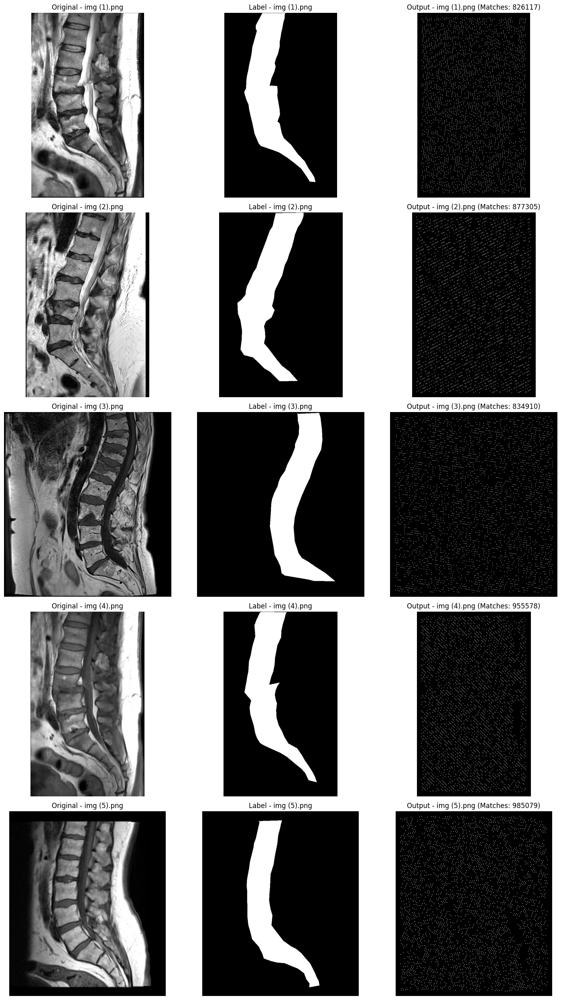

In [153]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist
import os

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    """
    İki vektör dizisi arasında çapraz korelasyonu hesaplar.
    """
    return 1 - cdist(vectors1, vectors2, metric='correlation')  # Korelasyon mesafesi

# Test görüntüleri ve etiket yolları
test_image_paths = [
    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png",
    r"./DB/images/img (4).png",
    r"./DB/images/img (5).png"
]

label_image_paths = [
    r"./DB/labels/label (1).png",
    r"./DB/labels/label (2).png",
    r"./DB/labels/label (3).png",
    r"./DB/labels/label (4).png",
    r"./DB/labels/label (5).png"
]

hog_files = [
    r"./DB/output/hog_features/test_image1_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image2_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image3_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image4_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image5_hog_features_with_coords.npz"
]

# Görüntü işleme ve çapraz korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))

for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    print(f"İşleniyor: {test_image_path}...")

    # HOG dosyasını kontrol et ve yükle
    if not os.path.exists(hog_file):
        print(f"HOG dosyası bulunamadı: {hog_file}. Atlanıyor...")
        continue

    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['hog_features']
    test_coords = hog_data['coords']

    # Test görüntüsünü yükle
    test_image = cv2.imread(test_image_path, cv2.IMREAD_COLOR)
    if test_image is None:
        print(f"Test görüntüsü bulunamadı: {test_image_path}. Atlanıyor...")
        continue

    output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma

    # Etiket görüntüsünü yükle
    label_image = cv2.imread(label_image_path, cv2.IMREAD_COLOR)
    if label_image is None:
        print(f"Etiket görüntüsü bulunamadı: {label_image_path}. Atlanıyor...")
        continue

    # Çapraz korelasyonu hesapla
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, test_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyon eşleşmelerini işleme
    matching_coords_count = 0
    for test_idx, _ in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 1, (255, 255, 255), -1)
        matching_coords_count += 1

    # Görüntü adını dosya yolundan çıkar
    image_name = os.path.basename(test_image_path)

    # Orijinal görüntü, etiket ve çıktı görselleştirme
    plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original - {image_name}")
    plt.axis('off')

    plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
    plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Label - {image_name}")
    plt.axis('off')

    plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Output - {image_name} (Matches: {matching_coords_count})")
    plt.axis('off')

plt.tight_layout()
plt.show()


# Kod Özeti

Bu kod, test görüntüleri ile etiket görüntüleri arasındaki **Intersection over Union (IoU)** değerlerini hesaplar ve karşılaştırma yapmak için HOG (Histogram of Oriented Gradients) özelliklerini kullanır. Çapraz korelasyon hesaplanarak eşleşen bölgeler işaretlenir ve her bir görüntü için IoU değeri hesaplanıp görselleştirilir.

---

### Adımlar:

1. **IoU Hesaplama Fonksiyonu (`calculate_iou`)**:
   - Çıktı görüntüsü ile etiket görüntüsü arasındaki **Intersection over Union** (IoU) değerini hesaplar.
   - İki ikili görüntü arasındaki ortak piksel sayısı ile birleşim bölgesinin oranını hesaplar.

2. **Çapraz Korelasyon Fonksiyonu (`compute_cross_correlation_optimized`)**:
   - HOG özellik vektörleri arasındaki çapraz korelasyonu hesaplar.
   - Korelasyon mesafesi, iki vektör arasındaki benzerliği ölçer.

3. **HOG Özelliklerinin Yüklenmesi ve Korelasyon Hesaplama**:
   - Test görüntüleri ve etiketler yüklenir.
   - HOG dosyaları kontrol edilerek yüklenir.
   - Çapraz korelasyon matrisi hesaplanır ve yüksek korelasyonlu bölgeler işaretlenir.

4. **IoU Hesaplaması ve Görselleştirme**:
   - Çapraz korelasyon ile tespit edilen bölgeler **beyaz daireler** ile işaretlenir.
   - **IoU** değeri her test görüntüsü için hesaplanır ve görselleştirilir.
   - Ortalama IoU değeri hesaplanıp grafikte gösterilir.



İşleniyor: ./DB/images/img (1).png...
Test Image 1: IoU = 0.2130
İşleniyor: ./DB/images/img (2).png...
Test Image 2: IoU = 0.2119
İşleniyor: ./DB/images/img (3).png...
Test Image 3: IoU = 0.1516
İşleniyor: ./DB/images/img (4).png...
Test Image 4: IoU = 0.2078
İşleniyor: ./DB/images/img (5).png...
Test Image 5: IoU = 0.1507

Ortalama IoU: 0.1870


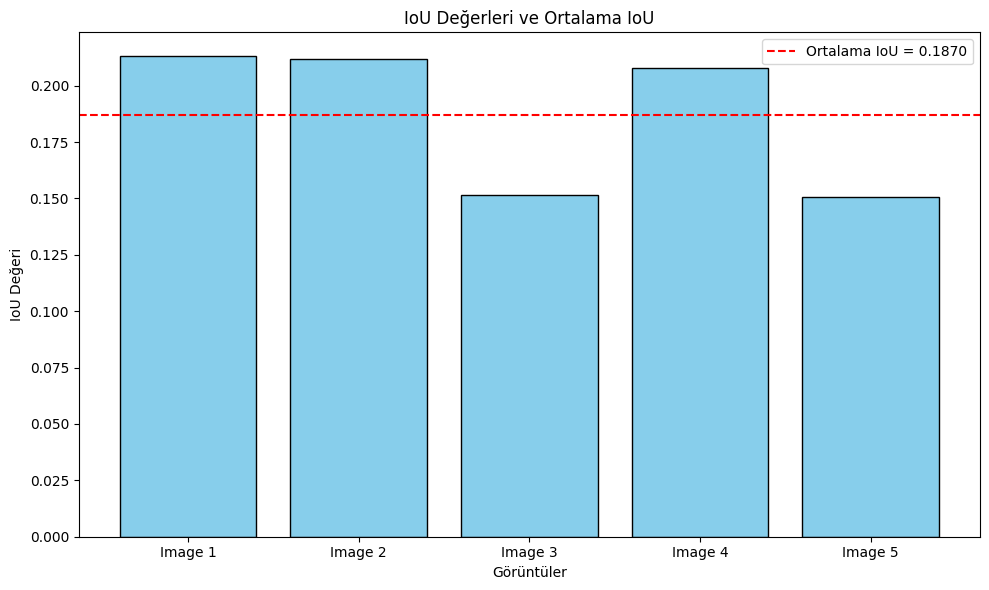

In [158]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist
import os

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    """
    Çıktı görüntüsü ile etiket görüntüsü arasındaki Intersection over Union (IoU) değerini hesaplar.
    """
    _, pred_binary = cv2.threshold(cv2.cvtColor(predicted_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(cv2.cvtColor(label_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)

    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()

    return intersection / union if union != 0 else 0

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    return 1 - cdist(vectors1, vectors2, metric='correlation')  # Korelasyon mesafesi

# Test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png",
    r"./DB/images/img (4).png",
    r"./DB/images/img (5).png"
]

label_image_paths = [
    r"./DB/labels/label (1).png",
    r"./DB/labels/label (2).png",
    r"./DB/labels/label (3).png",
    r"./DB/labels/label (4).png",
    r"./DB/labels/label (5).png"
]

hog_files = [
    r"./DB/output/hog_features/test_image1_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image2_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image3_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image4_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image5_hog_features_with_coords.npz"
]

# IoU değerlerini saklamak için bir liste
ious = []

# Görüntü işleme ve IoU hesaplama
threshold = 0.30  # Korelasyon eşiği
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    print(f"İşleniyor: {test_image_path}...")

    # HOG dosyasını kontrol et ve yükle
    if not os.path.exists(hog_file):
        print(f"HOG dosyası bulunamadı: {hog_file}. Atlanıyor...")
        continue
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['hog_features']
    test_coords = hog_data['coords']

    # Test görüntüsünü yükle
    test_image = cv2.imread(test_image_path)
    if test_image is None:
        print(f"Test görüntüsü bulunamadı: {test_image_path}. Atlanıyor...")
        continue

    output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma

    # Etiket görüntüsünü yükle
    label_image = cv2.imread(label_image_path)
    if label_image is None:
        print(f"Etiket görüntüsü bulunamadı: {label_image_path}. Atlanıyor...")
        continue

    # Çapraz korelasyonu hesapla ve eşleşmeleri işle
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, test_hog_vectors)
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    for test_idx, _ in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)  # Çıktı görüntüsünü doldur

    # IoU hesaplama
    iou = calculate_iou(output_img, label_image)
    ious.append(iou)
    print(f"Test Image {idx + 1}: IoU = {iou:.4f}")

# Ortalama IoU Hesaplama ve Grafik
if ious:
    mean_iou = np.mean(ious)
    print(f"\nOrtalama IoU: {mean_iou:.4f}")

    # IoU Değerlerini Görselleştirme
    image_names = [f"Image {i+1}" for i in range(len(ious))]
    plt.figure(figsize=(10, 6))
    plt.bar(image_names, ious, color='skyblue', edgecolor='black')
    plt.axhline(mean_iou, color='red', linestyle='--', label=f'Ortalama IoU = {mean_iou:.4f}')
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('IoU Değerleri ve Ortalama IoU')
    plt.legend()
    plt.tight_layout()
    plt.show()


# Kod Özeti

Bu kod, üç farklı görüntüyü işleyerek **normalizasyon**, **ortalama filtreleme** ve **parlaklık artırma** işlemlerini uygular. İşlenen görüntüler, her biri için **etiketli bölgeyi çıkartarak** işaretlenmiş ve maske uygulanmış hale gelir. Görüntüler görselleştirilir ve işlenmiş görüntülerin boyutları ekrana yazdırılır.

---

### Adımlar:

1. **Normalizasyon (`normalize_image`)**:
   - Görüntüdeki piksel değerlerini 0-1 aralığına normalize eder, ardından tekrar 0-255 aralığına geri döndürür.

2. **Ortalama Filtreleme (`mean_filter`)**:
   - Ortalama filtre uygular, bu işlem görüntüdeki gürültüyü azaltmak için kullanılır.

3. **Parlaklık Artırma (`increase_brightness`)**:
   - Görüntünün parlaklığını artırarak daha parlak hale getirir.

4. **Görüntü ve Etiket İşleme (`process_image`)**:
   - Yüklenen her bir görüntü üzerinde yukarıdaki adımlar uygulanır ve etiketli bölgeye maske uygulanır.



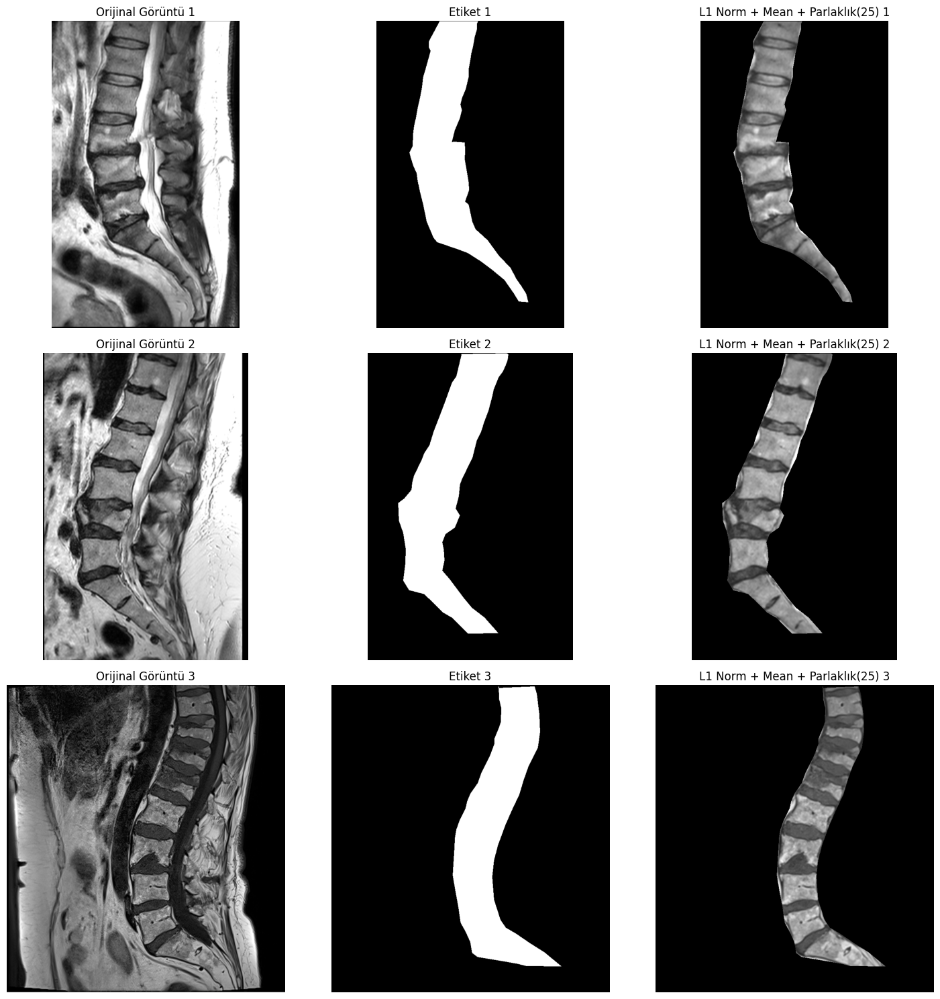

masked_image Boyutları: (856, 523)
masked_image2 Boyutları: (856, 572)
masked_image3 Boyutları: (855, 774)


In [159]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Görüntü dosyalarının yolları
image_paths = [
    r"./DB/images/img (1).png",
    r"./DB/images/img (2).png",
    r"./DB/images/img (3).png"
]

label_paths = [
    r"./DB/labels/label (1).png",
    r"./DB/labels/label (2).png",
    r"./DB/labels/label (3).png"
]

# Adım 1: I1 Norm Normalizasyonu
def normalize_image(image):
    normalized_image = image / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    return (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir

# Adım 2: Mean (Ortalama) Filtreleme
def mean_filter(image, kernel_size=5):
    return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

# Adım 3: Parlaklık Artırma
def increase_brightness(image, brightness_increase=25):
    return cv2.add(image, np.full_like(image, brightness_increase))

# Etiketli bölgeyi çıkarma işlemi
def process_image(image_path, label_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    label_image = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)  # Etiket (tek kanallı)

    # Adım 1: Normalizasyon
    normalized_image = normalize_image(image)

    # Adım 2: Ortalama Filtreleme
    mean_filtered = mean_filter(normalized_image, kernel_size=5)

    # Adım 3: Parlaklık Artırma
    brightened_image = increase_brightness(mean_filtered, brightness_increase=25)

    # Etiketli bölgeyi çıkarma (Aşındırma işlemi yok)
    masked_image = cv2.bitwise_and(brightened_image, brightened_image, mask=label_image)

    return image, label_image, masked_image

# Görselleri işleme
processed_images = [process_image(image_paths[i], label_paths[i]) for i in range(3)]

# masked_image'leri adlandırma
masked_image, masked_image2, masked_image3 = [masked for _, _, masked in processed_images]

# Sonuçları görselleştirme
plt.figure(figsize=(15, 15))

for i, (original, label, masked) in enumerate(processed_images):
    plt.subplot(3, 3, i*3+1)
    plt.title(f"Orijinal Görüntü {i+1}")
    plt.imshow(original, cmap="gray")
    plt.axis("off")

    plt.subplot(3, 3, i*3+2)
    plt.title(f"Etiket {i+1}")
    plt.imshow(label, cmap="gray")
    plt.axis("off")

    plt.subplot(3, 3, i*3+3)
    plt.title(f"L1 Norm + Mean + Parlaklık(25) {i+1}")
    plt.imshow(masked, cmap="gray")
    plt.axis("off")

plt.tight_layout()
plt.show()

# masked_image'leri kullanabilirsiniz:
print(f"masked_image Boyutları: {masked_image.shape}")
print(f"masked_image2 Boyutları: {masked_image2.shape}")
print(f"masked_image3 Boyutları: {masked_image3.shape}")


# Kod Özeti

Bu kod, görüntüler üzerinde **nokta**, **çizgi** ve **patch'leri** işaretlemek için kullanılan bir fonksiyon içerir. Görüntüdeki belirli noktalar, çizgiler ve patch'ler çizilir ve görselleştirilir. 

---

### Adımlar:

1. **Gri Tonlamalı Görüntüyü Renkli Formata Çevirme**:
   - Giriş görüntüsü gri tonlamalıdan renkli (BGR) formata dönüştürülür.

2. **Noktaların Çizilmesi (`EdgePoints`)**:
   - Verilen noktalara kırmızı daireler çizilir. Noktalar `(y, x)` formatında sağlanır ve çizim yapılır.

3. **Çizgilerin Çizilmesi (`EdgeLines`)**:
   - Verilen çizgiler, belirtilen başlangıç ve bitiş noktalarından sarı çizgilerle çizilir.

4. **Patch'lerin Çizilmesi (`EdgePatchs`)**:
   - Verilen patch'ler, belirtilen boyutlar ile dikdörtgen şeklinde çizilir. Patch numaraları mavi renk ile belirtilir.

5. **Görselleştirme**:
   - İşaretlenmiş noktalar, çizgiler ve patch'ler görüntü üzerinde görselleştirilir. Görüntü başlığı ve eksenler düzenlenir.



In [14]:
import cv2
import matplotlib.pyplot as plt

def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius=10):
    """
    Görüntü üzerine noktaları, çizgileri ve patch'leri çizmek için bir fonksiyon.
    """
    # Gri tonlamalı görüntüyü renkli formata dönüştür
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

    # Noktaları işaretle
    if EdgePoints is not None:
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # (y, x) -> (x, y)
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire

    # Çizgileri işaretle
    if EdgeLines is not None:
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color=(255, 255, 0), thickness=2)  # Sarı çizgi

    # Patch'leri işaretle
    if EdgePatchs is not None:
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  # Mavi yazı
        thickness = 2
        for k, (x, y, PatchSize) in enumerate(EdgePatchs):
            top_left = (x - PatchSize, y - PatchSize)
            bottom_right = (x + PatchSize, y + PatchSize)
            cv2.rectangle(output_img, top_left, bottom_right, (0, 0, 255), 2)  # Kırmızı dikdörtgen
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)  # Patch numarası

    # Görüntü oranına uygun figür boyutu
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)

    # Görüntüyü çiz ve göster
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=20)
    plt.axis('off')
    plt.show()


# Kod Özeti

Bu kod, **siyah olmayan piksellerin** koordinatlarını tespit eder ve görselleştirir. Verilen görüntüler üzerinde siyah olmayan pikselleri bulur, bu pikselleri görselleştirir ve toplam sayısını ekrana yazdırır.
---
### Adımlar:

1. **Siyah Olmayan Piksellerin Tespiti (`GetNonBlackPixels`)**:
   - Görüntüdeki siyah olmayan piksellerin koordinatlarını bulur.
   - **Sparsity Factor** ile bu noktaların sayısını seyreltir.
   - İsteğe bağlı olarak, noktaların görselleştirilmesi için bir fonksiyon (Drawing) kullanılır.

2. **Görsellerin Kopyalanması ve Noktaların İşaretlenmesi**:
   - İşlem yapılacak görüntülerin kopyaları oluşturulur ve her bir görüntüde siyah olmayan pikseller tespit edilir.
   - Noktalar işaretlenerek görselleştirilir.

3. **Sonuçların Görselleştirilmesi**:
   - Tespit edilen noktalar, her bir görüntü üzerinde kırmızı dairelerle işaretlenir ve görselleştirilir.

4. **Noktaların Sayısı**:
   - Her bir görüntü için tespit edilen siyah olmayan piksellerin sayısı ekrana yazdırılır.


<Figure size 1500x500 with 0 Axes>

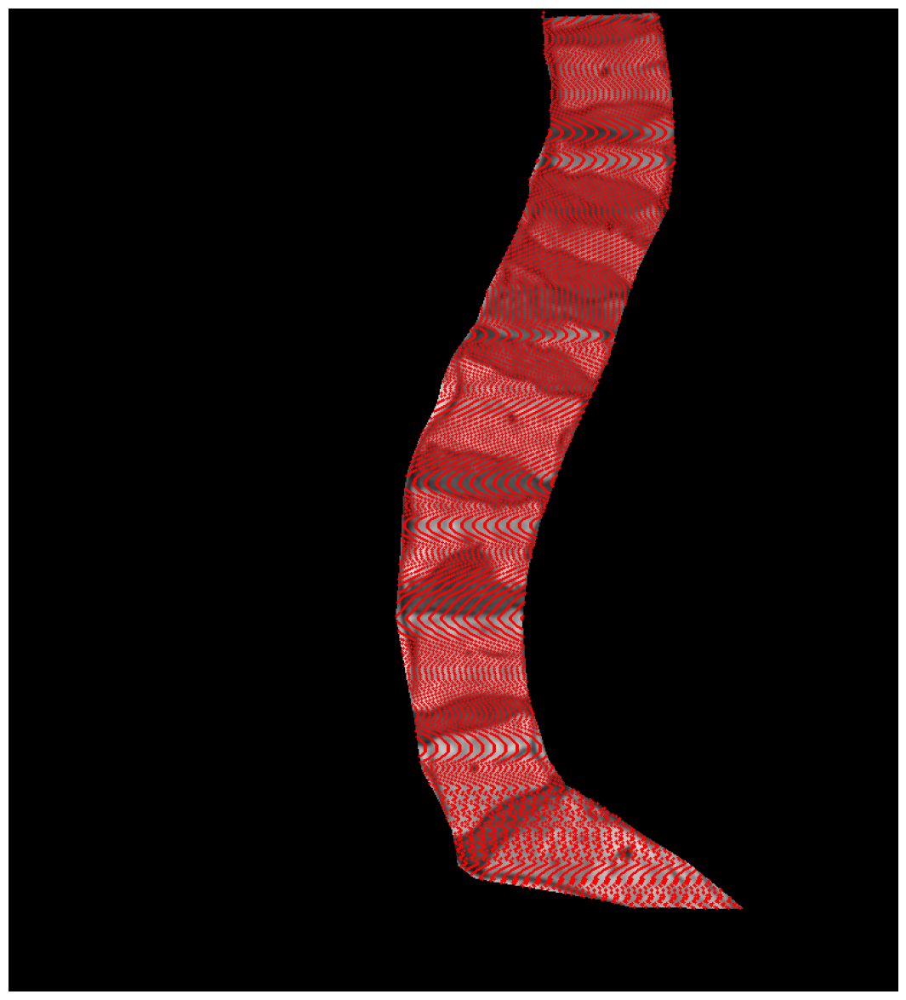

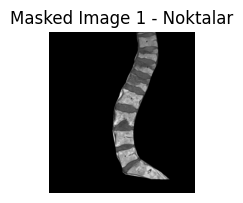

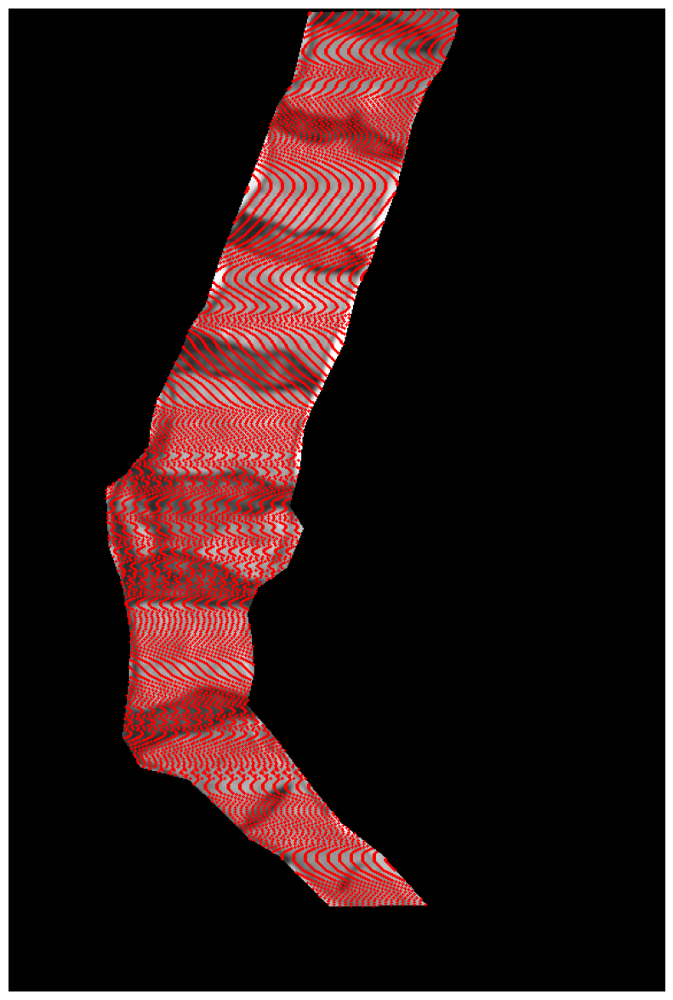

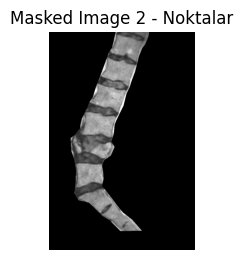

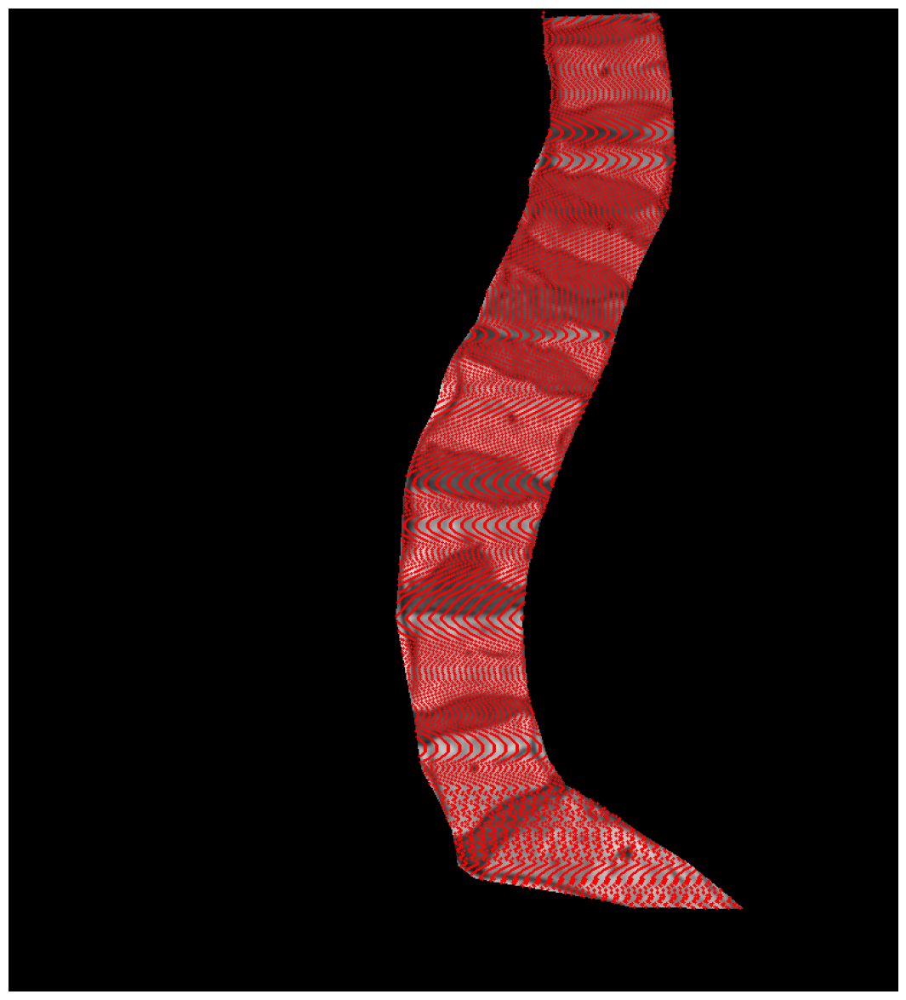

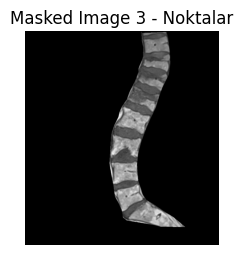

Masked Image 1 - Toplam Tespit Edilen Nokta Sayısı: 9603
Masked Image 2 - Toplam Tespit Edilen Nokta Sayısı: 9798
Masked Image 3 - Toplam Tespit Edilen Nokta Sayısı: 9603


In [162]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    """
    Siyah olmayan piksellerin koordinatlarını alır ve isteğe bağlı olarak bu noktaları görselleştirir.
    """
    # Siyah olmayan piksellerin koordinatlarını bul
    y, x = np.where(img > 0)
    pixels = np.vstack((y, x)).T  # (y, x) -> [[y1, x1], [y2, x2], ...]

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]

    # Çizim yapmak istenirse
    if draw:
        Drawing(img, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# Görseller ve başlıklar
masked_images = [masked_image, masked_image2, masked_image3]
image_titles = ["Masked Image 1", "Masked Image 2", "Masked Image 3"]

# Noktaları içeren görüntülerin kopyalarını oluştur
point_masked_images = [img.copy() for img in masked_images]

# Görselleştirme
plt.figure(figsize=(15, 5))

# Her bir görüntü için işlemleri gerçekleştir
points_list = []  # Tespit edilen noktaları saklamak için liste
for i, masked_img in enumerate(point_masked_images):
    # Siyah olmayan pikselleri al
    img_points = GetNonBlackPixels(masked_img, sparsity_factor=10, circle_radius=1, draw=True)
    points_list.append(img_points)  # Tespit edilen noktaları sakla

    # Görselleştirme
    plt.subplot(1, 3, i + 1)
    plt.imshow(masked_img, cmap='gray')
    plt.title(f"{image_titles[i]} - Noktalar")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Her bir görüntüde tespit edilen noktaların toplam sayısını yazdır
for i, points in enumerate(points_list):
    print(f"{image_titles[i]} - Toplam Tespit Edilen Nokta Sayısı: {len(points)}")


# Kod Özeti

Bu kod, siyah olmayan piksellerden **patch'ler** çıkarır ve bu patch'leri görselleştirir. Her bir görüntüdeki siyah olmayan piksellerin çevresinden patch'ler alınır, bu patch'ler görselleştirilir ve toplam patch sayısı ekrana yazdırılır.

### Adımlar:

1. **Patch Çıkarma (`GetPatchsFromNonBlackPixels`)**:
   - Siyah olmayan piksellerin çevresinden belirli boyutta patch'ler çıkarılır.
   - Patch sınırlarının görüntü dışına taşmaması sağlanır.

2. **Patch'lerin Görselleştirilmesi**:
   - `Drawing` fonksiyonu kullanılarak patch'lerin sınırları işaretlenir.
   - Patch'ler, siyah olmayan piksellerin etrafında işaretlenir ve görselleştirilir.

3. **Yamaların Sayısını Yazdırma**:
   - Her görüntüde çıkarılan patch sayısı yazdırılır.

4. **Patch Görselleştirmesi**:
   - İlk patch her görüntü için görselleştirilir. Eğer patch boyutları farklıysa normalizasyon işlemi yapılır ve görselleştirilir.



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


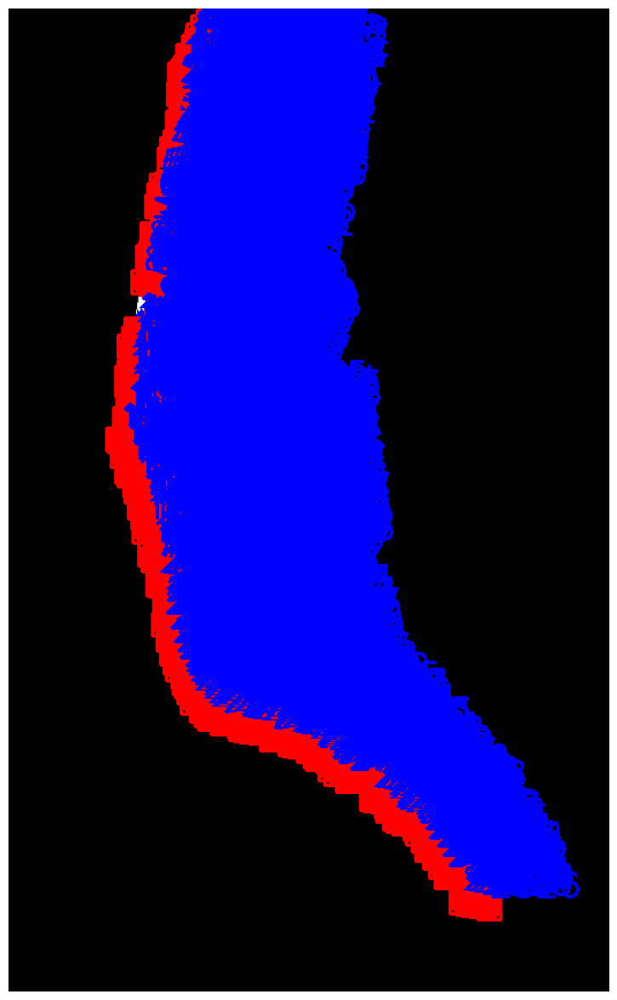

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Image 1 Patch Sayısı: 2827


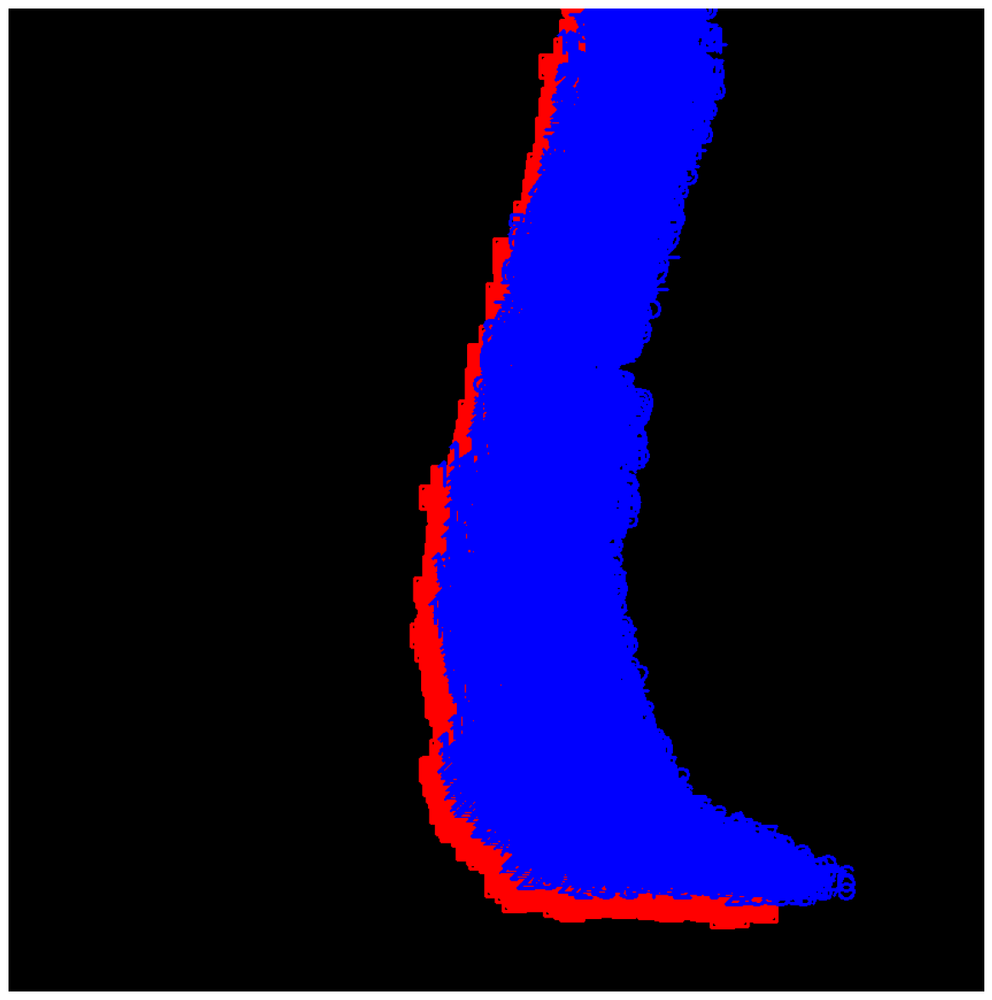

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Image 2 Patch Sayısı: 2589


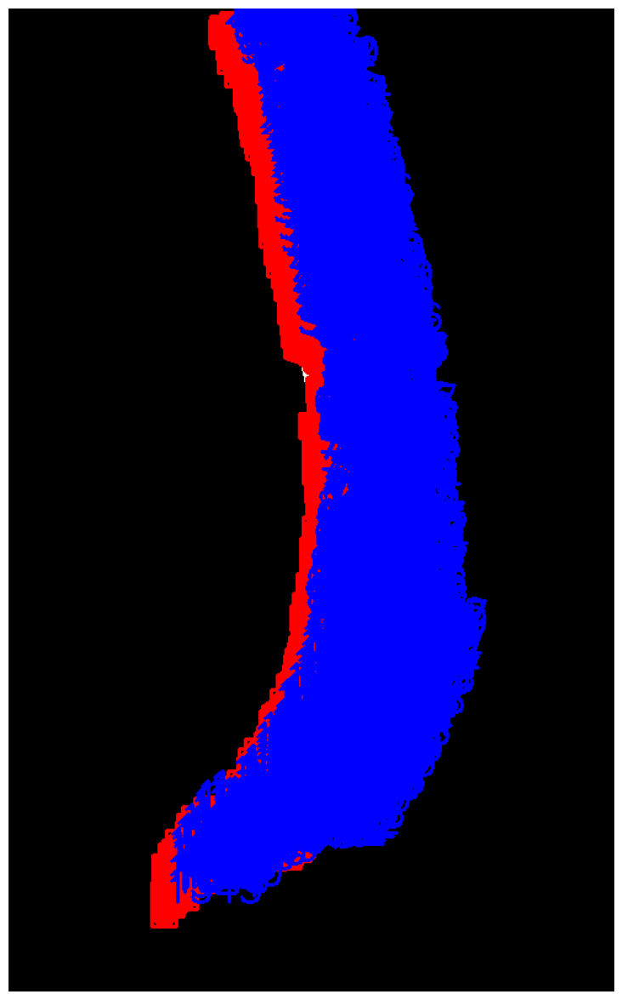

Image 3 Patch Sayısı: 1546


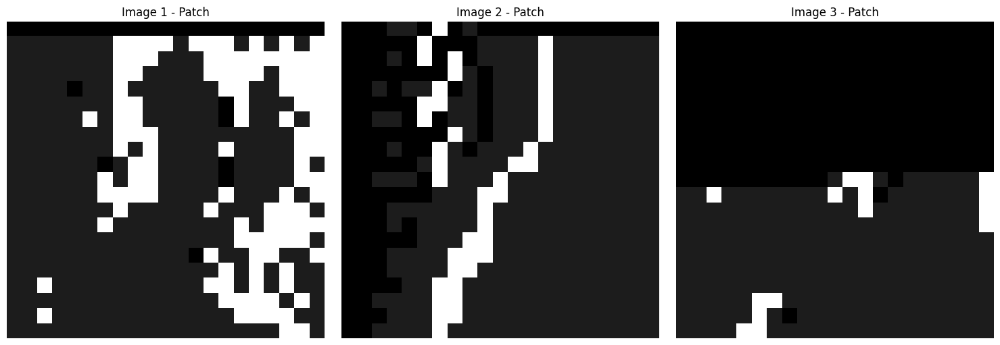

In [163]:
import numpy as np
import matplotlib.pyplot as plt

def GetPatchsFromNonBlackPixels(img, NonBlackPixels, PatchSize=11, draw=True):
    """
    Siyah olmayan piksellerden yama (patch) çıkarır ve isteğe bağlı olarak yama sınırlarını görselleştirir.
    """
    Patchs = []
    PatchsInfo = []
    rows, cols = img.shape

    for y, x in NonBlackPixels:
        # Yamayı sınır kontrolü yaparak al
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Yama görüntü sınırlarının dışında, atla
            continue

        Patch = img[y_start:y_end, x_start:x_end]
        Patchs.append(Patch)
        PatchsInfo.append((x, y, PatchSize))

    # Yamaları çizmek istenirse
    if draw:
        Drawing(img, EdgePoints=NonBlackPixels, EdgePatchs=PatchsInfo)

    return Patchs, PatchsInfo

# Patchleri çıkar ve görselleştir
patches_data = []  # Tüm görüntülerin yamalarını ve bilgilerini saklamak için
point_images = [point_masked_images1, point_masked_images2, point_masked_images3]
points_data = [img_Points1, img_Points2, img_Points3]

for i, (point_image, points) in enumerate(zip(point_images, points_data)):
    img_patches, img_patches_info = GetPatchsFromNonBlackPixels(
        point_image, points, PatchSize=10, draw=True
    )
    patches_data.append((img_patches, img_patches_info))
    print(f"Image {i + 1} Patch Sayısı: {len(img_patches)}")

# Yamaları görselleştirme
plt.figure(figsize=(15, 5))

for i, (img_patches, img_patches_info) in enumerate(patches_data):
    if len(img_patches) > 0:
        # İlk yamayı görselleştirme
        patch = img_patches[0]

        # Görselleştirme için yamayı normalize et
        if patch.dtype != np.uint8:
            patch = (patch - patch.min()) / (patch.max() - patch.min())  # [0, 1] aralığına normalizasyon

        plt.subplot(1, 3, i + 1)
        plt.imshow(patch, cmap='gray')
        plt.title(f"Image {i + 1} - Patch")
        plt.axis('off')

plt.tight_layout()
plt.show()


# Kod Özeti

Bu kod, verilen görüntülerden **patch'ler** çıkararak, her bir patch için **HOG özelliklerini** hesaplar ve bu özellikleri koordinatları ile birlikte kaydeder. 

---

### Adımlar:

1. **HOG Özelliklerinin Hesaplanması (`compute_hog_features`)**:
   - Görüntü, gri tonlamalıya dönüştürülür.
   - HOG (Histogram of Oriented Gradients) özellikleri, belirli hücre boyutları, blok boyutları ve histogram yön sayısı ile hesaplanır.
   - HOG özellikleri bir vektör halinde döndürülür.

2. **Patch'lerin Çıkartılması ve HOG Özelliklerinin Kaydedilmesi**:
   - Siyah olmayan pikseller etrafından **patch'ler** çıkarılır.
   - Çıkarılan her patch için HOG özellikleri hesaplanır.
   - Özellikler ve koordinatlar birlikte **.npz** formatında kaydedilir.

3. **Çıktı Dosyası**:
   - HOG özellikleri ve koordinatlar, belirli bir dizine kaydedilir.
   - Her bir görüntü için çıkarılan patch sayısı ve HOG özelliklerinin kaydedildiği dosya adı yazdırılır.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Görüntü 1 için işlem başlıyor...


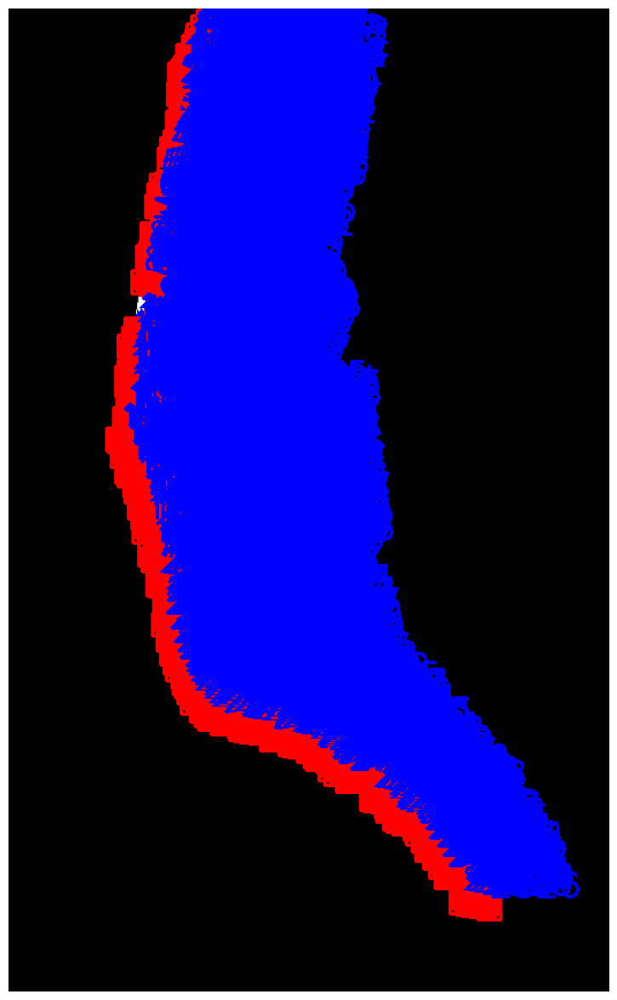

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Görüntü 1 için 2827 patch çıkarıldı.
Görüntü 2 için işlem başlıyor...


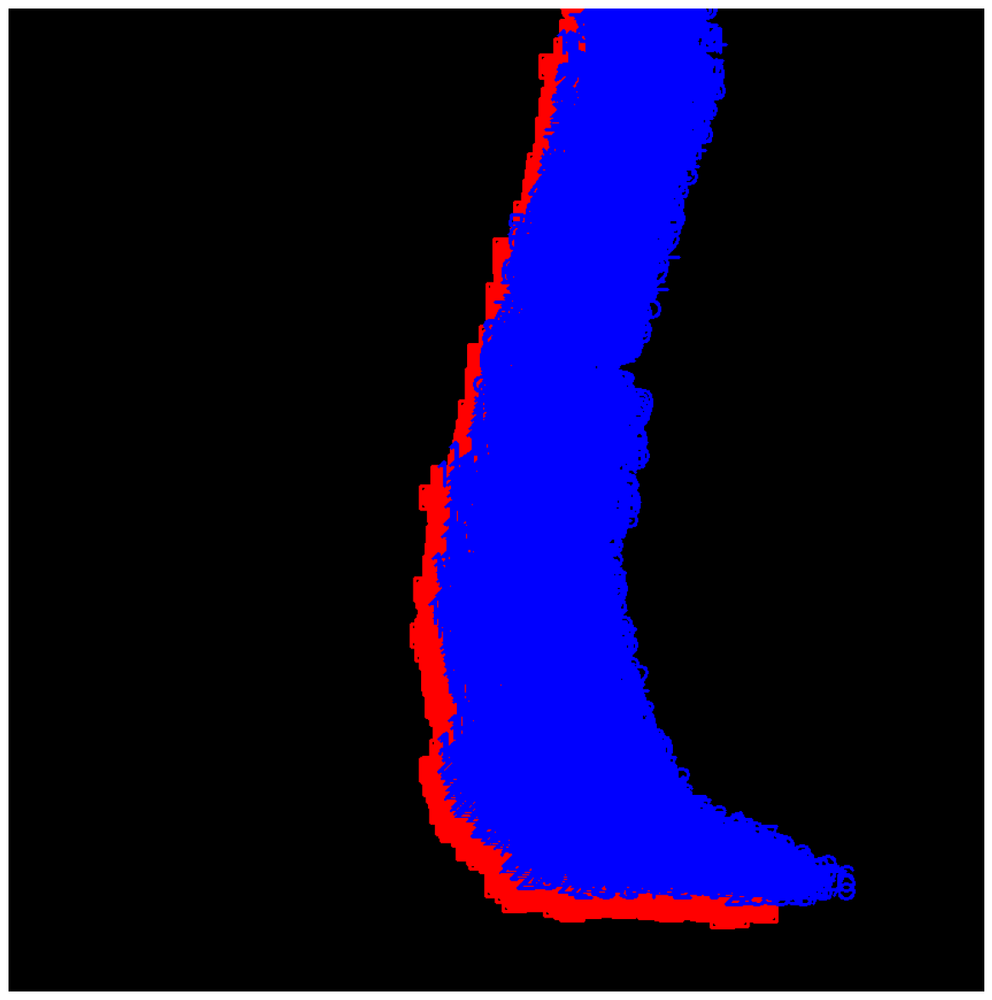

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Görüntü 2 için 2589 patch çıkarıldı.
Görüntü 3 için işlem başlıyor...


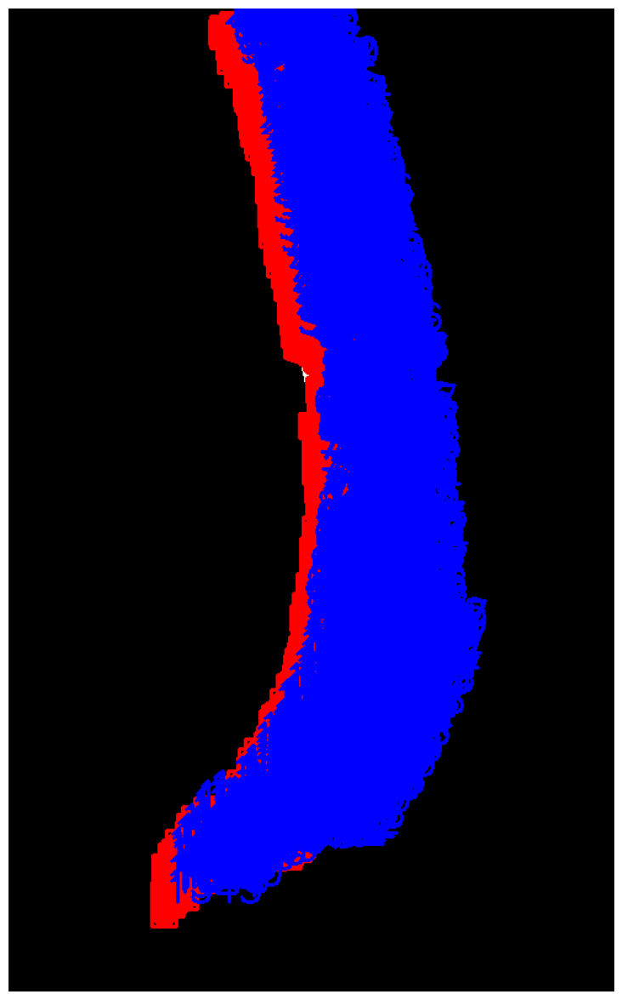

Görüntü 3 için 1546 patch çıkarıldı.
HOG özellikleri ve koordinatlar kaydedildi: ./DB/output/hog_features_with_coords.npz
Toplam 6962 patch HOG ile kodlandı.


In [165]:
import cv2
import numpy as np
import os

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Görüntüden HOG özelliklerini hesaplar.
    """
    # RGB görüntüyü gri tonlamaya dönüştür
    if image.ndim == 3:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Görüntüyü normalize et ve uint8'e dönüştür
    if image.dtype != np.uint8:
        image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # HOGDescriptor parametrelerini belirle
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1],
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    
    # HOG özelliklerini hesapla
    features = hog.compute(image)
    return features.flatten()  # Özellikleri tek boyutlu diziye dönüştür


# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerden HOG özelliklerini ve koordinatlarını hesaplayarak kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        # Her patch için HOG özelliklerini hesapla
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    # Özellikleri ve koordinatları numpy dizilerine dönüştür
    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    # Çıktı klasörünü oluştur
    os.makedirs(os.path.dirname(output_path), exist_ok=True)

    # Özellikleri ve koordinatları kaydet
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")


# Patch'leri çıkar ve HOG özelliklerini kaydet
def process_and_save_hog(point_images, points_data, output_path, patch_size=10):
    """
    Görsellerden patch'leri çıkarır, HOG özelliklerini hesaplar ve kaydeder.
    """
    all_patches = []
    all_patch_info = []

    for i, (point_image, points) in enumerate(zip(point_images, points_data)):
        print(f"Görüntü {i + 1} için işlem başlıyor...")
        patches, patch_info = GetPatchsFromNonBlackPixels(point_image, points, PatchSize=patch_size, draw=True)
        all_patches.extend(patches)
        all_patch_info.extend(patch_info)
        print(f"Görüntü {i + 1} için {len(patches)} patch çıkarıldı.")

    # HOG özelliklerini hesaplayıp kaydet
    save_hog_features_with_coords(all_patches, all_patch_info, output_path)
    print(f"Toplam {len(all_patches)} patch HOG ile kodlandı.")


# Görselleri işleme
output_file_with_coords = "./DB/output/hog_features_with_coords.npz"
point_images = [point_masked_images1, point_masked_images2, point_masked_images3]
points_data = [img_Points1, img_Points2, img_Points3]

process_and_save_hog(point_images, points_data, output_file_with_coords, patch_size=10)


# Kod Özeti

Bu kod, görüntülerin işlenmesi ve etiketlerinin alınması işlemlerini içerir. Görüntüler, normalizasyon, ortalama filtreleme ve parlaklık artırma işlemlerine tabi tutulur. Ardından, işlenmiş görüntüler ve etiketler görselleştirilir.

---

### Adımlar:

1. **Görüntü ve Etiket Yükleme (`load_image_and_label`)**:
   - Verilen dosya yollarından görüntü ve etiket dosyalarını yükler.
   - İsteğe bağlı olarak, yüklenen görüntü ve etiketlerin yan yana görselleştirilmesini sağlar.

2. **Ortalama Filtreleme (`mean_filter`)**:
   - Görüntü üzerine belirli bir çekirdek boyutunda ortalama filtre uygulayarak görüntüdeki gürültüyü azaltır.

3. **Görüntü İşleme (`process_image`)**:
   - Yüklenen görüntü üzerinde sırasıyla normalizasyon, ortalama filtreleme ve parlaklık artırma işlemleri yapılır.
   - İsteğe bağlı olarak işlenmiş görüntü ve etiket görselleştirilir.

4. **Görüntü ve Etiketlerin Görselleştirilmesi**:
   - Görüntü işleme adımlarını takip ettikten sonra, her bir görüntü için işlenmiş görüntü ve etiket görselleştirilir.


Processing Image 1...


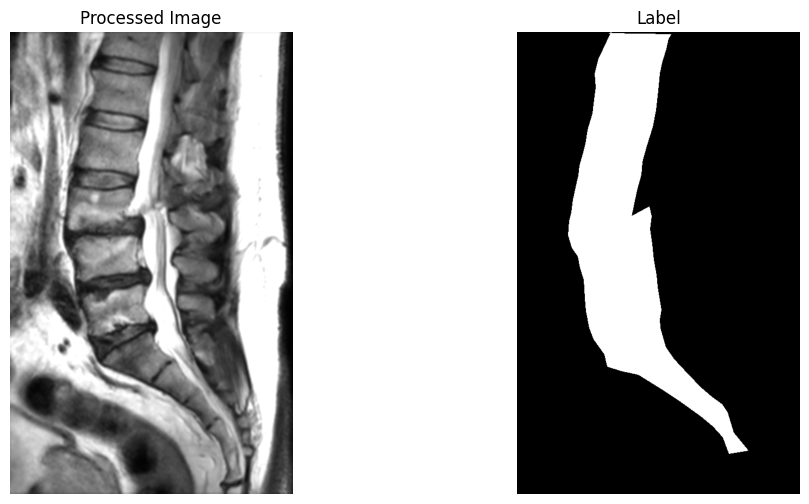

Processed Image 1 completed.
Processing Image 2...


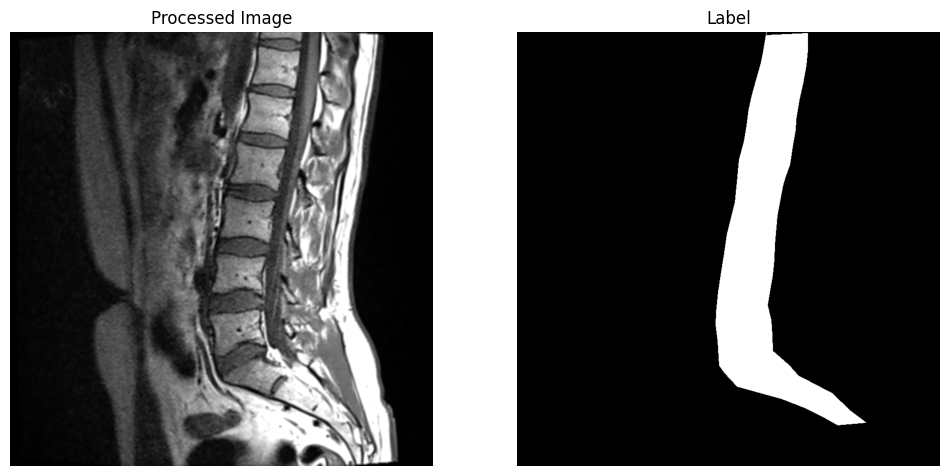

Processed Image 2 completed.
Processing Image 3...


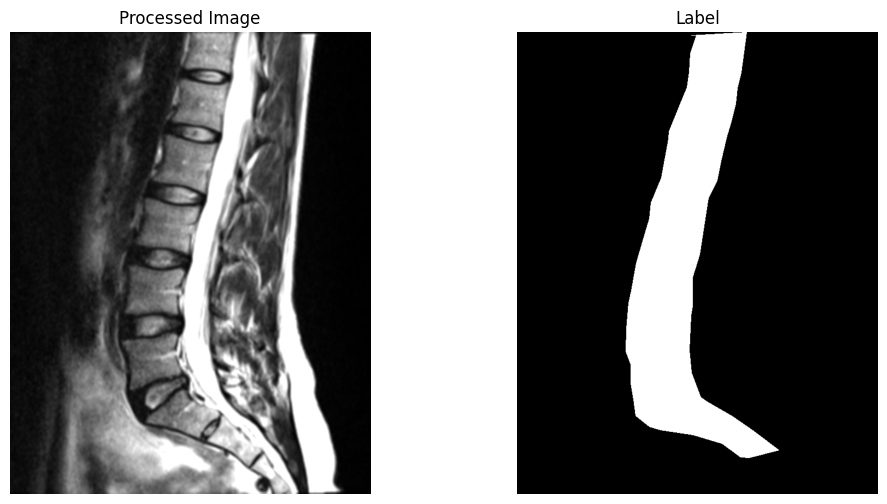

Processed Image 3 completed.
Processing Image 4...


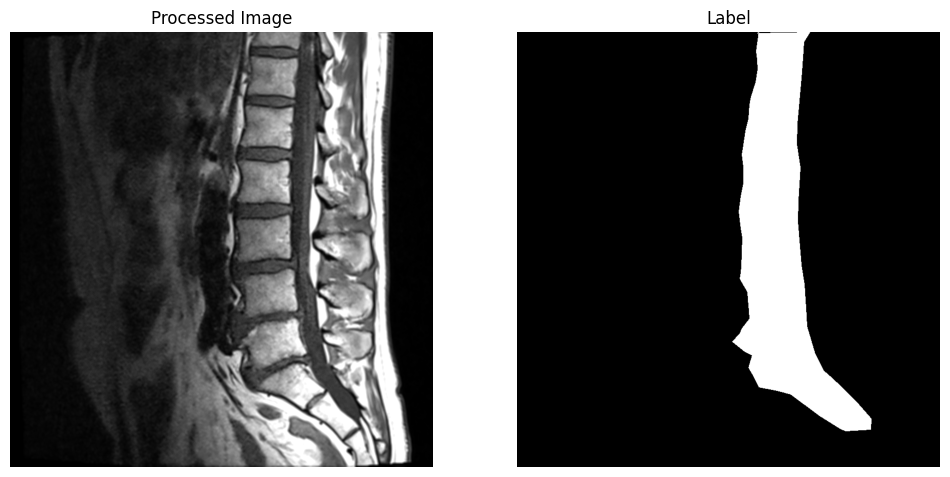

Processed Image 4 completed.
Processing Image 5...


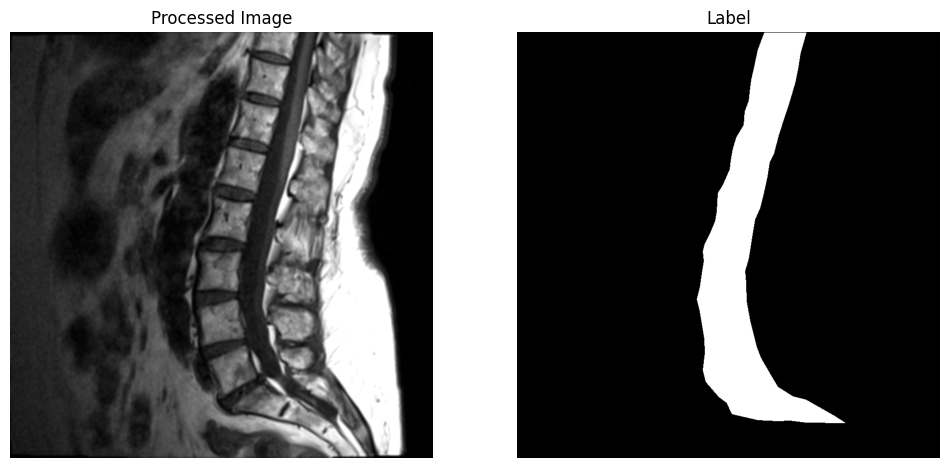

Processed Image 5 completed.

Toplam 5 görüntü işlendi.


In [167]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Görüntü ve etiketleri yükleme fonksiyonu
def load_image_and_label(image_path, label_path, draw=False):
    """
    Görüntü ve etiketi yükler, isteğe bağlı olarak görselleştirir.

    Args:
        image_path (str): Görüntü dosya yolu.
        label_path (str): Etiket dosya yolu.
        draw (bool): Görselleştirme seçeneği.

    Returns:
        tuple: Yüklenmiş görüntü ve etiket.
    """
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

    if image is None or label is None:
        raise FileNotFoundError(f"Görüntü veya etiket bulunamadı: {image_path}, {label_path}")

    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(image, cmap='gray')
        plt.title("Original Image")
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title("Label")
        plt.axis('off')
        plt.show()

    return image, label

# Ortalama filtre uygulama fonksiyonu
def mean_filter(image, kernel_size=5):
    """
    Ortalama filtre uygular.

    Args:
        image (numpy.ndarray): Giriş görüntüsü.
        kernel_size (int): Çekirdek boyutu.

    Returns:
        numpy.ndarray: Filtrelenmiş görüntü.
    """
    return cv2.blur(image, (kernel_size, kernel_size))

# Görüntü işleme fonksiyonu
def process_image(image_path, label_path, brightness_increase=20, kernel_size=5, draw=False):
    """
    Görüntüyü işler ve etiketi döndürür.

    Args:
        image_path (str): Görüntü dosya yolu.
        label_path (str): Etiket dosya yolu.
        brightness_increase (int): Parlaklık artırma miktarı.
        kernel_size (int): Ortalama filtre çekirdek boyutu.
        draw (bool): Görselleştirme seçeneği.

    Returns:
        tuple: İşlenmiş görüntü ve etiket.
    """
    # Görüntü ve etiketi yükle
    image, label = load_image_and_label(image_path, label_path, draw=False)

    # I1 Norm Normalizasyonu
    normalized_image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # Ortalama Filtreleme
    mean_filtered = mean_filter(normalized_image, kernel_size=kernel_size)

    # Parlaklık Artırma
    brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(brightened_image, cmap='gray')
        plt.title("Processed Image")
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title("Label")
        plt.axis('off')
        plt.show()

    return brightened_image, label

# Görüntü ve etiket yolları
image_paths = [
    r"./DB/images/img (6).png",
    r"./DB/images/img (7).png",
    r"./DB/images/img (8).png",
    r"./DB/images/img (9).png",
    r"./DB/images/img (10).png"
]

label_paths = [
    r"./DB/labels/label (6).png",
    r"./DB/labels/label (7).png",
    r"./DB/labels/label (8).png",
    r"./DB/labels/label (9).png",
    r"./DB/labels/label (10).png"
]

# Görüntüleri işleme
processed_images = []
processed_labels = []

for i, (image_path, label_path) in enumerate(zip(image_paths, label_paths)):
    print(f"Processing Image {i+1}...")
    brightened_image, label = process_image(image_path, label_path, brightness_increase=20, kernel_size=5, draw=True)
    processed_images.append(brightened_image)
    processed_labels.append(label)
    print(f"Processed Image {i+1} completed.")

print(f"\nToplam {len(processed_images)} görüntü işlendi.")


# Kod Özeti

Bu kod, her bir işlenmiş görüntüdeki siyah olmayan pikselleri tespit eder ve bu noktaları görselleştirir. Ayrıca, işlenen görüntüler üzerinde bu piksellerin sayısını konsola yazdırır.

---

### Adımlar:

1. **Çizim Fonksiyonu (`Drawing`)**:
   - `Drawing` fonksiyonu, verilen görüntüdeki belirli noktaların etrafında kırmızı daireler çizer.
   - Her bir nokta, belirtilen `circle_radius` değeri ile işaretlenir.

2. **Siyah Olmayan Pikselleri Bulma (`GetNonBlackPixels`)**:
   - Görüntü iki bölgeye ayrılır: üst yarı ve alt yarı.
   - Her iki bölgede de siyah olmayan piksellerin (piksel değeri 60'tan büyük) koordinatları tespit edilir.
   - Bu pikseller birleştirilir ve isteğe bağlı olarak seyrekleştirilir (`sparsity_factor` ile).
   - Eğer `draw=True` ise, tespit edilen siyah olmayan pikseller `Drawing` fonksiyonu ile işaretlenir.

3. **İşlenen Görüntüler Üzerinde Siyah Olmayan Pikselleri Çizme**:
   - `brightened_images` listesinde bulunan her bir işlenmiş görüntü için siyah olmayan pikseller tespit edilir.
   - Her bir görüntü için tespit edilen noktalar görselleştirilir ve bu noktaların sayısı konsola yazdırılır.


Processing Image 6...


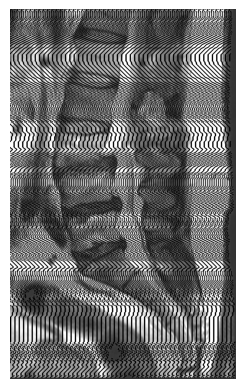

Image 6 processed. Detected 43620 non-black pixels.
Processing Image 7...


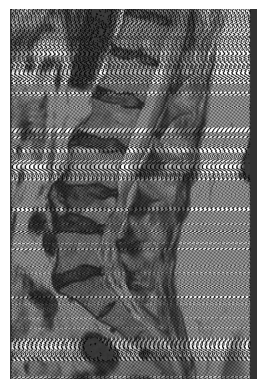

Image 7 processed. Detected 46830 non-black pixels.
Processing Image 8...


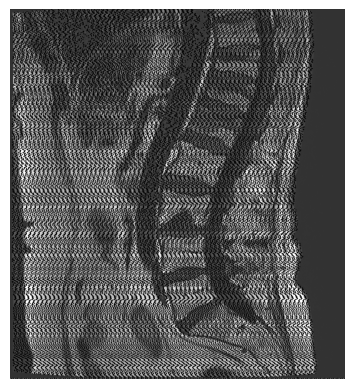

Image 8 processed. Detected 56059 non-black pixels.
Processing Image 9...


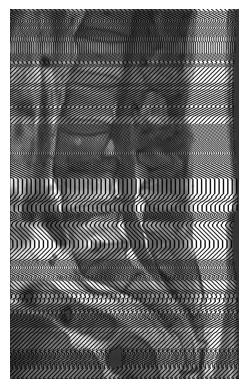

Image 9 processed. Detected 43673 non-black pixels.
Processing Image 10...


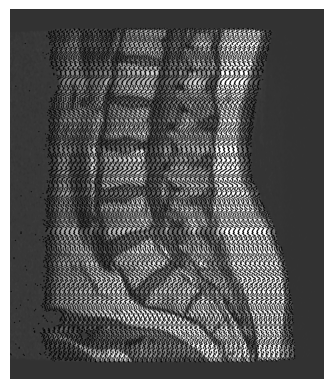

Image 10 processed. Detected 33698 non-black pixels.


In [168]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Noktaları işaretlemek için çizim fonksiyonu
def Drawing(img, EdgePoints, circle_radius=10):
    """
    Görüntü üzerinde verilen koordinatlarda daireler çizer ve görüntüyü gösterir.

    Args:
        img (numpy.ndarray): Gri tonlamalı görüntü.
        EdgePoints (list): Çizilecek noktaların koordinatları.
        circle_radius (int): Dairelerin yarıçapı.
    """
    # Görüntü kopyası oluştur
    img_copy = img.copy()
    for point in EdgePoints:
        cv2.circle(img_copy, tuple(point[::-1]), circle_radius, (0, 0, 255), -1)  # Kırmızı daire
    plt.imshow(img_copy, cmap='gray')
    plt.axis('off')
    plt.show()

# Siyah olmayan pikselleri alma fonksiyonu
def GetNonBlackPixels(img, sparsity_factor=1, draw=False, circle_radius=10):
    """
    Görüntüdeki siyah olmayan pikselleri tespit eder.

    Args:
        img (numpy.ndarray): Giriş görüntüsü.
        sparsity_factor (int): Seyrekleştirme faktörü (1 tüm pikselleri alır).
        draw (bool): Görselleştirme seçeneği.
        circle_radius (int): Görselleştirmede kullanılan daire yarıçapı.

    Returns:
        numpy.ndarray: Siyah olmayan piksellerin koordinatları.
    """
    height, width = img.shape

    # Görüntüyü üst ve alt yarıya ayır
    top_half = img[:height // 2, :]
    bottom_half = img[height // 2:, :]

    # Üst yarıda eşikleme
    y_top, x_top = np.where(top_half > 60)
    pixels_top = np.vstack((y_top, x_top)).T

    # Alt yarıda eşikleme
    y_bottom, x_bottom = np.where(bottom_half > 60)
    y_bottom += height // 2
    pixels_bottom = np.vstack((y_bottom, x_bottom)).T

    # Üst ve alt pikselleri birleştir
    pixels = np.vstack((pixels_top, pixels_bottom))

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        pixels = pixels[::sparsity_factor]

    # Çizim yapmak istenirse
    if draw:
        Drawing(img, EdgePoints=pixels, circle_radius=circle_radius)

    return pixels

# İşlenmiş her bir görüntü için siyah olmayan pikselleri al ve çiz
for i, img in enumerate(brightened_images, start=6):
    """
    İşlenmiş her bir görüntü için siyah olmayan pikselleri tespit eder ve görselleştirir.

    Args:
        i (int): Görüntünün sıralı numarası.
        img (numpy.ndarray): İşlenmiş görüntü.
    """
    print(f"Processing Image {i}...")
    test_img_Points = GetNonBlackPixels(
        img=img,
        sparsity_factor=10,
        circle_radius=1,
        draw=True
    )
    print(f"Image {i} processed. Detected {len(test_img_Points)} non-black pixels.")


# Kod Özeti

Bu kod, her bir işlenmiş görüntü için siyah olmayan pikselleri tespit eder, bu piksellerin %20'sini rastgele seçer ve bu noktalar etrafında patch'ler çıkarır. Çıkarılan patch'ler, her görüntü için bir sözlükte saklanır ve her bir görüntüdeki toplam patch sayısı konsola yazdırılır.
---
### Adımlar:

1. **Siyah Olmayan Pikselleri Bulma (`GetNonBlackPixels`)**:
   - Her görüntüdeki siyah olmayan piksellerin koordinatları tespit edilir.
   - Bu pikseller, `sparsity_factor` ile seyrekleştirilir (görüntüde daha az nokta almak için).

2. **Rastgele Seçim (`np.random.choice`)**:
   - Siyah olmayan piksellerin %20'si rastgele seçilir.
   - Seçilen piksellerin sayısı, toplam piksellerin %20'si olarak belirlenir.

3. **Patch Çıkartma (`GetPatchsFromNonBlackPixels`)**:
   - Seçilen siyah olmayan pikseller etrafında belirli bir boyutta patch'ler çıkarılır.
   - Patch'ler ve ilgili koordinatlar, her bir görüntü için bir sözlükte saklanır.

4. **Patch'lerin Sayısını Yazdırma**:
   - Her bir görüntüde çıkarılan patch sayısı konsola yazdırılır.

In [175]:
import numpy as np

# Patch alma işlemi
patches_dict = {}  # Her bir görüntü için patch'leri saklayacak sözlük

# Görüntülerin listesi
sharpened_images = brightened_images  # İşlenmiş görüntüler
image_names = ['test_sharpened_image6', 'test_sharpened_image7', 'test_sharpened_image8', 'test_sharpened_image9', 'test_sharpened_image10']

for img, img_name in zip(sharpened_images, image_names):
    # Siyah olmayan pikselleri al
    non_black_pixels = GetNonBlackPixels(img, sparsity_factor=5, circle_radius=1, draw=False)

    # Siyah olmayan piksellerin %20'sini rastgele seç
    selected_pixel_count = int(len(non_black_pixels) * 0.20)
    random_indices = np.random.choice(len(non_black_pixels), selected_pixel_count, replace=False)
    reduced_pixels = non_black_pixels[random_indices]

    # Patch'leri al
    patches, patch_info = GetPatchsFromNonBlackPixels(img, reduced_pixels, PatchSize=10, draw=False)

    # Patch'leri sözlüğe kaydet
    patches_dict[img_name] = {
        'patches': patches,
        'patch_info': patch_info
    }

# Patch sayılarını yazdır
for img_name, patch_data in patches_dict.items():
    print(f"{img_name} için toplam patch sayısı: {len(patch_data['patches'])}")


test_sharpened_image6 için toplam patch sayısı: 16805
test_sharpened_image7 için toplam patch sayısı: 18464
test_sharpened_image8 için toplam patch sayısı: 25265
test_sharpened_image9 için toplam patch sayısı: 16743
test_sharpened_image10 için toplam patch sayısı: 19941


# Kod Özeti

Bu kod, her bir işlenmiş görüntüden siyah olmayan pikselleri tespit eder, bu piksellerin etrafında patch'ler çıkarır ve bu patch'lerden HOG (Histogram of Oriented Gradients) özelliklerini hesaplayarak kaydeder.

---

### Adımlar:

1. **Siyah Olmayan Pikselleri Tespit Etme (`GetNonBlackPixels`)**:
   - Görüntüdeki siyah olmayan piksellerin koordinatları tespit edilir.
   - `sparsity_factor` ile pikseller seyrekleştirilir.

2. **Patch Çıkartma (`GetPatchsFromNonBlackPixels`)**:
   - Siyah olmayan piksellerin etrafında belirli bir boyutta patch'ler çıkarılır.

3. **HOG Özelliklerini Hesaplama (`hog` fonksiyonu)**:
   - Her patch için HOG özellikleri hesaplanır. Bu işlem, her patch'i analiz ederek yönsel özellikleri çıkarır.

4. **HOG Özelliklerini Kaydetme (`save_hog_features_with_coords`)**:
   - Hesaplanan HOG özellikleri ve patch'lerin koordinat bilgileri, sıkıştırılmış `.npz` dosyasına kaydedilir.

In [177]:
from skimage.feature import hog
import numpy as np
import os

# HOG özelliklerini çıkaran ve kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_file):
    """
    Patch'lerden HOG özelliklerini çıkarır ve sıkıştırılmış dosya formatında kaydeder.
    """
    hog_features = []  # HOG özelliklerini saklamak için liste
    coords = []  # Patch koordinatlarını saklamak için liste

    for patch, info in zip(patches, patch_info):
        # HOG özelliklerini çıkar
        fd = hog(
            patch,
            orientations=9,
            pixels_per_cell=(8, 8),
            cells_per_block=(2, 2),
            visualize=False  # Görselleştirme devre dışı
        )
        hog_features.append(fd)  # Özellikleri listeye ekle
        coords.append(info)  # Koordinat bilgilerini listeye ekle

    # Özellikleri ve koordinatları sıkıştırılmış dosyaya kaydet
    np.savez_compressed(output_file, hog_features=hog_features, coords=coords)
    print(f"HOG özellikleri başarıyla kaydedildi: {output_file}")


# İşlenecek görüntülerin isimleri ve çıktı dizini
sharpened_images = brightened_images  # İşlenmiş görüntülerin listesi
image_names = ['test_image6', 'test_image7', 'test_image8', 'test_image9', 'test_image10']
output_directory = r"./DB/output/hog_features"

# Çıkış dizinini oluştur
os.makedirs(output_directory, exist_ok=True)

# Her bir görüntü için patch'leri al ve HOG özelliklerini kaydet
for img, img_name in zip(sharpened_images, image_names):
    print(f"Görüntü işleniyor: {img_name}...")

    # 1. Siyah olmayan pikselleri al
    non_black_pixels = GetNonBlackPixels(
        img,
        sparsity_factor=10,
        circle_radius=1,
        draw=False
    )

    # 2. Patch'leri al
    patches, patch_info = GetPatchsFromNonBlackPixels(
        img,
        non_black_pixels,
        PatchSize=10,
        draw=False
    )

    # 3. HOG özelliklerini kaydet
    output_file = os.path.join(output_directory, f"{img_name}_hog_features_with_coords.npz")
    save_hog_features_with_coords(patches, patch_info, output_file)

    # İşlem tamamlandığında bilgilendirme
    print(f"Görüntü tamamlandı: {img_name}, Toplam Patch: {len(patches)}")


Görüntü işleniyor: test_image6...
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features\test_image6_hog_features_with_coords.npz
Görüntü tamamlandı: test_image6, Toplam Patch: 42051
Görüntü işleniyor: test_image7...
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features\test_image7_hog_features_with_coords.npz
Görüntü tamamlandı: test_image7, Toplam Patch: 46148
Görüntü işleniyor: test_image8...
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features\test_image8_hog_features_with_coords.npz
Görüntü tamamlandı: test_image8, Toplam Patch: 62959
Görüntü işleniyor: test_image9...
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features\test_image9_hog_features_with_coords.npz
Görüntü tamamlandı: test_image9, Toplam Patch: 41782
Görüntü işleniyor: test_image10...
HOG özellikleri başarıyla kaydedildi: ./DB/output/hog_features\test_image10_hog_features_with_coords.npz
Görüntü tamamlandı: test_image10, Toplam Patch: 49909


# Kod Özeti

Bu kod, görüntüler üzerinde çapraz korelasyon hesaplamak için kullanılır. Test görüntülerinin HOG (Histogram of Oriented Gradients) özellikleriyle HDD'deki (hard disk) referans HOG özelliklerini karşılaştırır ve yüksek korelasyonlu eşleşmeleri işaretler.

---

### Adımlar:

1. **Çapraz Korelasyon Fonksiyonu (`compute_cross_correlation_optimized`)**:
   - İki vektör kümesi arasındaki korelasyonu hesaplar. Korelasyon mesafesi kullanılarak, benzer özelliklere sahip bölgeler tespit edilir.

2. **HOG Özelliklerini Yükleme**:
   - Test görüntüleri için HOG özellik dosyaları (`hog_features_with_coords.npz`) yüklenir ve test görüntülerinin HOG vektörleri ile referans HOG vektörleri karşılaştırılır.

3. **Çapraz Korelasyon Hesaplama**:
   - Test görüntüsünün HOG özellikleri ile referans HOG özellikleri arasındaki çapraz korelasyon hesaplanır.
   - Belirli bir eşiğin (`threshold=0.30`) üzerindeki korelasyonları yüksek kabul edilir.

4. **Yüksek Korelasyonlu Eşleşmelerin İşaretlenmesi**:
   - Korelasyonu yüksek olan bölgeler işaretlenir ve bu bölgelerdeki koordinatlar çıktı görüntüsünde beyaz dairelerle işaretlenir.

5. **Çıktı Görselleştirme**:
   - Orijinal görüntü, etiketli görüntü ve eşleşen bölgelerle işaretlenmiş çıktı görüntüsü yan yana gösterilir.

İşleniyor: ./DB/images/img (6).png...
İşleniyor: ./DB/images/img (7).png...
İşleniyor: ./DB/images/img (8).png...
İşleniyor: ./DB/images/img (9).png...
İşleniyor: ./DB/images/img (10).png...


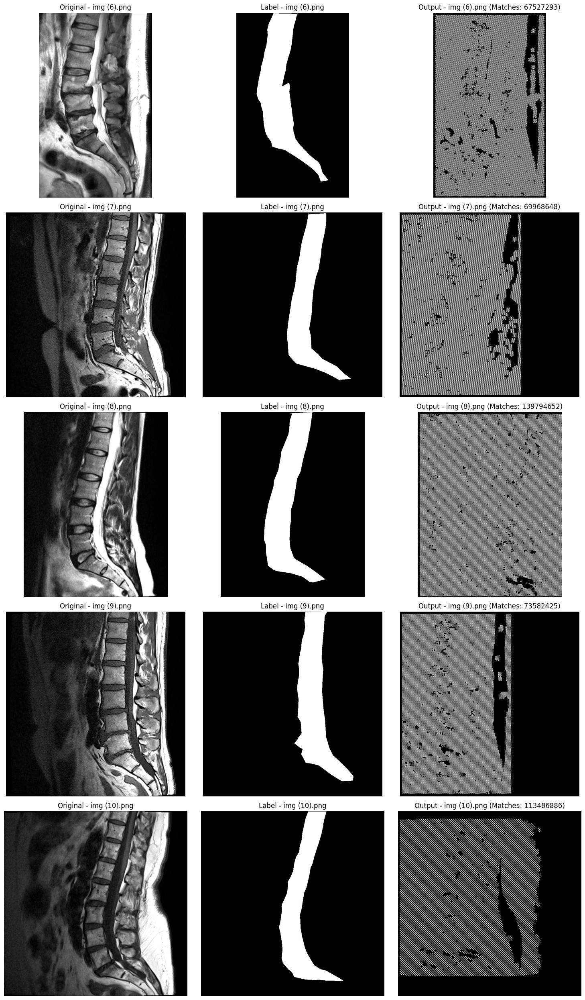

In [178]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    return 1 - cdist(vectors1, vectors2, metric='correlation')

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_vectors = np.load(r"./DB/output/hog_features_with_coords.npz")['features']

# İşlenecek test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"./DB/images/img (6).png",
    r"./DB/images/img (7).png",
    r"./DB/images/img (8).png",
    r"./DB/images/img (9).png",
    r"./DB/images/img (10).png"
]

label_image_paths = [
    r"./DB/labels/label (6).png",
    r"./DB/labels/label (7).png",
    r"./DB/labels/label (8).png",
    r"./DB/labels/label (9).png",
    r"./DB/labels/label (10).png"
]

hog_files = [
    r"./DB/output/hog_features/test_image6_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image7_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image8_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image9_hog_features_with_coords.npz",
    r"./DB/output/hog_features/test_image10_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    print(f"İşleniyor: {test_image_path}...")
    
    # HOG vektörlerini ve koordinatlarını yükle
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['hog_features']
    test_coords = hog_data['coords']

    # Test görüntüsünü ve etiket görüntüsünü yükle
    test_image = cv2.imread(test_image_path)
    label_image = cv2.imread(label_image_path)

    if test_image is None or label_image is None:
        print(f"Görüntü veya etiket yüklenemedi: {test_image_path}, {label_image_path}. Atlanıyor...")
        continue

    # Çıkış görüntüsü
    output_img = np.zeros_like(test_image)

    # Çapraz korelasyonu hesapla
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyonlu eşleşmeleri işaretle
    matching_coords_count = 0
    for test_idx, _ in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 1, (255, 255, 255), -1)
        matching_coords_count += 1

    # Görüntü adı
    image_name = os.path.basename(test_image_path)

    # Orijinal görüntü
    plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original - {image_name}")
    plt.axis('off')

    # Etiket görüntüsü
    plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
    plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Label - {image_name}")
    plt.axis('off')

    # Çıktı görüntüsü
    plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Output - {image_name} (Matches: {matching_coords_count})")
    plt.axis('off')

plt.tight_layout()
plt.show()


# Kod Özeti

Bu kod, test görüntüleri ile etiketli görüntüler arasındaki Intersection over Union (IoU) değerlerini hesaplamak için kullanılır. IoU, iki küme arasındaki benzerliği ölçen yaygın bir metriktir ve bu kodda, HOG (Histogram of Oriented Gradients) özelliklerini kullanan bir eşleşme işlemi yapılmaktadır. Sonuçta, her test görüntüsü için IoU hesaplanır ve görsel olarak bir grafikle gösterilir.

---

### Adımlar:

1. **IoU Hesaplama (`calculate_iou`)**:
   - İki görüntü arasındaki Intersection over Union (IoU) değeri hesaplanır. İki görüntü de ikili (binary) hale getirilir, ardından kesişim ve birleşim hesaplanarak IoU değeri elde edilir.
   - Eğer birleşim sıfırsa, IoU değeri sıfır olarak kabul edilir.

2. **Çapraz Korelasyon Hesaplama (`compute_cross_correlation_optimized`)**:
   - Test görüntüsündeki HOG özellikleri ile referans HOG özellikleri arasındaki çapraz korelasyon hesaplanır.
   - Korelasyonu yüksek olan eşleşmeler belirli bir eşiğe göre seçilir ve bu eşleşmelerin koordinatları çıkartılır.

3. **Eşleşen Bölgelerin İşaretlenmesi**:
   - Yüksek korelasyonlu eşleşmelerin bulunduğu bölgeler, beyaz dairelerle işaretlenir.

4. **IoU Hesaplama ve Grafik Çıktısı**:
   - Çıkış görüntüsündeki işaretlenmiş bölgelerle etiketli görüntü arasındaki IoU değeri hesaplanır.
   - IoU değerleri bir listeye kaydedilir ve her test görüntüsü için IoU değeri yazdırılır.
   - Ortalama IoU değeri hesaplanır ve bir grafikle görselleştirilir.

İşleniyor: ./DB/images/img (6).png...
Test Image 6: IoU = 0.1995
İşleniyor: ./DB/images/img (7).png...
Test Image 7: IoU = 0.1354
İşleniyor: ./DB/images/img (8).png...
Test Image 8: IoU = 0.1544
İşleniyor: ./DB/images/img (9).png...
Test Image 9: IoU = 0.0848
İşleniyor: ./DB/images/img (10).png...
Test Image 10: IoU = 0.1518

Ortalama IoU: 0.1452


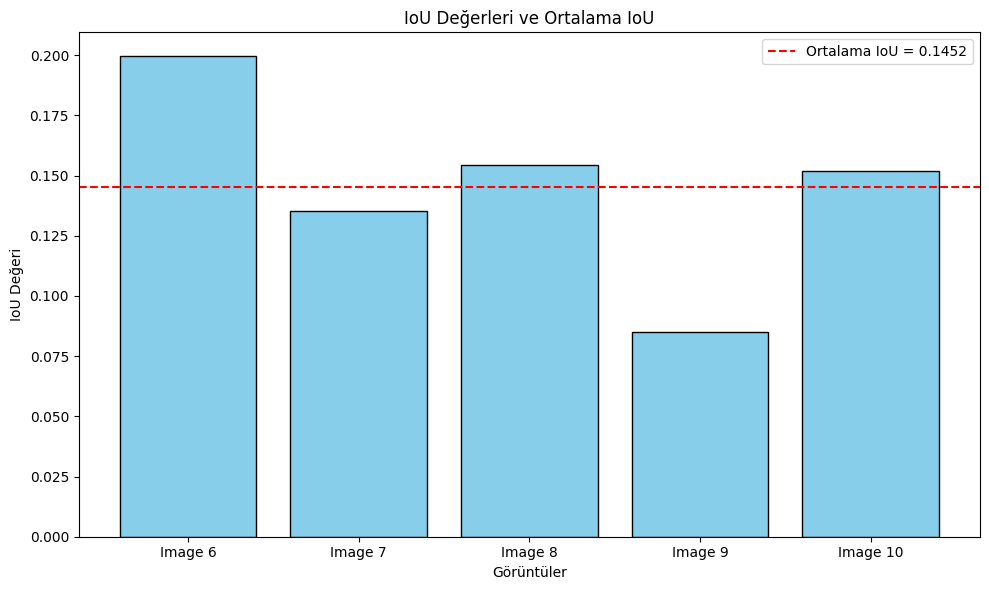

In [179]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    """
    İki görüntü arasında Intersection over Union (IoU) hesaplar.

    Args:
        predicted_image (numpy.ndarray): Tahmin edilen görüntü.
        label_image (numpy.ndarray): Etiketlenmiş gerçek görüntü.

    Returns:
        float: Hesaplanan IoU değeri.
    """
    _, pred_binary = cv2.threshold(cv2.cvtColor(predicted_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(cv2.cvtColor(label_image, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY)

    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()

    return intersection / union if union != 0 else 0

# IoU hesaplama ve çıktı
ious = []
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    print(f"İşleniyor: {test_image_path}...")

    # Çıkış görüntüsü oluştur
    output_img = np.zeros_like(cv2.imread(test_image_path))

    # HOG vektörlerini yükle
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['hog_features']
    test_coords = hog_data['coords']

    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyonlu eşleşmeleri işaretle
    for test_idx, _ in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)

    # Etiket görüntüsünü yükle
    label_image = cv2.imread(label_image_path)

    # IoU hesapla
    iou = calculate_iou(output_img, label_image)
    ious.append(iou)
    print(f"Test Image {idx + 6}: IoU = {iou:.4f}")

# Ortalama IoU hesaplama
mean_iou = np.mean(ious)
print(f"\nOrtalama IoU: {mean_iou:.4f}")

# IoU Grafik Çıktısı
image_names = [f"Image {i + 6}" for i in range(len(ious))]
plt.figure(figsize=(10, 6))
plt.bar(image_names, ious, color='skyblue', edgecolor='black')
plt.axhline(mean_iou, color='red', linestyle='--', label=f'Ortalama IoU = {mean_iou:.4f}')
plt.xlabel('Görüntüler')
plt.ylabel('IoU Değeri')
plt.title('IoU Değerleri ve Ortalama IoU')
plt.legend()
plt.tight_layout()
plt.show()
